## This code is used to generate all the outputs related to Tan2021 data.

In [1]:
library(data.table)
library(readxl)
library(dplyr)
# library(BandNorm)
library(ggplot2)
library(viridis)
library(ggpubr)
library(SeuratObject)
library(data.table)
library(Seurat)
library(pheatmap)
library(magrittr)
library(tidyr)
library(ggrepel)
library(umap)
library(Rtsne)

summary = read_excel("/p/keles/schic/volumeB/Tan2021/supplementary/1-s2.0-S0092867420317542-mmc4.xlsx")
summary$cell = paste(summary$cell, ".contacts", sep = "")
summary = summary[!is.na(summary$`20kb RMS RMSD`), ]
paths = paste("/p/keles/schic/volumeB/Tan2021/raw/", summary$cell, ".hic", sep = "")
names = paste(summary$cell, ".hic", sep = "")


Attaching package: ‘dplyr’


The following objects are masked from ‘package:data.table’:

    between, first, last


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: viridisLite


Attaching package: ‘tidyr’


The following object is masked from ‘package:magrittr’:

    extract




In [26]:
load("/p/keles/schic/volumeB/Tan2021/rdata_01272022/all_objects_v2.RData")
load("/p/keles/schic/volumeB/Tan2021/control_100kb_embedding.RData")
load(file = "/p/keles/schic/volumeB/Tan2021/control_100kb_resUMAP_resTSNE.RData")
load("/p/keles/schic/volumeB/Tan2021/Tan2021_results.RData")
load("/p/keles/schic/volumeB/Tan2021/rdata_01272022/detected_markergenes_control.RData")

#save(RNA_SeuratObj_sub, RNA_SeuratObj, file = "/p/keles/schic/volumeB/Tan2021/RNA_SeuratObj.RData")
load(file = "/p/keles/schic/volumeB/Tan2021/RNA_SeuratObj.RData")
load(file = "/p/keles/schic/volumeB/Tan2021/rdata_01272022/detected_markergenes_control_all_top10_sig.RData")
load("/p/keles/schic/volumeB/Tan2021/rdata_01272022/heatmap_objs.RData")
load("/p/keles/schic/volumeB/Tan2021/rdata_01272022/neonatal_heatmap_objs.RData")

In [3]:
summary %>% head

cell,tissue,treatment,age,sex,father,mother,restriction enzyme,cell-type cluster,reads,read length (bp),raw throughput (Gb),raw contacts,raw intra (%),dup rate (%),contacts,intra (%),phased legs (%),raw contacts per read (%),20kb RMS RMSD
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dttm>
cortex-p001-cb_001.contacts,cortex,control,P1,female,C57BL/6J,CAST/EiJ,MboI,Neonatal Astrocyte,13675687,150,4.102706,1703101,70.8022,70.42,503696,68.1457,47.0422,12.453495,1899-12-31 11:54:40
cortex-p001-cb_002.contacts,cortex,control,P1,female,C57BL/6J,CAST/EiJ,MboI,Neonatal Neuron 1,10057130,150,3.017139,1202070,76.5257,68.58,377718,73.6338,47.0264,11.952416,1900-01-10 01:41:08
cortex-p001-cb_003.contacts,cortex,control,P1,female,C57BL/6J,CAST/EiJ,MboI,Neonatal Neuron 2,12673668,150,3.802100,1163722,84.1804,68.61,365317,80.1731,46.4664,9.182204,1900-01-11 08:30:33
cortex-p001-cb_004.contacts,cortex,control,P1,female,C57BL/6J,CAST/EiJ,MboI,Unknown,12936354,150,3.880906,1289148,84.6188,69.21,396869,81.0222,46.4764,9.965312,1900-01-14 06:32:26
cortex-p001-cb_005.contacts,cortex,control,P1,female,C57BL/6J,CAST/EiJ,MboI,Neonatal Neuron 2,14086574,150,4.225972,1510084,76.9289,71.23,434395,73.3952,46.8567,10.720023,1899-12-31 23:19:49
cortex-p001-cb_006.contacts,cortex,control,P1,female,C57BL/6J,CAST/EiJ,MboI,Oligodendrocyte Progenitor,13246199,150,3.973860,1342289,71.9177,69.48,409612,68.7546,46.2013,10.133390,1900-01-10 12:25:33


In [4]:
options(repr.plot.width=15, repr.plot.height=10)

In [5]:
# resUMAP = umap(eb)$layout
# resTSNE = Rtsne(eb)$Y
# save(resUMAP, resTSNE, file = "/p/keles/schic/volumeB/Tan2021/control_100kb_resUMAP_resTSNE.RData")
# load(file = "/p/keles/schic/volumeB/Tan2021/control_100kb_resUMAP_resTSNE.RData")

In [6]:
cell_info = summary #summary[, c("cell", "cell-type cluster")]
cell_info$cell = paste(cell_info$cell, ".txt", sep = "")

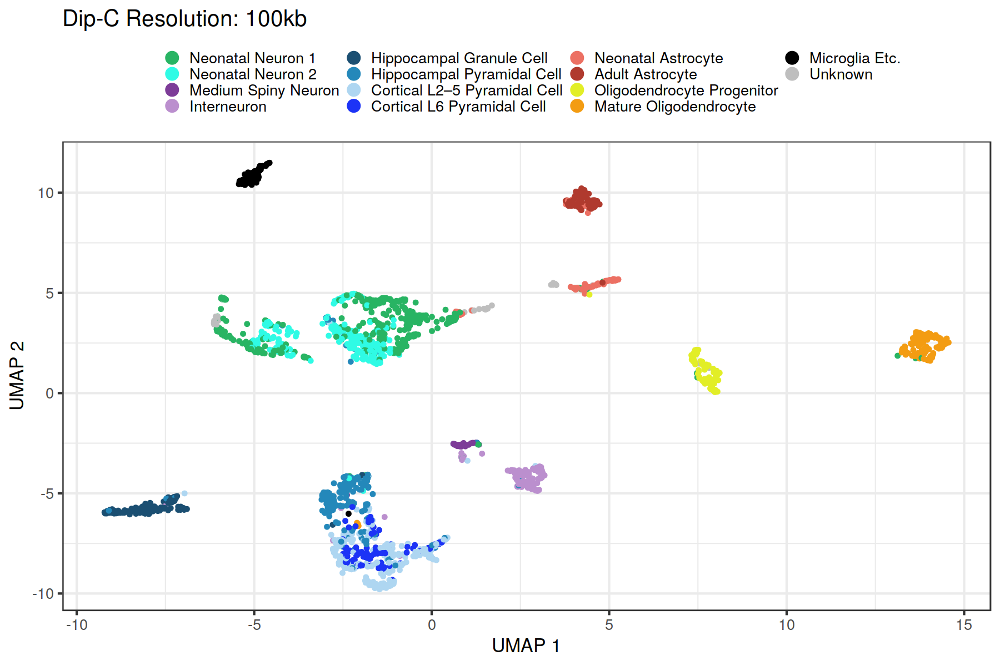

In [7]:
umapD = cbind(resUMAP, cell_info[, "cell-type cluster"])
colnames(umapD) = c("X1", "X2", "celltype")

dipCumap = umapD %>% ggplot(aes(x = X1, y = X2, color = celltype)) +
geom_point(size = 2) +
theme_bw(base_size = 20) +
xlab("UMAP 1") +
ylab("UMAP 2") +
ggtitle("Dip-C Resolution: 100kb") +
scale_color_manual(breaks = c("Neonatal Neuron 1", "Neonatal Neuron 2", 
                              "Medium Spiny Neuron", "Interneuron",
                              "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                             "Cortical L2–5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                              "Neonatal Astrocyte", "Adult Astrocyte",
                              "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                              "Microglia Etc.", "Unknown"), 
                   values = c("#28B463", "#2FFBE5", 
                              "#7D3C98", "#BB8FCE",
                              "#1B4F72", "#2488BA",
                              "#AED6F1", "#1C33F6", 
                              "#EC7063", "#B03A2E", 
                              "#E2EE27", "#F39C12", 
                              "#000000", "grey")) +
theme(legend.position = "top") +
ggpubr::rremove("legend.title") +
guides(colour = guide_legend(nrow = 4, override.aes = list(size = 6)))

saveRDS(dipCumap, file = "/p/keles/schic/volumeB/Tan2021/RDS/dipCumap.rds")
dipCumap

png 
  2

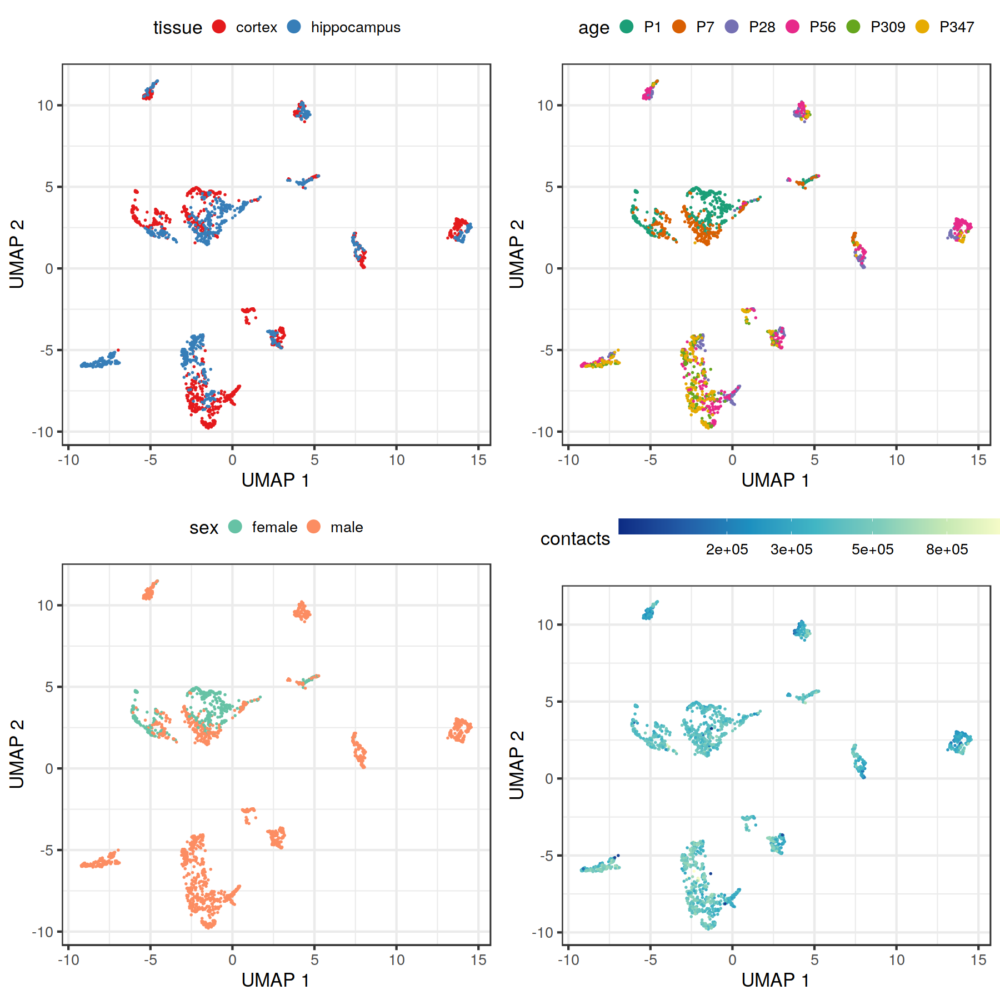

In [8]:
options(repr.plot.width=15, repr.plot.height=15)

umapD = cbind(resUMAP, cell_info[, c("tissue", "age", "sex", "contacts", "cell-type cluster")])
colnames(umapD) = c("X1", "X2", "tissue", "age", "sex", "contacts", "cellType")
p1 = umapD %>% ggplot(aes(x = X1, y = X2, color = tissue)) +
geom_point(size = 0.5) +
theme_bw(base_size = 20) +
xlab("UMAP 1") +
ylab("UMAP 2") +
# ggtitle("Dip-C Resolution: 100kb") +
scale_color_brewer(palette = "Set1") +
theme(legend.position = "top") +
guides(colour = guide_legend(nrow = 1, override.aes = list(size = 6)))

umapD$age = factor(umapD$age, levels = c("P1", "P7", "P28", "P56", "P309", "P347"))
p2 = umapD %>% ggplot(aes(x = X1, y = X2, color = age)) +
geom_point(size = 0.5) +
theme_bw(base_size = 20) +
xlab("UMAP 1") +
ylab("UMAP 2") +
# ggtitle("Dip-C Resolution: 100kb") +
scale_color_brewer(palette = "Dark2") +
theme(legend.position = "top") +
guides(colour = guide_legend(nrow = 1, override.aes = list(size = 6)))

p3 = umapD %>% ggplot(aes(x = X1, y = X2, color = sex)) +
geom_point(size = 0.5) +
theme_bw(base_size = 20) +
xlab("UMAP 1") +
ylab("UMAP 2") +
# ggtitle("Dip-C Resolution: 100kb") +
scale_color_brewer(palette = "Set2") +
theme(legend.position = "top") +
guides(colour = guide_legend(nrow = 1, override.aes = list(size = 6)))

p4 = umapD %>% ggplot(aes(x = X1, y = X2, color = contacts)) +
geom_point(size = 0.5) +
theme_bw(base_size = 20) +
xlab("UMAP 1") +
ylab("UMAP 2") +
# ggtitle("Dip-C Resolution: 100kb") +
scale_color_distiller(palette = "YlGnBu", trans = "log", breaks = c(100000, 200000, 300000, 500000, 800000)) +
theme(legend.position = "top", legend.key.width = unit(3, "cm"))

pdf("/p/keles/schic/volumeA/Figures/DipC_featureUMAP.pdf", width = 18, height = 18)
ggarrange(p1, p2, p3, p4, ncol = 2, nrow = 2)
dev.off()

ggarrange(p1, p2, p3, p4, ncol = 2, nrow = 2)


In [9]:
# load("/p/keles/schic/volumeB/Tan2021/Tan2021_results.RData")
cellTypeList = c("Neonatal Neuron 1", "Neonatal Neuron 2", 
                 "Medium Spiny Neuron", "Interneuron",
                 "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                 "Cortical L2–5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                 "Neonatal Astrocyte", "Adult Astrocyte",
                 "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                 "Microglia Etc.") #, "Unknown"

cellTypeNameList = gsub(" ", "_", cellTypeList)
#cellTypeNameList[7] = names(gene_lists)[2]

cellTypeNameList
gene_lists[[cellTypeNameList[1]]]
gene_lists[[cellTypeNameList[2]]]

[1] "Neonatal_Neuron_1"            "Neonatal_Neuron_2"           
 [3] "Medium_Spiny_Neuron"          "Interneuron"                 
 [5] "Hippocampal_Granule_Cell"     "Hippocampal_Pyramidal_Cell"  
 [7] "Cortical_L2–5_Pyramidal_Cell" "Cortical_L6_Pyramidal_Cell"  
 [9] "Neonatal_Astrocyte"           "Adult_Astrocyte"             
[11] "Oligodendrocyte_Progenitor"   "Mature_Oligodendrocyte"      
[13] "Microglia_Etc."

[1] "Dpysl3"   "Chl1"     "Akap9"    "Ncam1"    "Mapt"     "Ankrd12" 
 [7] "Srgap1"   "Tmem131l" "Ptprz1"   "Neo1"     "Plppr1"   "Frmd4a"  
[13] "Dner"     "Runx1t1"  "Pbx1"     "Nckap5"   "Zfp462"   "Tiam2"   
[19] "Fbn2"     "Nfib"     "Ptprk"    "Nrp1"

[1] "Dpysl3"   "Chl1"     "Akap9"    "Ncam1"    "Mapt"     "Ankrd12" 
 [7] "Srgap1"   "Tmem131l" "Ptprz1"   "Neo1"     "Plppr1"   "Frmd4a"  
[13] "Dner"     "Runx1t1"  "Pbx1"     "Nckap5"   "Zfp462"   "Tiam2"   
[19] "Fbn2"     "Nfib"     "Ptprk"    "Nrp1"

In [11]:
#Preparing for hic result
library(BandNorm)
load("/p/keles/schic/volumeB/Tan2021/rdata_01272022/detected_markergenes_control.RData")

paths = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control_promoter/", full.names = TRUE)
names = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control_promoter/")
temp = fread(paths[1])
GAD_reg = matrix(0, nrow = nrow(temp), ncol = length(paths))
for (k in 1:length(names)){
    cell = fread(paths[k])
    GAD_reg[, k] = cell$V2
}
GAD_reg = GAD_reg[!duplicated(temp$V1), ]
temp = temp[!duplicated(temp$V1), ]
rownames(GAD_reg) = temp$V1
colnames(GAD_reg) = names
all_cell_norm = t(t(GAD_reg) / colSums(GAD_reg)) * 1e04
all = (all_cell_norm - rowMeans(all_cell_norm))/sqrt(rowVars(all_cell_norm))
all = t(all)
# all[all < 1.2] = NA

GADgeneAll = all

Loading required package: progress

Loading required package: harmony

Loading required package: Rcpp

Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


Loading required package: gmodels

Loading required package: doParallel

Loading required package: foreach

Loading required package: iterators

Loading required package: parallel

Loading required package: matrixStats


Attaching package: ‘matrixStats’


The following object is masked from ‘package:dplyr’:

    count


Loading required package: strawr

Loading required package: rmarkdown

Loading required package: sparsesvd


Attaching package: ‘BandNorm’


The following object is masked _by_ ‘.GlobalEnv’:

    summary




In [12]:
head(all)

,Xkr4,Rp1,Rgs20,St18,Sntg1,Sgk3,Cpa6,Prex2,A830018L16Rik,Sulf1,⋯,Scml2,Nhs,Reps2,Ctps2,Pir,Glra2,Gpm6b,Frmpd4,Arhgap6,Mid1
cortex-p001-cb_001.contacts.txt,-0.5414695,-1.11491679,0.3220490,0.3102654,-0.07966891,1.88209816,-2.1049834,-1.0071221,0.04454271,0.9503470,⋯,-0.79544032,0.36724620,-0.1326856,0.01847235,0.4254213,1.4633046,-0.3668839,2.50303984,0.76221819,2.66611191
cortex-p001-cb_002.contacts.txt,1.3524113,0.02951003,-0.2262577,-0.2239844,-0.01773062,-0.07925753,0.7379892,0.6701532,-0.15767358,-0.1173866,⋯,0.06020228,0.49284977,0.7246880,-0.42774517,0.4034567,0.9666855,-0.3247972,0.40952115,1.25035100,1.15166060
cortex-p001-cb_003.contacts.txt,-1.2420791,-0.67257168,0.3321985,-1.3795214,-1.43386632,-0.56349807,-2.4379895,-1.4903506,-1.44185298,-0.9221210,⋯,-1.10092654,0.91012405,-0.1721396,1.28233544,3.5782409,2.0815497,1.1586394,2.87468710,2.22940028,1.07368171
cortex-p001-cb_004.contacts.txt,0.4536357,3.65051156,-0.3295710,1.4721676,0.05399610,-1.55243744,-1.1162349,-0.3067896,-1.71303876,-0.7124576,⋯,-0.01259436,0.35305203,-0.2884078,0.03240234,0.1539553,-1.4289014,-1.4770681,0.59431350,0.83640354,0.03970742
cortex-p001-cb_005.contacts.txt,-0.5291923,-1.20852865,-0.8835900,-0.6833662,-1.68224725,-1.30591481,-1.5586727,-1.6388909,-1.53095952,0.7124885,⋯,-1.10092654,0.77586070,-0.4887627,0.26593530,0.7294142,0.8811306,0.8059588,-0.07498591,0.03403198,0.12237249
cortex-p001-cb_006.contacts.txt,-1.3000244,-0.68316387,0.8334316,-1.4449394,-1.49378243,3.52974270,-0.8708083,-1.2414202,-2.15287351,0.4835774,⋯,-0.59444611,-0.08427907,0.4201910,1.76957225,2.9612203,1.3846183,3.6595836,0.07748198,1.37935747,1.27033476


In [13]:
gadD = c()
targetGeneList = gene_lists[[cellTypeNameList[1]]]

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
#     rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
#             cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType, age, sex, tissue, score = gene, type, targetGene)
    
#     rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}

In [14]:
head(gadD)

,X1,X2,cellType,age,sex,tissue,score,type,targetGene
,<dbl>,<dbl>,<chr>,<fct>,<chr>,<chr>,<dbl>,<chr>,<chr>
cortex-p001-cb_001.contacts.txt,-6.105927,3.507053,Neonatal Astrocyte,P1,female,cortex,-0.51432673,GAD,Dpysl3
cortex-p001-cb_002.contacts.txt,-1.731268,3.609356,Neonatal Neuron 1,P1,female,cortex,-0.69363180,GAD,Dpysl3
cortex-p001-cb_003.contacts.txt,-2.466794,4.778958,Neonatal Neuron 2,P1,female,cortex,-1.28725693,GAD,Dpysl3
cortex-p001-cb_004.contacts.txt,1.470402,4.210963,Unknown,P1,female,cortex,0.03175305,GAD,Dpysl3
cortex-p001-cb_005.contacts.txt,-4.677435,3.375215,Neonatal Neuron 2,P1,female,cortex,-0.23034988,GAD,Dpysl3
cortex-p001-cb_006.contacts.txt,7.382427,1.961437,Oligodendrocyte Progenitor,P1,female,cortex,2.43353470,GAD,Dpysl3


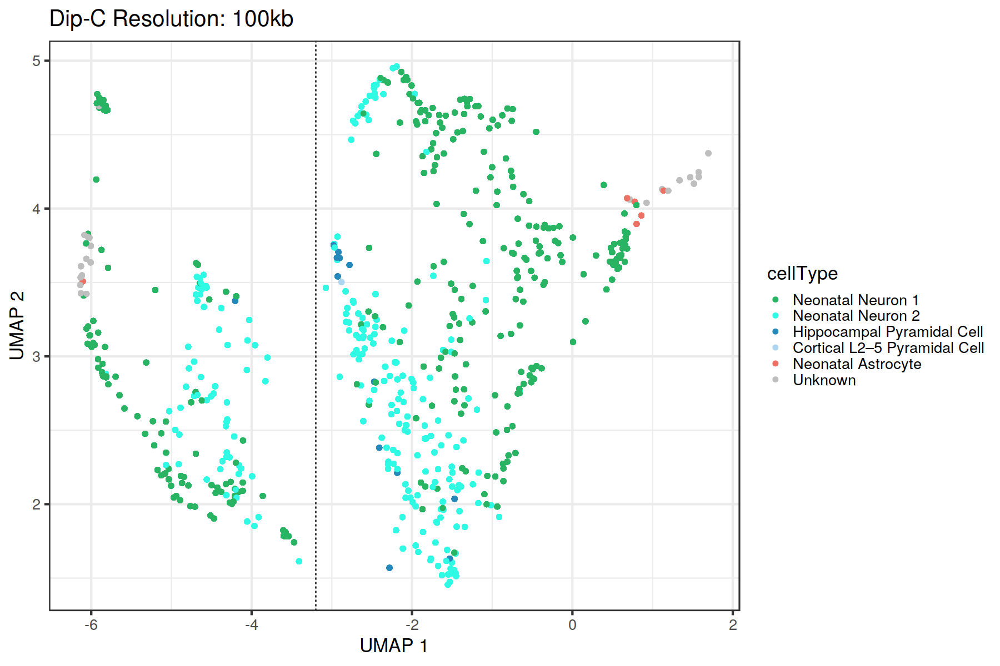

In [15]:
options(repr.plot.width=15, repr.plot.height=10)

neuronSub = gadD %>% filter(X1 >=-7.5, X1 <=2.5, X2 >= 0, X2 <= 5.2)


neuronSub %>% ggplot(aes(x = X1, y = X2, color = cellType)) +
geom_point(size = 2) +
geom_vline(xintercept = -3.2, linetype = "dashed") +
theme_bw(base_size = 20) +
xlab("UMAP 1") +
ylab("UMAP 2") +
ggtitle("Dip-C Resolution: 100kb") +
scale_color_manual(breaks = c("Neonatal Neuron 1", "Neonatal Neuron 2", 
                              "Medium Spiny Neuron", "Interneuron",
                              "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                             "Cortical L2–5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                              "Neonatal Astrocyte", "Adult Astrocyte",
                              "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                              "Microglia Etc.", "Unknown"), 
                   values = c("#28B463", "#2FFBE5", 
                              "#7D3C98", "#BB8FCE",
                              "#1B4F72", "#2488BA",
                              "#AED6F1", "#1C33F6", 
                              "#EC7063", "#B03A2E", 
                              "#E2EE27", "#F39C12", 
                              "#000000", "grey"))

In [16]:
head(neuronSub)

,X1,X2,cellType,age,sex,tissue,score,type,targetGene
,<dbl>,<dbl>,<chr>,<fct>,<chr>,<chr>,<dbl>,<chr>,<chr>
cortex-p001-cb_001.contacts.txt,-6.105927,3.507053,Neonatal Astrocyte,P1,female,cortex,-0.51432673,GAD,Dpysl3
cortex-p001-cb_002.contacts.txt,-1.731268,3.609356,Neonatal Neuron 1,P1,female,cortex,-0.69363180,GAD,Dpysl3
cortex-p001-cb_003.contacts.txt,-2.466794,4.778958,Neonatal Neuron 2,P1,female,cortex,-1.28725693,GAD,Dpysl3
cortex-p001-cb_004.contacts.txt,1.470402,4.210963,Unknown,P1,female,cortex,0.03175305,GAD,Dpysl3
cortex-p001-cb_005.contacts.txt,-4.677435,3.375215,Neonatal Neuron 2,P1,female,cortex,-0.23034988,GAD,Dpysl3
cortex-p001-cb_007.contacts.txt,-2.577532,4.723994,Neonatal Neuron 2,P1,female,cortex,-1.68920662,GAD,Dpysl3


In [17]:
neuronSub$newCellType = "Neonatal Neuron 1"
neuronSub$newCellType[neuronSub$X1 >=-3.2] = "Neonatal Neuron 2"
neuronSub %>% data.frame %>% group_by(newCellType) %>% summarize(N = n(), P1N = sum(age == "P1"), P7N = sum(age == "P7")) %>% mutate(P1perc = P1N/(P1N+P7N)*100, P7perc = P7N/(P1N+P7N)*100)
neuronSub %>% data.frame %>% group_by(newCellType) %>% summarize(N = n(), P1N = sum(sex == "female"), P7N = sum(sex == "male")) %>% mutate(Femaleperc = P1N/(P1N+P7N)*100, Maleperc = P7N/(P1N+P7N)*100)
neuronSub %>% data.frame %>% group_by(newCellType) %>% summarize(N = n(), P1N = sum(tissue == "cortex"), P7N = sum(tissue == "hippocampus")) %>%  
        mutate(cortexPer = P1N/(P1N+P7N)*100, hippocampusPer = P7N/(P1N+P7N)*100)


neuronSub %>% data.frame %>% filter(cellType %in% c("Neonatal Neuron 1", "Neonatal Neuron 2")) %>% group_by(cellType) %>% summarize(N = n(), P1N = sum(age == "P1"), P7N = sum(age == "P7")) %>% mutate(P1perc = P1N/(P1N+P7N)*100, P7perc = P7N/(P1N+P7N)*100)
neuronSub %>% data.frame %>% filter(cellType %in% c("Neonatal Neuron 1", "Neonatal Neuron 2")) %>% group_by(cellType) %>% summarize(N = n(), P1N = sum(sex == "female"), P7N = sum(sex == "male")) %>% mutate(Femaleperc = P1N/(P1N+P7N)*100, Maleperc = P7N/(P1N+P7N)*100)
neuronSub %>% data.frame %>% filter(cellType %in% c("Neonatal Neuron 1", "Neonatal Neuron 2")) %>% group_by(cellType) %>% summarize(N = n(), P1N = sum(tissue == "cortex"), P7N = sum(tissue == "hippocampus")) %>%  
        mutate(cortexPer = P1N/(P1N+P7N)*100, hippocampusPer = P7N/(P1N+P7N)*100)


gadD %>% filter(age %in% c("P1", "P7")) %>% summarize(N = n(), P1N = sum(age == "P1"), P7N = sum(age == "P7")) %>% mutate(P1perc = P1N/(P1N+P7N)*100, P7perc = P7N/(P1N+P7N)*100)

binom.test(2684, 2684+1408, 0.572238, alternative = "two.sided")
binom.test(5016, 5016+4026, 0.572238, alternative = "two.sided")

newCellType,N,P1N,P7N,P1perc,P7perc
<chr>,<int>,<int>,<int>,<dbl>,<dbl>
Neonatal Neuron 1,4092,2684,1408,65.59140,34.40860
Neonatal Neuron 2,9240,5016,4026,55.47445,44.52555


newCellType,N,P1N,P7N,Femaleperc,Maleperc
<chr>,<int>,<int>,<int>,<dbl>,<dbl>
Neonatal Neuron 1,4092,2684,1408,65.59140,34.40860
Neonatal Neuron 2,9240,5016,4224,54.28571,45.71429


newCellType,N,P1N,P7N,cortexPer,hippocampusPer
<chr>,<int>,<int>,<int>,<dbl>,<dbl>
Neonatal Neuron 1,4092,2728,1364,66.66667,33.33333
Neonatal Neuron 2,9240,3938,5302,42.61905,57.38095


cellType,N,P1N,P7N,P1perc,P7perc
<chr>,<int>,<int>,<int>,<dbl>,<dbl>
Neonatal Neuron 1,7238,5632,1518,78.76923,21.23077
Neonatal Neuron 2,5148,1606,3542,31.19658,68.80342


cellType,N,P1N,P7N,Femaleperc,Maleperc
<chr>,<int>,<int>,<int>,<dbl>,<dbl>
Neonatal Neuron 1,7238,5632,1606,77.81155,22.18845
Neonatal Neuron 2,5148,1606,3542,31.19658,68.80342


cellType,N,P1N,P7N,cortexPer,hippocampusPer
<chr>,<int>,<int>,<int>,<dbl>,<dbl>
Neonatal Neuron 1,7238,3080,4158,42.55319,57.44681
Neonatal Neuron 2,5148,2860,2288,55.55556,44.44444


N,P1N,P7N,P1perc,P7perc
<int>,<int>,<int>,<dbl>,<dbl>
15532,8888,6644,57.2238,42.7762



	Exact binomial test

data:  2684 and 2684 + 1408
number of successes = 2684, number of trials = 4092, p-value < 2.2e-16
alternative hypothesis: true probability of success is not equal to 0.572238
95 percent confidence interval:
 0.6411286 0.6704764
sample estimates:
probability of success 
              0.655914 



	Exact binomial test

data:  5016 and 5016 + 4026
number of successes = 5016, number of trials = 9042, p-value =
0.0008136
alternative hypothesis: true probability of success is not equal to 0.572238
95 percent confidence interval:
 0.5444290 0.5650247
sample estimates:
probability of success 
             0.5547445 


In [18]:
# We filter out genes in Tan2021 that are not protein-coding genes and not longer than 100kb,
# that's why the length of the list of genes for each cell type is smaller than 100.
library(readxl)
read_excels = function(filename, tibble = FALSE){
    sheets = excel_sheets(filename)
    x = lapply(sheets, function(X){read_excel(filename, sheet = X)})
    x
}
alls = read_excels("/p/keles/schic/volumeB/Tan2021/supplementary/1-s2.0-S0092867420317542-mmc1.xlsx")
names(alls) = excel_sheets("/p/keles/schic/volumeB/Tan2021/supplementary/1-s2.0-S0092867420317542-mmc1.xlsx")
for (i in 1:length(alls)){
    alls[[i]] = unique(alls[[i]]$`...1`)
    alls[[i]] = alls[[i]][alls[[i]] %in% colnames(GADgeneAll)]
}
# alls = alls[c(4, 35, 15, 21, 18, 19, 20, 22, 23, 24, 25, 26, 10, 27, 11, 3, 31, 1, 8)]
# gene_lists = list()
# gene_lists[["Adult_Astrocyte"]] = alls[[1]]
# gene_lists[["Cortical_L2-5_Pyramidal_Cell"]] = alls[[2]]
# gene_lists[["Cortical_L6_Pyramidal_Cell"]] = alls[[3]]
# gene_lists[["Hippocampal_Granule_Cell"]] = alls[[4]]
# gene_lists[["Hippocampal_Pyramidal_Cell"]] = unique(c(alls[[5]], alls[[6]], alls[[7]]))
# gene_lists[["Interneuron"]] = unique(c(alls[[8]], alls[[9]], alls[[10]], alls[[11]], alls[[12]]))
# gene_lists[["Mature_Oligodendrocyte"]] = alls[[13]]
# gene_lists[["Medium_Spiny_Neuron"]] = alls[[14]]
# gene_lists[["Microglia_Etc."]] = alls[[15]]
# gene_lists[["Neonatal_Astrocyte"]] = alls[[16]]
# gene_lists[["Neonatal_Neuron_1"]] = alls[[17]]
# gene_lists[["Neonatal_Neuron_2"]] = alls[[17]]
# gene_lists[["Neuron"]] = alls[[18]]
# gene_lists[["Oligodendrocyte_Progenitor"]] = alls[[19]]

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1

New names:
* `` -> ...1



In [19]:
alls

$Neuron
 [1] "Ahi1"     "Kalrn"    "Grin2b"   "Celf4"    "Sorbs2"   "Myt1l"   
 [7] "Lrrc7"    "Celf2"    "Gria1"    "Rtn1"     "Scn2a"    "Erc2"    
[13] "Gabrb3"   "Syt1"     "Ryr2"     "Cadps"    "Atp2b1"   "Arpp21"  
[19] "Hecw1"    "Cacna1b"  "Cacna1e"  "Lrfn5"    "Pclo"     "Ppfia2"  
[25] "Kcnma1"   "Stxbp5l"  "Grm5"     "Adgrb3"   "Rbfox1"   "Cnksr2"  
[31] "Tenm2"    "Scn1a"    "Unc80"    "Grin2a"   "Cacna2d1" "Kcnh7"   
[37] "R3hdm1"   "Pcsk2"    "Kcnt2"    "Atp2b2"   "Robo2"    "Plxna2"  
[43] "Negr1"    "Lmo7"     "Dgkh"     "Hcn1"     "Rasgrf1"  "Epha7"   
[49] "Ryr3"     "Nrxn3"    "Gria3"    "Epha4"   

$Astrocyte
 [1] "Ptprz1"   "Egfr"     "Atp13a4"  "Daam2"    "Msi2"     "Slc39a12"
 [7] "Arhgef26" "Slc7a11"  "Aldh1l1"  "Lama2"    "Prex2"    "Slc1a2"  
[13] "Plce1"    "Adgrv1"   "Trps1"    "Abca1"    "Mertk"    "Dtna"    
[19] "Slc4a4"   "Tspan7"   "Cpe"      "Myo6"     "Sash1"    "Luzp2"   
[25] "Trim9"    "Grk3"    

$`Neonatal Astrocyte`
 [1] "Adgrv1"   "Ptprz1"   "Egfr"     "Notch2"   "Msi2"     "Plce1"   
 [7] "Arhgef26" "Palld"    "Gsap"     "Aldh1l1"  "Abca1"    "Bcl2"    
[13] "Sema5b"   "Qk"       "Zeb1"     "Slc1a2"   "Tspan7"   "Trps1"   
[19] "Tead1"    "Sfxn5"    "Cpe"      "Prex2"    "Nckap5"   "Dtna"    
[25] "Myo6"     "Slc4a4"   "Trim9"    "Luzp2"   

$`Adult Astrocyte`
 [1] "Atp13a4"  "Slc39a12" "Slc7a11"  "Daam2"    "Ccdc141"  "Prex2"   
 [7] "Lama2"    "Mertk"    "Slc1a2"   "Slc4a4"   "Msi2"     "Dtna"    
[13] "Clmn"     "Phka1"    "Vcl"      "Myo6"     "Ptprz1"   "Syne1"   
[19] "Sash1"    "Cpe"      "Gabrb1"   "Grk3"     "Luzp2"    "Tspan7"  
[25] "Trim9"   

$`Neonatal vs. Adult Astrocyte`
 [1] "Dpysl3"   "Adgrv1"   "Nfib"     "Sema5b"   "Nav1"     "Ralgapa2"
 [7] "Trim2"    "Epha4"    "Cdk6"     "Sema6a"   "Csmd2"    "Nfix"    
[13] "Csmd1"    "Tmem131l" "Slit2"    "Ptprz1"   "Chl1"     "Tmem132b"
[19] "Evl"      "Cep112"   "Epha5"    "Grm5"     "Nrxn3"   

$`Adult vs. Neonatal Astrocyte`
 [1] "Slc1a2"   "Syne1"    "Clmn"     "Mertk"    "Atp13a4"  "Lsamp"   
 [7] "Daam2"    "Slc39a12" "Mdga2"    "Tnik"     "Prex2"    "Cadm1"   
[13] "Trpm3"    "Mbp"      "Slc4a4"   "Gabrb1"   "Slc7a11"  "Aldh1a1" 
[19] "Itpr2"    "Mical2"   "Adk"      "Vcl"      "Ntm"      "Plcb1"   
[25] "Atp2b2"  

$Oligodendrocyte
 [1] "Enpp2"   "Qk"      "Dock10"  "Mbp"     "Ankrd28" "Map7"    "Kif13a" 
 [8] "Erbin"   "Lpar1"   "Dnm3"    "Dock9"   "Edil3"   "Tmeff2"  "Tns3"   
[15] "Serinc5" "Myo6"    "Sytl2"   "Nfasc"   "Slc44a1" "Plcl1"   "Sgk1"   
[22] "Clmn"    "Cdk19"   "Itpr2"   "Exoc6b"  "Fnbp1"   "Klhl2"   "Pcdh15" 
[29] "Tnr"    

$`Oligodendrocyte Progenitor`
 [1] "Lhfpl3"   "Megf11"   "Sox6"     "Sema3d"   "Smoc1"    "Arhgap31"
 [7] "Itpr2"    "Kank1"    "Pcdh15"   "Ptprz1"   "Xylt1"    "Ppfibp1" 
[13] "Spon1"    "Tnr"      "Zeb1"     "Armh4"    "Pcdh11x"  "Luzp2"   
[19] "Rev3l"    "Zfp462"   "Sema5b"   "Pid1"     "Usp24"    "Nova1"   
[25] "Chd7"     "Cntn1"    "Kif13a"   "Dscam"    "Hip1"     "Gfra1"   
[31] "Fchsd2"   "Serinc5"  "Ncald"    "Phka1"    "Ptpre"    "Kcnd3"   
[37] "Mmp16"    "Tacc2"    "Ate1"     "Tmem132b"

$`Newly Formed Oligodendrocyte`
 [1] "Enpp6"    "Kank1"    "Tcf7l2"   "Tns3"     "Itpr2"    "St18"    
 [7] "Chn2"     "Ppfibp1"  "Epb41l2"  "Tnr"      "Fyn"      "Sox6"    
[13] "Slc22a23" "Tmem108"  "Qk"       "Ankrd44"  "Nfasc"    "Sh3d19"  
[19] "Dnm3"     "Mbp"      "Lcorl"    "Trio"     "Lrch3"    "Dock9"   
[25] "Ankrd28"  "Dock4"    "Rapgef1"  "Sema5a"   "Map4k4"   "Sema4d"  
[31] "Slc44a1"  "Cdk14"    "Opcml"    "Ptpre"    "Frmd4a"   "Ptprj"   
[37] "Fam13c"   "Pkp4"     "Mical3"   "Nckap5"  

$`Mature Oligodendrocyte`
 [1] "Pde8a"   "Enpp2"   "Map7"    "Daam2"   "Mbp"     "Lpar1"   "Erbin"  
 [8] "Sytl2"   "Fnbp1"   "Dock10"  "Myo6"    "Edil3"   "Clmn"    "Qk"     
[15] "Ptprd"   "Tmeff2"  "Plcl1"   "Ttll7"   "Wnk1"    "Mast4"   "Pex5l"  
[22] "Nfasc"   "Klhl2"   "Pcdh9"   "Exoc6b"  "Epb41l3" "Cdk19"   "Daam1"  
[29] "Sgk1"    "Dock9"   "Agpat4" 

$`Microglia Etc.`
 [1] "Cx3

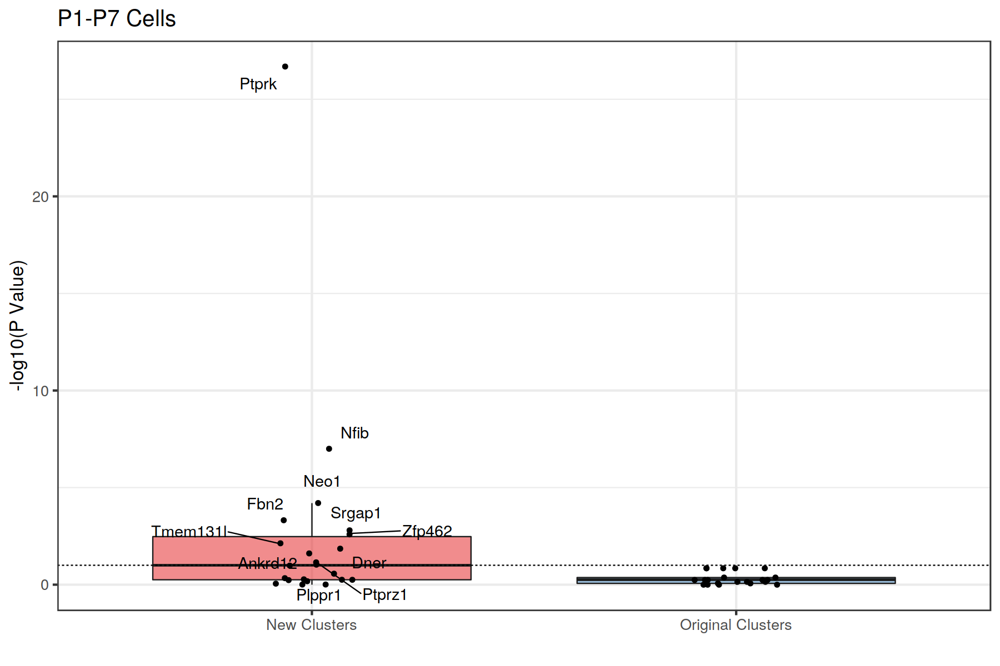

In [20]:
## P1-7
gadD = c()
targetGeneList = alls$'P1-7'[alls$'P1-7' %in% colnames(GADgeneAll)]
#targetGeneList = alls$'Neuron' #gene_lists[[cellTypeNameList[1]]]

for(targetGene in targetGeneList){ 
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType, score = gene, type, targetGene)
    gadD = rbind(gadD, gad)
    
}
neuronSub = gadD %>% filter(X1 >=-7.5, X1 <=2.5, X2 >= 0, X2 <= 5.2)
neuronSub$newCellType = "Neonatal Neuron 1"
neuronSub$newCellType[neuronSub$X1 >=-3.2] = "Neonatal Neuron 2"

ind = which(rownames(all) %in% rownames(neuronSub))

pData = c()
neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% newCellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")


cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = t_test_res %>% mutate(type = "New Clusters")

neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% cellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")



cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = rbind(pData, t_test_res %>% mutate(type = "Original Clusters"))
sigGADgene = pData %>% filter(pvalue <= 0.1) %$% gene
saveRDS(sigGADgene, file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_P1-7.rds"))


pos = position_jitter(width = 0.1, seed = 2)
newClusterTest1 = pData %>% ggplot(aes(x = type, y = -log10(pvalue), fill = type, label = gene)) +
    geom_boxplot(outlier.shape = NA, alpha = 0.5, color = "grey10") +
    geom_jitter( size = 2, position = pos) +
    geom_hline(yintercept = -log10(0.1), linetype = "dashed") +
    geom_text_repel(data = subset(pData, pvalue <= 0.1), aes(x = type, y = -log10(pvalue), label = gene), position = pos, max.overlaps = Inf, size = 6, min.segment.length = 2, box.padding = 0.75) +
    theme_bw(base_size = 20) +
    xlab("") +
    ylab("-log10(P Value)") +
    ggpubr::rremove("legend") +
    scale_fill_brewer(palette = "Set1") +
ggtitle("P1-P7 Cells")

newClusterTest1

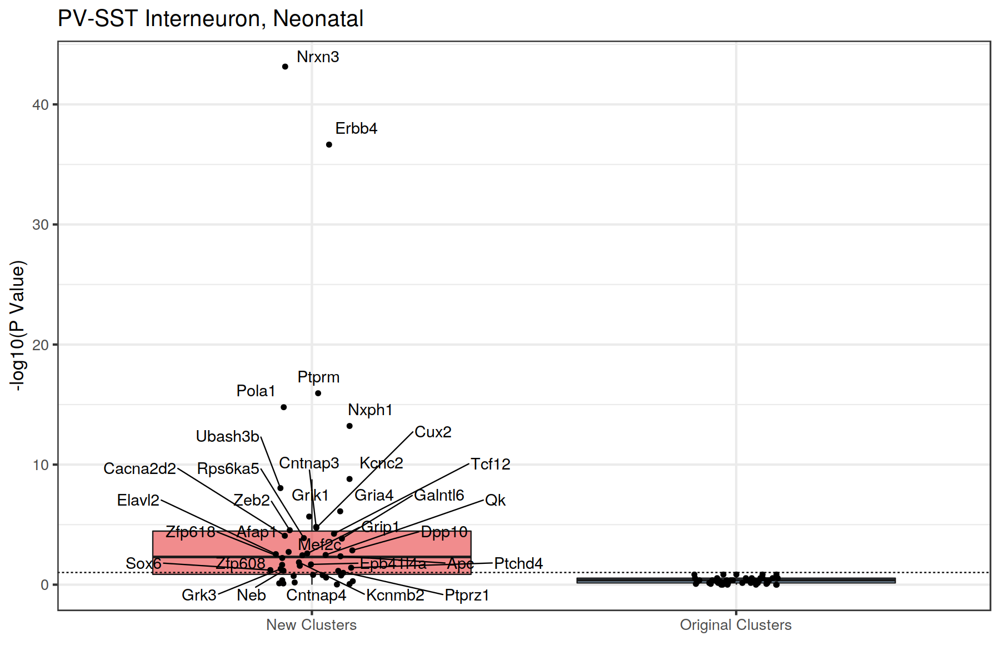

In [21]:

gadD = c()
targetGeneList = alls$'PV-SST Interneuron, Neonatal'[alls$'PV-SST Interneuron, Neonatal' %in% colnames(GADgeneAll)]
#targetGeneList = alls$'Neuron' #gene_lists[[cellTypeNameList[1]]]

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
#     rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
#             cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType, score = gene, type, targetGene)
    
#     rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
neuronSub = gadD %>% filter(X1 >=-7.5, X1 <=2.5, X2 >= 0, X2 <= 5.2)
neuronSub$newCellType = "Neonatal Neuron 1"
neuronSub$newCellType[neuronSub$X1 >=-3.2] = "Neonatal Neuron 2"

ind = which(rownames(all) %in% rownames(neuronSub))

# alls$'Neuron'
# gene_lists[[cellTypeNameList[1]]]
# head(neuronSub)
# head(all)

pData = c()
neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% newCellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")


cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = t_test_res %>% mutate(type = "New Clusters")

neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% cellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")



cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = rbind(pData, t_test_res %>% mutate(type = "Original Clusters"))
sigGADgene = pData %>% filter(pvalue <= 0.1) %$% gene
saveRDS(sigGADgene, file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_Interneuron_Neonatal.rds"))


pos = position_jitter(width = 0.1, seed = 2)
newClusterTest2 = pData %>% ggplot(aes(x = type, y = -log10(pvalue), fill = type, label = gene)) +
    geom_boxplot(outlier.shape = NA, alpha = 0.5, color = "grey10") +
    geom_jitter( size = 2, position = pos) +
    geom_hline(yintercept = -log10(0.1), linetype = "dashed") +
    geom_text_repel(data = subset(pData, pvalue <= 0.1), aes(x = type, y = -log10(pvalue), label = gene), position = pos, max.overlaps = Inf, size = 6, min.segment.length = 2, box.padding = 0.75) +
    theme_bw(base_size = 20) +
    xlab("") +
    ylab("-log10(P Value)") +
    ggpubr::rremove("legend") +
    scale_fill_brewer(palette = "Set1") +
ggtitle("PV-SST Interneuron, Neonatal")

newClusterTest2

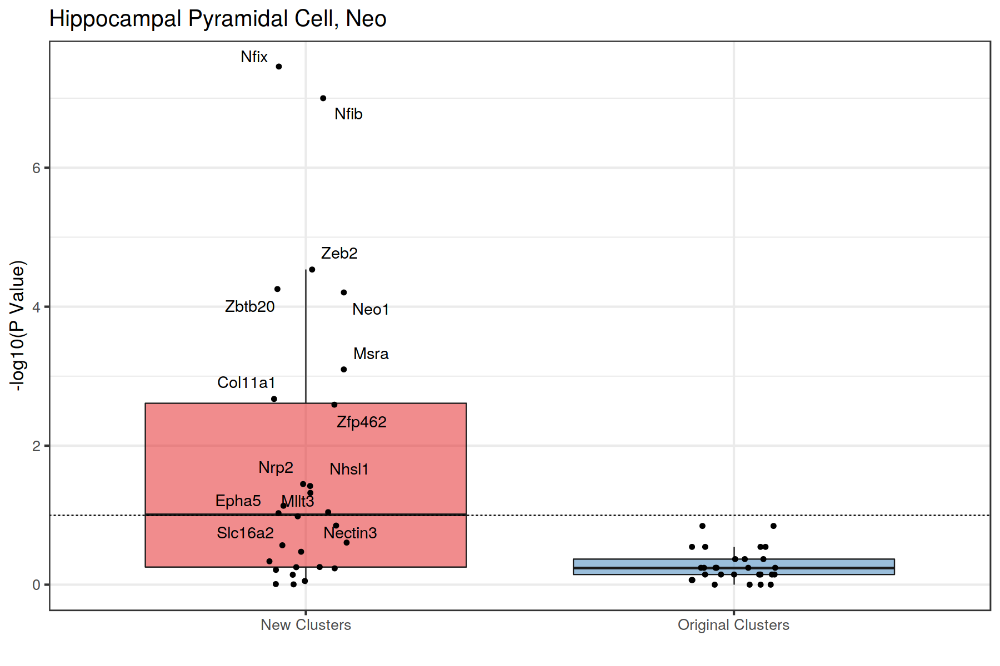

In [22]:

gadD = c()
targetGeneList = alls$'Hippocampal Pyramidal Cell, Neo'[alls$'Hippocampal Pyramidal Cell, Neo' %in% colnames(GADgeneAll)]
#targetGeneList = alls$'Neuron' #gene_lists[[cellTypeNameList[1]]]

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
#     rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
#             cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType, score = gene, type, targetGene)
    
#     rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
neuronSub = gadD %>% filter(X1 >=-7.5, X1 <=2.5, X2 >= 0, X2 <= 5.2)
neuronSub$newCellType = "Neonatal Neuron 1"
neuronSub$newCellType[neuronSub$X1 >=-3.2] = "Neonatal Neuron 2"

ind = which(rownames(all) %in% rownames(neuronSub))

# alls$'Neuron'
# gene_lists[[cellTypeNameList[1]]]
# head(neuronSub)
# head(all)

pData = c()
neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% newCellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")


cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.va #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = t_test_res %>% mutate(type = "New Clusters")

neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% cellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")



cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.va #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = rbind(pData, t_test_res %>% mutate(type = "Original Clusters"))
sigGADgene = pData %>% filter(pvalue <= 0.1) %$% gene
saveRDS(sigGADgene, file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_Hippocampal_Pyramidal_Neonatal.rds"))

pos = position_jitter(width = 0.1, seed = 2)
newClusterTest3 = pData %>% ggplot(aes(x = type, y = -log10(pvalue), fill = type, label = gene)) +
    geom_boxplot(outlier.shape = NA, alpha = 0.5, color = "grey10") +
    geom_jitter( size = 2, position = pos) +
    geom_hline(yintercept = -log10(0.1), linetype = "dashed") +
    geom_text_repel(data = subset(pData, pvalue <= 0.1), aes(x = type, y = -log10(pvalue), label = gene), position = pos, max.overlaps = Inf, size = 6, min.segment.length = 2, box.padding = 0.75) +
    theme_bw(base_size = 20) +
    xlab("") +
    ylab("-log10(P Value)") +
    ggpubr::rremove("legend") +
    scale_fill_brewer(palette = "Set1") +
ggtitle("Hippocampal Pyramidal Cell, Neo")

newClusterTest3

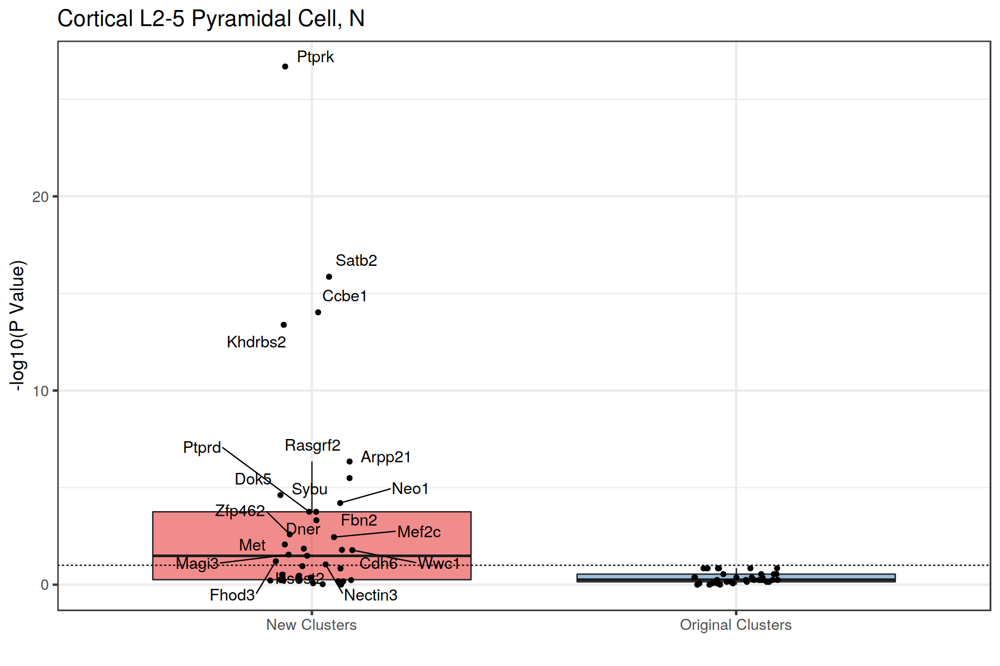

In [23]:

gadD = c()
targetGeneList = alls$'Cortical L2-5 Pyramidal Cell, N'[alls$'Cortical L2-5 Pyramidal Cell, N' %in% colnames(GADgeneAll)]
#targetGeneList = alls$'Neuron' #gene_lists[[cellTypeNameList[1]]]

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
#     rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
#             cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType, score = gene, type, targetGene)
    
#     rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
neuronSub = gadD %>% filter(X1 >=-7.5, X1 <=2.5, X2 >= 0, X2 <= 5.2)
neuronSub$newCellType = "Neonatal Neuron 1"
neuronSub$newCellType[neuronSub$X1 >=-3.2] = "Neonatal Neuron 2"

ind = which(rownames(all) %in% rownames(neuronSub))

# alls$'Neuron'
# gene_lists[[cellTypeNameList[1]]]
# head(neuronSub)
# head(all)

pData = c()
neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% newCellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")


cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = t_test_res %>% mutate(type = "New Clusters")

neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% cellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")



cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = rbind(pData, t_test_res %>% mutate(type = "Original Clusters"))
sigGADgene = pData %>% filter(pvalue <= 0.1) %$% gene
saveRDS(sigGADgene, file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_Cortical_L2-5_Pyramidal_Neonatal.rds"))


pos = position_jitter(width = 0.1, seed = 2)
newClusterTest4 = pData %>% ggplot(aes(x = type, y = -log10(pvalue), fill = type, label = gene)) +
    geom_boxplot(outlier.shape = NA, alpha = 0.5, color = "grey10") +
    geom_jitter( size = 2, position = pos) +
    geom_hline(yintercept = -log10(0.1), linetype = "dashed") +
    geom_text_repel(data = subset(pData, pvalue <= 0.1), aes(x = type, y = -log10(pvalue), label = gene), position = pos, max.overlaps = Inf, size = 6, min.segment.length = 2, box.padding = 0.75) +
    theme_bw(base_size = 20) +
    xlab("") +
    ylab("-log10(P Value)") +
    ggpubr::rremove("legend") +
    scale_fill_brewer(palette = "Set1") +
ggtitle("Cortical L2-5 Pyramidal Cell, N")
newClusterTest4

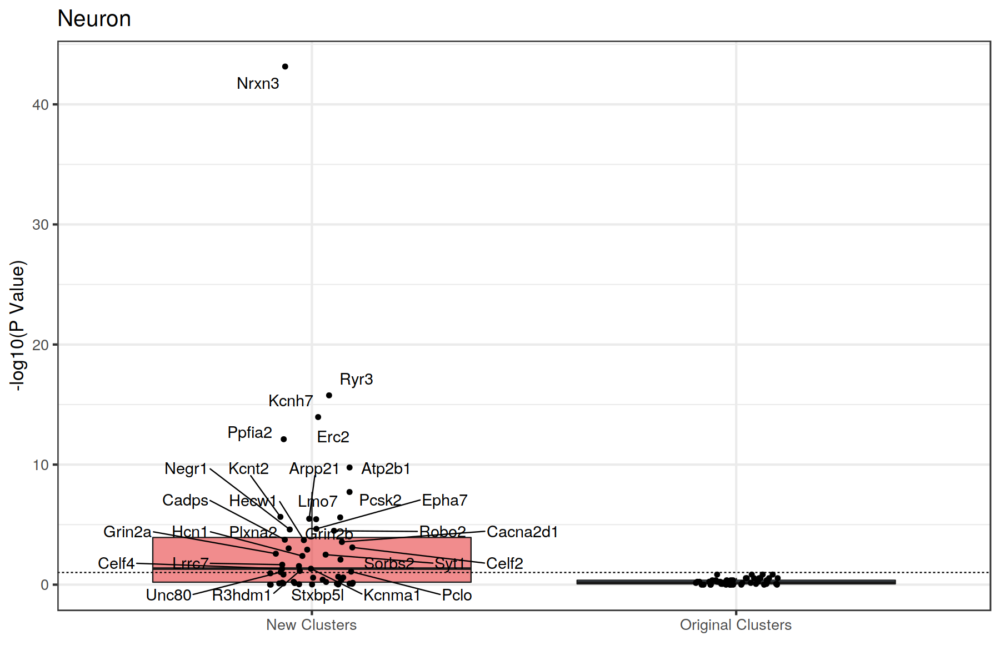

In [24]:
options(repr.plot.width=15, repr.plot.height=10)
gadD = c()
targetGeneList = alls$'Neuron'[alls$'Neuron' %in% colnames(GADgeneAll)]
#targetGeneList = alls$'Neuron' #gene_lists[[cellTypeNameList[1]]]

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
#     rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
#             cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType, score = gene, type, targetGene)
    
#     rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
neuronSub = gadD %>% filter(X1 >=-7.5, X1 <=2.5, X2 >= 0, X2 <= 5.2)
neuronSub$newCellType = "Neonatal Neuron 1"
neuronSub$newCellType[neuronSub$X1 >=-3.2] = "Neonatal Neuron 2"

ind = which(rownames(all) %in% rownames(neuronSub))

# alls$'Neuron'
# gene_lists[[cellTypeNameList[1]]]
# head(neuronSub)
# head(all)

pData = c()
neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% newCellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")


cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = t_test_res %>% mutate(type = "New Clusters")

neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% cellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")



cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = rbind(pData, t_test_res %>% mutate(type = "Original Clusters"))
sigGADgene = pData %>% filter(pvalue <= 0.1) %$% gene
saveRDS(sigGADgene, file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_Cortical_L2-5_Pyramidal_Neonatal.rds"))


pos = position_jitter(width = 0.1, seed = 2)
newClusterTest5 = pData %>% ggplot(aes(x = type, y = -log10(pvalue), fill = type, label = gene)) +
    geom_boxplot(outlier.shape = NA, alpha = 0.5, color = "grey10") +
    geom_jitter( size = 2, position = pos) +
    geom_hline(yintercept = -log10(0.1), linetype = "dashed") +
    geom_text_repel(data = subset(pData, pvalue <= 0.1), aes(x = type, y = -log10(pvalue), label = gene), position = pos, max.overlaps = Inf, size = 6, min.segment.length = 2, box.padding = 0.75) +
    theme_bw(base_size = 20) +
    xlab("") +
    ylab("-log10(P Value)") +
    ggpubr::rremove("legend") +
    scale_fill_brewer(palette = "Set1") +
ggtitle("Neuron")
newClusterTest5

png 
  2

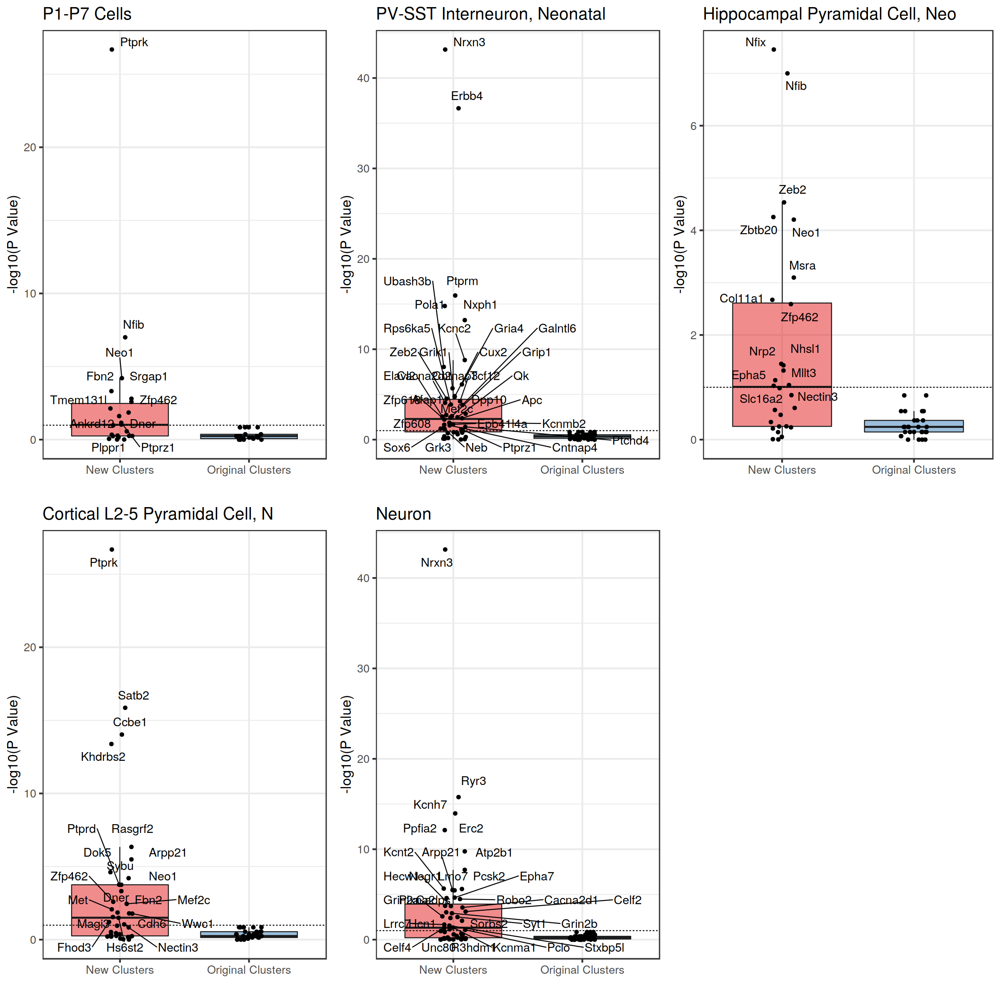

In [25]:
options(repr.plot.width=20, repr.plot.height=20)
pdf("/p/keles/schic/volumeA/Figures/newCluster5categories.pdf", width = 20, height = 20)
ggarrange(newClusterTest1, newClusterTest2, newClusterTest3, newClusterTest4, newClusterTest5, nrow = 2, ncol = 3)
dev.off()
ggarrange(newClusterTest1, newClusterTest2, newClusterTest3, newClusterTest4, newClusterTest5, nrow = 2, ncol = 3)


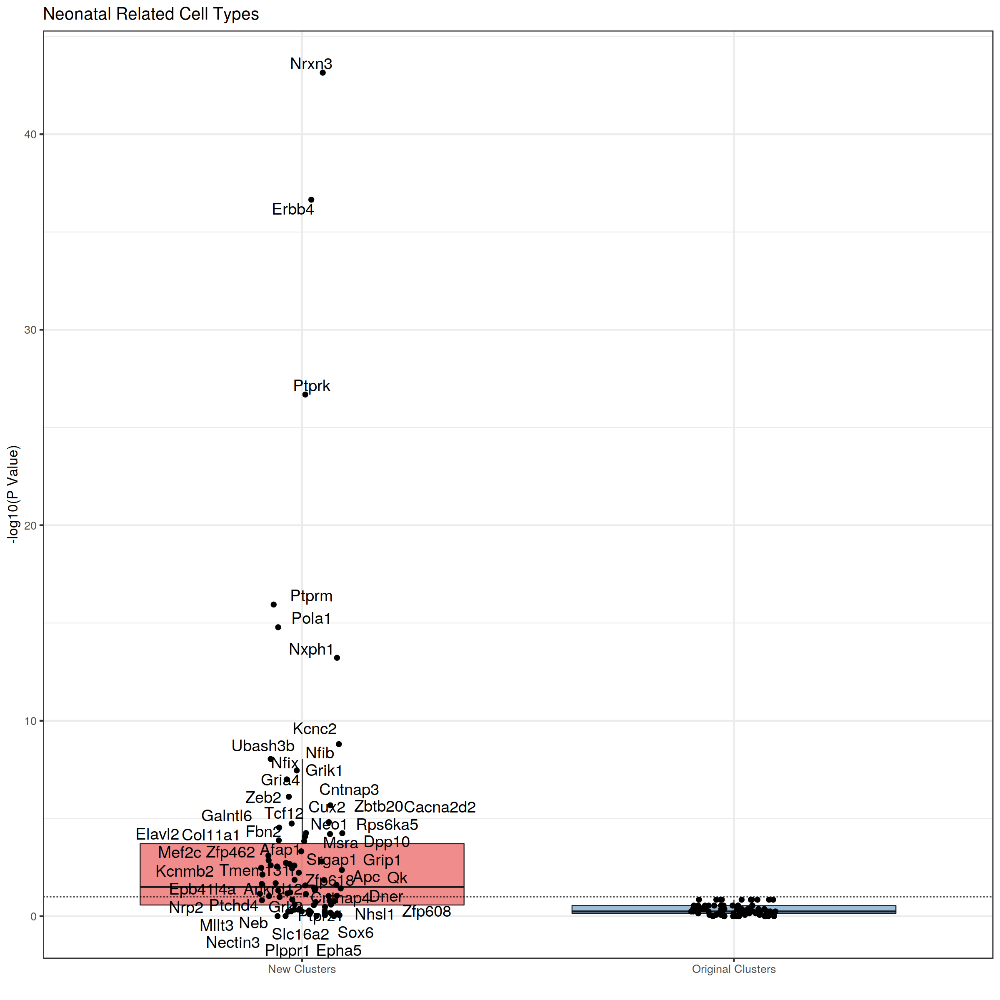

In [27]:
## All four neunatal categories
targetGeneList = c()
for(cT in c('Hippocampal Pyramidal Cell, Neo', 'PV-SST Interneuron, Neonatal', 'Hippocampal Pyramidal Cell, Neo', 'P1-7')){
    targetGeneList = c(targetGeneList, alls[[cT]])
}
targetGeneList = unique(targetGeneList)[unique(targetGeneList) %in% colnames(GADgeneAll)]
gadD = c()
for(targetGene in targetGeneList){ 
    gad = data.frame(names = rownames(all), gene = GADgeneAll[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType, score = gene, type, targetGene)
    gadD = rbind(gadD, gad)
}
neuronSub = gadD %>% filter(X1 >=-7.5, X1 <=2.5, X2 >= 0, X2 <= 5.2)
neuronSub$newCellType = "Neonatal Neuron 1"
neuronSub$newCellType[neuronSub$X1 >=-3.2] = "Neonatal Neuron 2"

ind = which(rownames(all) %in% rownames(neuronSub))

# alls$'Neuron'
# gene_lists[[cellTypeNameList[1]]]
# head(neuronSub)
# head(all)

pData = c()
neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% newCellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")


cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = t_test_res %>% mutate(type = "New Clusters")

neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% cellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")



cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.va #t.test(x1, x2)$p.value
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = rbind(pData, t_test_res %>% mutate(type = "Original Clusters"))
sigGADgene = pData %>% filter(pvalue <= 0.1) %>% arrange(pvalue) %$% gene
## saveRDS(sigGADgene, file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_all_Neonatal_Related.rds"))

pData %>% ggplot(aes(x = type, y = -log10(pvalue), fill = type, label = gene)) +
    geom_boxplot(outlier.shape = NA, alpha = 0.5, color = "grey10") +
    geom_jitter(width = 0.1, size = 3) +
    geom_hline(yintercept = -log10(0.1), linetype = "dashed") +
    geom_text_repel(data = subset(pData, pvalue <= 0.1), aes(x = type, y = -log10(pvalue), label = gene), max.overlaps = Inf, size = 8, min.segment.length = Inf) +
    theme_bw(base_size = 20) +
    xlab("") +
    ylab("-log10(P Value)") +
    ggpubr::rremove("legend") +
    scale_fill_brewer(palette = "Set1") +
ggtitle("Neonatal Related Cell Types")

In [28]:
alls

$Neuron
 [1] "Ahi1"     "Kalrn"    "Grin2b"   "Celf4"    "Sorbs2"   "Myt1l"   
 [7] "Lrrc7"    "Celf2"    "Gria1"    "Rtn1"     "Scn2a"    "Erc2"    
[13] "Gabrb3"   "Syt1"     "Ryr2"     "Cadps"    "Atp2b1"   "Arpp21"  
[19] "Hecw1"    "Cacna1b"  "Cacna1e"  "Lrfn5"    "Pclo"     "Ppfia2"  
[25] "Kcnma1"   "Stxbp5l"  "Grm5"     "Adgrb3"   "Rbfox1"   "Cnksr2"  
[31] "Tenm2"    "Scn1a"    "Unc80"    "Grin2a"   "Cacna2d1" "Kcnh7"   
[37] "R3hdm1"   "Pcsk2"    "Kcnt2"    "Atp2b2"   "Robo2"    "Plxna2"  
[43] "Negr1"    "Lmo7"     "Dgkh"     "Hcn1"     "Rasgrf1"  "Epha7"   
[49] "Ryr3"     "Nrxn3"    "Gria3"    "Epha4"   

$Astrocyte
 [1] "Ptprz1"   "Egfr"     "Atp13a4"  "Daam2"    "Msi2"     "Slc39a12"
 [7] "Arhgef26" "Slc7a11"  "Aldh1l1"  "Lama2"    "Prex2"    "Slc1a2"  
[13] "Plce1"    "Adgrv1"   "Trps1"    "Abca1"    "Mertk"    "Dtna"    
[19] "Slc4a4"   "Tspan7"   "Cpe"      "Myo6"     "Sash1"    "Luzp2"   
[25] "Trim9"    "Grk3"    

$`Neonatal Astrocyte`
 [1] "Adgrv1"   "Ptprz1"   "Egfr"     "Notch2"   "Msi2"     "Plce1"   
 [7] "Arhgef26" "Palld"    "Gsap"     "Aldh1l1"  "Abca1"    "Bcl2"    
[13] "Sema5b"   "Qk"       "Zeb1"     "Slc1a2"   "Tspan7"   "Trps1"   
[19] "Tead1"    "Sfxn5"    "Cpe"      "Prex2"    "Nckap5"   "Dtna"    
[25] "Myo6"     "Slc4a4"   "Trim9"    "Luzp2"   

$`Adult Astrocyte`
 [1] "Atp13a4"  "Slc39a12" "Slc7a11"  "Daam2"    "Ccdc141"  "Prex2"   
 [7] "Lama2"    "Mertk"    "Slc1a2"   "Slc4a4"   "Msi2"     "Dtna"    
[13] "Clmn"     "Phka1"    "Vcl"      "Myo6"     "Ptprz1"   "Syne1"   
[19] "Sash1"    "Cpe"      "Gabrb1"   "Grk3"     "Luzp2"    "Tspan7"  
[25] "Trim9"   

$`Neonatal vs. Adult Astrocyte`
 [1] "Dpysl3"   "Adgrv1"   "Nfib"     "Sema5b"   "Nav1"     "Ralgapa2"
 [7] "Trim2"    "Epha4"    "Cdk6"     "Sema6a"   "Csmd2"    "Nfix"    
[13] "Csmd1"    "Tmem131l" "Slit2"    "Ptprz1"   "Chl1"     "Tmem132b"
[19] "Evl"      "Cep112"   "Epha5"    "Grm5"     "Nrxn3"   

$`Adult vs. Neonatal Astrocyte`
 [1] "Slc1a2"   "Syne1"    "Clmn"     "Mertk"    "Atp13a4"  "Lsamp"   
 [7] "Daam2"    "Slc39a12" "Mdga2"    "Tnik"     "Prex2"    "Cadm1"   
[13] "Trpm3"    "Mbp"      "Slc4a4"   "Gabrb1"   "Slc7a11"  "Aldh1a1" 
[19] "Itpr2"    "Mical2"   "Adk"      "Vcl"      "Ntm"      "Plcb1"   
[25] "Atp2b2"  

$Oligodendrocyte
 [1] "Enpp2"   "Qk"      "Dock10"  "Mbp"     "Ankrd28" "Map7"    "Kif13a" 
 [8] "Erbin"   "Lpar1"   "Dnm3"    "Dock9"   "Edil3"   "Tmeff2"  "Tns3"   
[15] "Serinc5" "Myo6"    "Sytl2"   "Nfasc"   "Slc44a1" "Plcl1"   "Sgk1"   
[22] "Clmn"    "Cdk19"   "Itpr2"   "Exoc6b"  "Fnbp1"   "Klhl2"   "Pcdh15" 
[29] "Tnr"    

$`Oligodendrocyte Progenitor`
 [1] "Lhfpl3"   "Megf11"   "Sox6"     "Sema3d"   "Smoc1"    "Arhgap31"
 [7] "Itpr2"    "Kank1"    "Pcdh15"   "Ptprz1"   "Xylt1"    "Ppfibp1" 
[13] "Spon1"    "Tnr"      "Zeb1"     "Armh4"    "Pcdh11x"  "Luzp2"   
[19] "Rev3l"    "Zfp462"   "Sema5b"   "Pid1"     "Usp24"    "Nova1"   
[25] "Chd7"     "Cntn1"    "Kif13a"   "Dscam"    "Hip1"     "Gfra1"   
[31] "Fchsd2"   "Serinc5"  "Ncald"    "Phka1"    "Ptpre"    "Kcnd3"   
[37] "Mmp16"    "Tacc2"    "Ate1"     "Tmem132b"

$`Newly Formed Oligodendrocyte`
 [1] "Enpp6"    "Kank1"    "Tcf7l2"   "Tns3"     "Itpr2"    "St18"    
 [7] "Chn2"     "Ppfibp1"  "Epb41l2"  "Tnr"      "Fyn"      "Sox6"    
[13] "Slc22a23" "Tmem108"  "Qk"       "Ankrd44"  "Nfasc"    "Sh3d19"  
[19] "Dnm3"     "Mbp"      "Lcorl"    "Trio"     "Lrch3"    "Dock9"   
[25] "Ankrd28"  "Dock4"    "Rapgef1"  "Sema5a"   "Map4k4"   "Sema4d"  
[31] "Slc44a1"  "Cdk14"    "Opcml"    "Ptpre"    "Frmd4a"   "Ptprj"   
[37] "Fam13c"   "Pkp4"     "Mical3"   "Nckap5"  

$`Mature Oligodendrocyte`
 [1] "Pde8a"   "Enpp2"   "Map7"    "Daam2"   "Mbp"     "Lpar1"   "Erbin"  
 [8] "Sytl2"   "Fnbp1"   "Dock10"  "Myo6"    "Edil3"   "Clmn"    "Qk"     
[15] "Ptprd"   "Tmeff2"  "Plcl1"   "Ttll7"   "Wnk1"    "Mast4"   "Pex5l"  
[22] "Nfasc"   "Klhl2"   "Pcdh9"   "Exoc6b"  "Epb41l3" "Cdk19"   "Daam1"  
[29] "Sgk1"    "Dock9"   "Agpat4" 

$`Microglia Etc.`
 [1] "Cx3

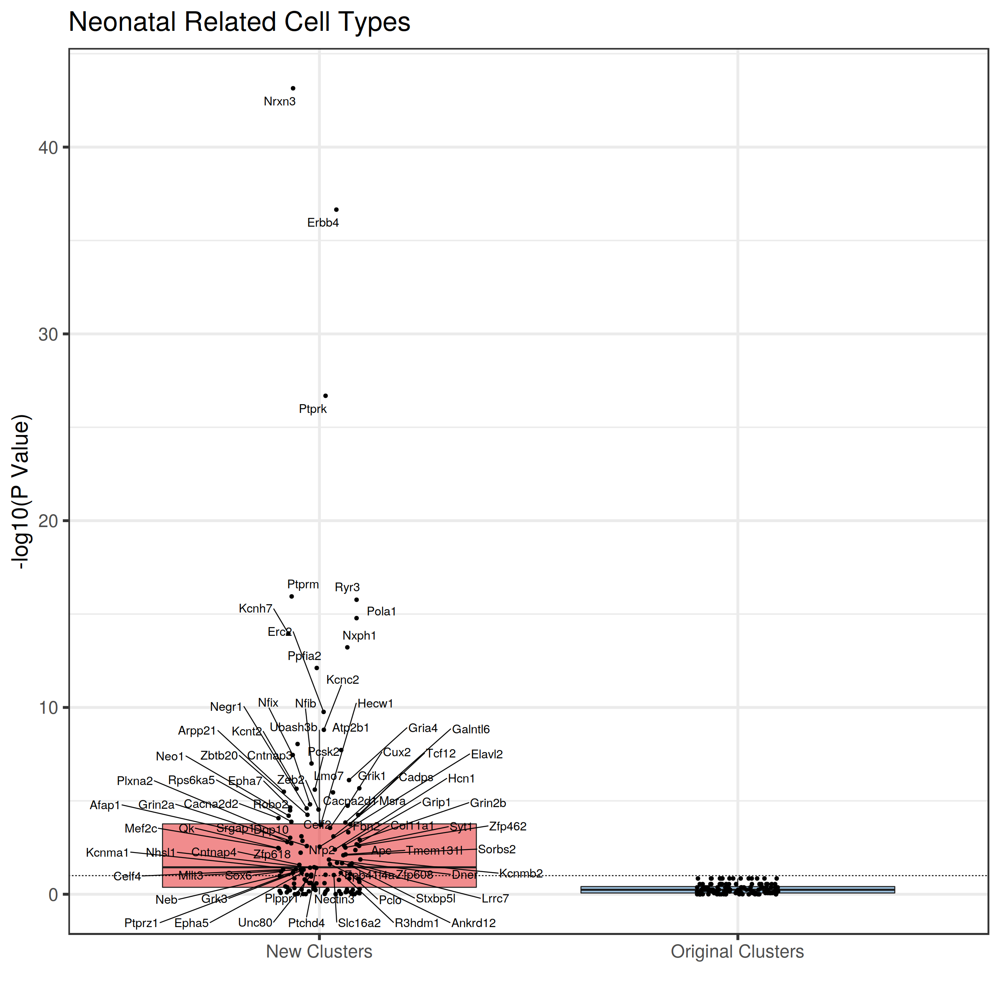

In [29]:
## All four neunatal categories
targetGeneList = c()
for(cT in c('Hippocampal Pyramidal Cell, Neo', 'PV-SST Interneuron, Neonatal', 'Hippocampal Pyramidal Cell, Neo', 'P1-7', 'Neuron')){
    targetGeneList = c(targetGeneList, alls[[cT]])
}
targetGeneList = unique(targetGeneList)[unique(targetGeneList) %in% colnames(GADgeneAll)]
gadD = c()
for(targetGene in targetGeneList){ 
    gad = data.frame(names = rownames(all), gene = GADgeneAll[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType, score = gene, type, targetGene)
    gadD = rbind(gadD, gad)
}
neuronSub = gadD %>% filter(X1 >=-7.5, X1 <=2.5, X2 >= 0, X2 <= 5.2)
neuronSub$newCellType = "Neonatal Neuron 1"
neuronSub$newCellType[neuronSub$X1 >=-3.2] = "Neonatal Neuron 2"

ind = which(rownames(all) %in% rownames(neuronSub))

# alls$'Neuron'
# gene_lists[[cellTypeNameList[1]]]
# head(neuronSub)
# head(all)

pData = c()
neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% newCellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")


cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
pDataDir = c()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
    if(wilcox.test(x1, x2, alternative = "greater")$p.value <= 0.1){
        dir = 1
    }else if(wilcox.test(x1, x2, alternative = "less")$p.value <= 0.1){
        dir = -1
    }else{
        dir = 0
    }
    pDataDir = data.frame(gene = xv, direction = dir, type = "New Clusters") %>% rbind(pDataDir, .)
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = t_test_res %>% mutate(type = "New Clusters")

neuronMap = GADgeneAll[ind, targetGeneList] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% cellType) %>% arrange(cellType)
ind1 = which(neuronMap$cellType == "Neonatal Neuron 1")
ind2 = which(neuronMap$cellType != "Neonatal Neuron 1")



cell_types <- unique(neuronMap$cellType)
cell_data <- list()
for (cell_type in cell_types) {
    cell_data[[cell_type]] = neuronMap %>% filter(cellType == cell_type)
}

xvars <- colnames(neuronMap)
t_test_ans <- list()
for (xv in xvars) {
    if (xv == 'cellType') next
    x1 <- cell_data[[cell_types[1]]][,xv]
    x2 <- cell_data[[cell_types[2]]][,xv]
    t_test_ans[[xv]] <- wilcox.test(x1, x2, alternative = "two.sided")$p.value #t.test(x1, x2)$p.value
    if(wilcox.test(x1, x2, alternative = "greater")$p.value <= 0.1){
        dir = 1
    }else if(wilcox.test(x1, x2, alternative = "less")$p.value <= 0.1){
        dir = -1
    }else{
        dir = 0
    }
    pDataDir = data.frame(gene = xv, direction = dir, type = "Original Cluster") %>% rbind(pDataDir, .)
}

t_test_res <- bind_rows(t_test_ans) %>%
    pivot_longer(everything(), names_to = c("gene"), values_to = "pvalue") %>%
    arrange(pvalue) 

pData = rbind(pData, t_test_res %>% mutate(type = "Original Clusters"))
sigGADgene = pData %>% filter(pvalue <= 0.05, type == "New Clusters") %>% arrange(pvalue) %$% gene
## saveRDS(sigGADgene, file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_all_Neonatal_Related.rds"))

pos = position_jitter(width = 0.1, seed = 2)
newClusterMerge = pData %>% ggplot(aes(x = type, y = -log10(pvalue), fill = type, label = gene)) +
    geom_boxplot(outlier.shape = NA, alpha = 0.5, color = "grey10") +
    geom_jitter( size = 2, position = pos) +
    geom_hline(yintercept = -log10(0.1), linetype = "dashed") +
    geom_text_repel(data = subset(pData, pvalue <= 0.1), aes(x = type, y = -log10(pvalue), label = gene), position = pos, max.overlaps = Inf, size = 6, min.segment.length = 2, box.padding = 0.75) +
    theme_bw(base_size = 32) +
    xlab("") +
    ylab("-log10(P Value)") +
    ggpubr::rremove("legend") +
    scale_fill_brewer(palette = "Set1") +
ggtitle("Neonatal Related Cell Types")

saveRDS(newClusterMerge, file = "/p/keles/schic/volumeB/Tan2021/RDS/newClusterMerge.rds")

newClusterMerge

### pDataAdj = rbind(pData %>% filter(type == "New Clusters") %>% mutate(Padj = p.adjust(pvalue)), pData %>% filter(type == "Original Clusters") %>% mutate(Padj = p.adjust(pvalue)))
sigGADgene = pDataAdj %>% filter(Padj <= 0.1, type == "New Clusters") %>% arrange(pvalue) %$% gene
## saveRDS(sigGADgene, file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_all_Neonatal_Related.rds"))

pos = position_jitter(width = 0.1, seed = 2)
newClusterMerge = pDataAdj %>% ggplot(aes(x = type, y = -log10(Padj), fill = type, label = gene)) +
    geom_boxplot(outlier.shape = NA, alpha = 0.5, color = "grey10") +
    geom_jitter( size = 2, position = pos) +
    geom_hline(yintercept = -log10(0.1), linetype = "dashed") +
    geom_text_repel(data = subset(pDataAdj, Padj <= 0.1), aes(x = type, y = -log10(Padj), label = gene), position = pos, max.overlaps = Inf, size = 6, min.segment.length = 2, box.padding = 0.75) +
    theme_bw(base_size = 20) +
    xlab("") +
    ylab("-log10(Adjusted P Value)") +
    ggpubr::rremove("legend") +
    scale_fill_brewer(palette = "Set1") +
ggtitle("Neonatal Related Cell Types")
newClusterMerge

In [30]:
# pDataDir %>% filter(gene %in% sigGADgene, type == "New Clusters") 
#  pData %>% filter(pvalue <= 0.05, type == "New Clusters")
sigGADgene = pData %>% filter(pvalue <= 0.01, type == "New Clusters") %>% arrange(pvalue) %$% gene

length(sigGADgene)

# pDataDir %>% filter(gene %in% sigGADgene, type == "New Clusters") %>% arrange(gene)
pDataDir %>% filter(type == "New Clusters", direction!=0)

[1] 57

gene,direction,type
<chr>,<dbl>,<chr>
Chl1,-1,New Clusters
Slc16a2,-1,New Clusters
Zbtb20,-1,New Clusters
Nectin3,-1,New Clusters
Zfp462,-1,New Clusters
Nfix,-1,New Clusters
Dcc,-1,New Clusters
Nrp2,-1,New Clusters
Neo1,-1,New Clusters


In [31]:
sigGADgene = pData %>% filter(pvalue <= 0.1) %>% arrange(pvalue) %$% gene

sigGADgene %>% length

[1] 82

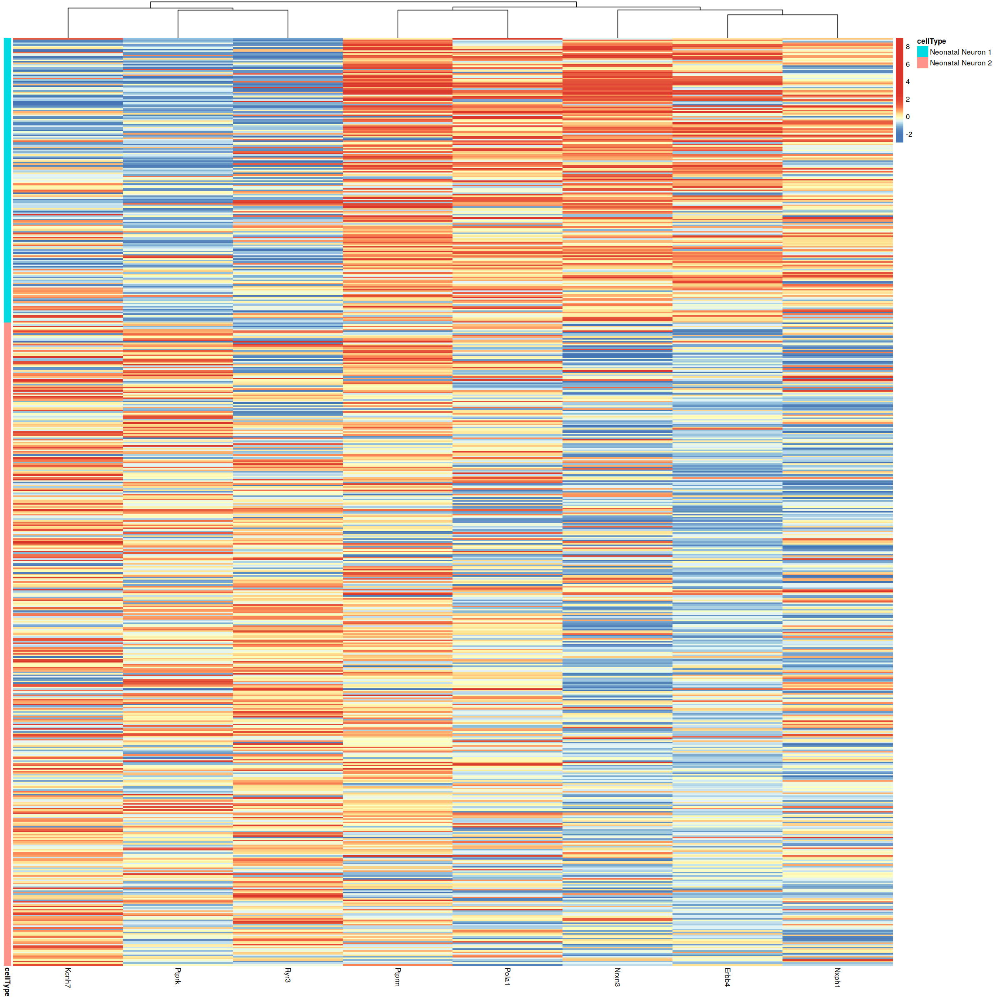

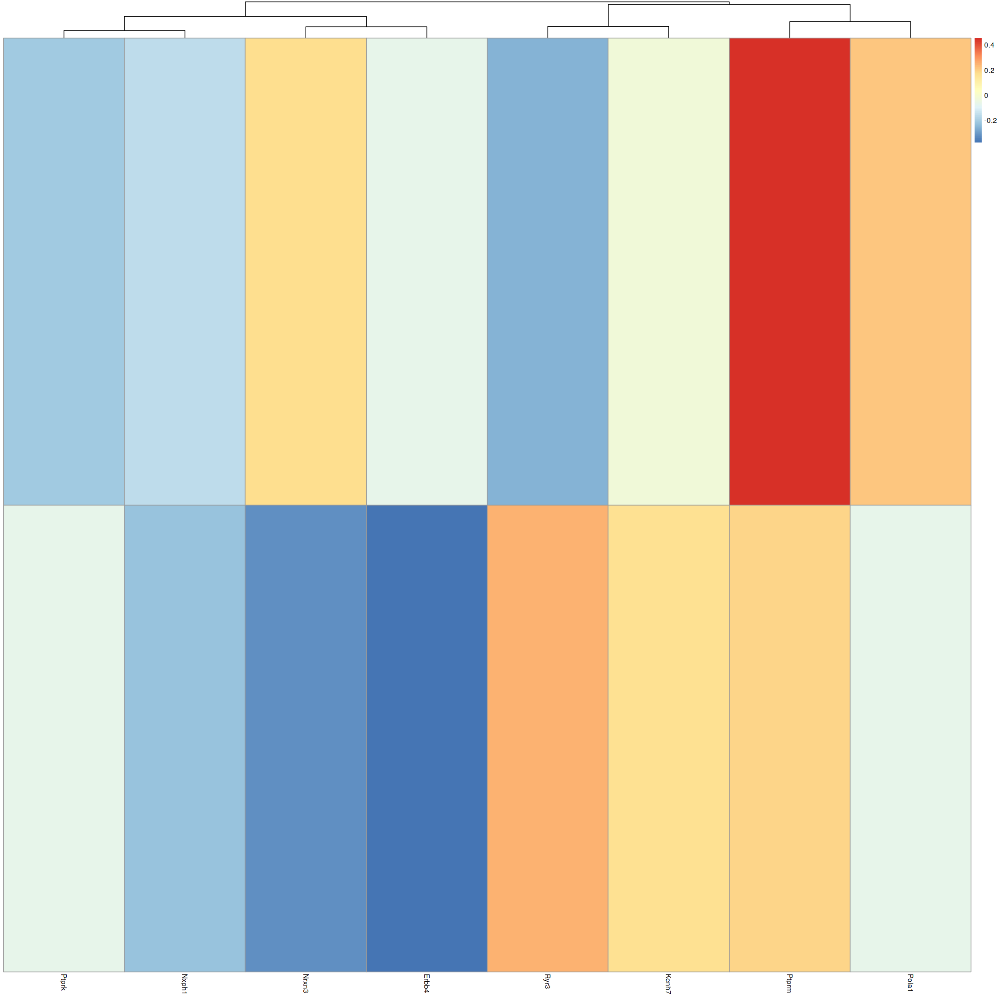

In [32]:

targetGene = sigGADgene[1:8] #c("Frmd4a", "Srgap1", "Tmem131l", "Nfib", "Ankrd12", "Ptprz1") #gene_lists[[cellTypeNameList[1]]] #t_test_res$gene #
neuronMap = all[ind, targetGene] %>% data.frame %>% mutate(cellType = neuronSub[1:length(ind), ] %$% newCellType) %>% arrange(cellType)
neuronCT = data.frame(cellType = neuronMap$cellType) #data.frame(cellType = neuronSub %>% filter(targetGene == gene_lists[[cellTypeNameList[1]]][1]) %$% newCellType)
rownames(neuronCT) = rownames(neuronMap)

quantile_breaks <- function(xs, n = 10) {
  breaks <- quantile(xs[xs != 0], probs = seq(0, 1, length.out = (n - 1)))
  c(0, breaks[!duplicated(breaks)])
}

mat_breaks <- quantile_breaks(neuronMap %>% select(-cellType), n = 100)

# pheatmap(neuronMap %>% filter(cellType == "Neonatal Neuron 1") %>% select(-cellType), 
#          breaks = mat_breaks, cluster_cols = F, cluster_rows = T, annotation_row = neuronCT %>% filter(cellType == "Neonatal Neuron 1"), show_rownames = F)
# pheatmap(neuronMap %>% filter(cellType == "Neonatal Neuron 2") %>% select(-cellType), 
#          breaks = mat_breaks, cluster_cols = F, cluster_rows = T, annotation_row = neuronCT %>% filter(cellType == "Neonatal Neuron 2"), show_rownames = F)

pheatmap(neuronMap %>% select(-cellType), 
         breaks = mat_breaks, cluster_cols = T, cluster_rows = F, annotation_row = neuronCT, show_rownames = F)

rbind(neuronMap[ind1, ] %>% select(-cellType) %>% colMeans, neuronMap[ind2, ] %>% select(-cellType) %>% colMeans) %>% 
    data.frame %>% select(all_of(targetGene)) %>%
    pheatmap(., 
         cluster_cols = T, cluster_rows = F, show_rownames = F)




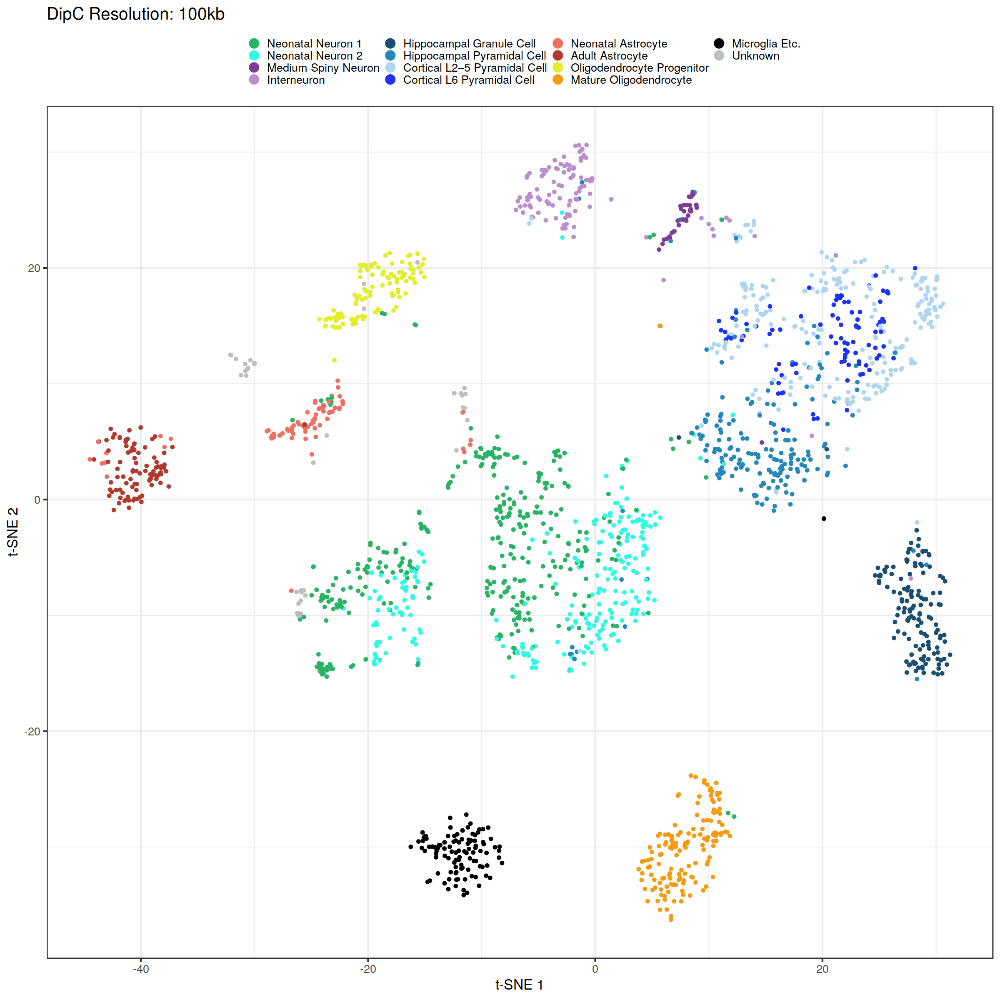

In [33]:
tsneD = cbind(resTSNE, cell_info[, "cell-type cluster"])
colnames(tsneD) = c("X1", "X2", "celltype")

dipCtsne = tsneD %>% ggplot(aes(x = X1, y = X2, color = celltype)) +
geom_point(size = 2) +
theme_bw(base_size = 20) +
xlab("t-SNE 1") +
ylab("t-SNE 2") +
ggtitle("DipC Resolution: 100kb") +
scale_color_manual(breaks = c("Neonatal Neuron 1", "Neonatal Neuron 2", 
                              "Medium Spiny Neuron", "Interneuron",
                              "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                             "Cortical L2–5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                              "Neonatal Astrocyte", "Adult Astrocyte",
                              "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                              "Microglia Etc.", "Unknown"), 
                   values = c("#28B463", "#2FFBE5", 
                              "#7D3C98", "#BB8FCE",
                              "#1B4F72", "#2488BA",
                              "#AED6F1", "#1C33F6", 
                              "#EC7063", "#B03A2E", 
                              "#E2EE27", "#F39C12", 
                              "#000000", "grey")) +
theme(legend.position = "top") +
ggpubr::rremove("legend.title") +
guides(colour = guide_legend(nrow = 4, override.aes = list(size = 6)))

saveRDS(dipCtsne, file = "/p/keles/schic/volumeB/Tan2021/RDS/dipCtsne.rds")
dipCtsne

In [17]:
## load(file = "/p/keles/schic/volumeB/Tan2021/RNA_SeuratObj.RData")


In [34]:
rnaUMAPD = data.frame(X1 = RNA_SeuratObj@reductions$umap@cell.embeddings[, 1], X2 = RNA_SeuratObj@reductions$umap@cell.embeddings[, 2], cellType = RNA_SeuratObj@active.ident %>% as.vector) 
head(rnaUMAPD)
unique(rnaUMAPD$cellType)

,X1,X2,cellType
,<dbl>,<dbl>,<chr>
PR10_HCA_P14HM-1_01,2.1418211,-7.052780,Hippocampal CA1 Pyramidal Cell
PR10_HCA_P14HM-1_02,8.6733482,0.862799,Hippocampal Granuale Cell
PR10_HCA_P14HM-1_03,0.6625856,-4.619916,Cortical L6 Pyramidal Cell
PR10_HCA_P14HM-1_04,9.4243658,0.372699,Hippocampal Granuale Cell
PR10_HCA_P14HM-1_07,0.1100568,-4.527929,Hippocampal CA1 Pyramidal Cell
PR10_HCA_P14HM-1_08,0.5222773,-4.661809,Cortical L5 Pyramidal Cell


[1] "Hippocampal CA1 Pyramidal Cell"            
 [2] "Hippocampal Granuale Cell"                 
 [3] "Cortical L6 Pyramidal Cell"                
 [4] "Cortical L5 Pyramidal Cell"                
 [5] "Cajal-Retzius Cell"                        
 [6] "Microglia Etc."                            
 [7] "Neonatal Astrocyte"                        
 [8] "Adult Astrocyte"                           
 [9] "Cortical L2-4 Pyramidal Cell, Intermediate"
[10] "Hippocampal CA3 Pyramidal Cell"            
[11] "Oligodendrocyte Progenitor"                
[12] "Newly Formed Oligodendrocyte"              
[13] "VIP Interneuron"                           
[14] "PV/SST Interneuron, Neonatal"              
[15] "SST Interneuron"                           
[16] "MEIS2 Interneuron"                         
[17] "Cortical L2/3 Pyramidal Cell"              
[18] "Medium Spiny Neuron"                       
[19] "Cortical L2-5 Pyramidal Cell, Neonatal"    
[20] "Cortical L4 Pyramidal Cell"                
[21] "Unknown Interneuron 2"                     
[22] "NDNF Interneuron"                          
[23] "Unknown Interneuron 1"                     
[24] "PV Interneuron"                            
[25] "Mature Oligodendrocyte"                    
[26] "Hippocampal Pyramidal Cell, Neonatal"

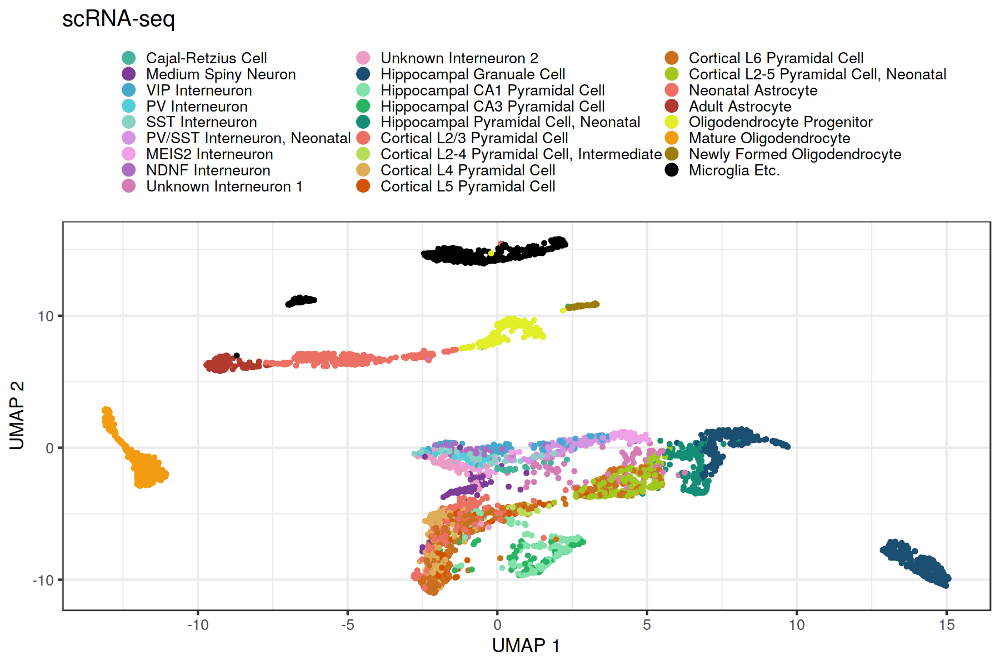

In [35]:
options(repr.plot.width=15, repr.plot.height=10)

rnaUMAPrds = rnaUMAPD %>% ggplot(aes(x = X1, y = X2, color = cellType)) +
geom_point(size = 2) +
theme_bw(base_size = 20) +
xlab("UMAP 1") +
ylab("UMAP 2") +
ggtitle("scRNA-seq") +
scale_color_manual(breaks =  c("Neonatal Neuron 1", "Neonatal Neuron 2", "Cajal-Retzius Cell",
                              "Medium Spiny Neuron", "VIP Interneuron", "PV Interneuron", "SST Interneuron", "PV/SST Interneuron, Neonatal", "MEIS2 Interneuron", "NDNF Interneuron", "Unknown Interneuron 1", "Unknown Interneuron 2",
                              "Hippocampal Granuale Cell", "Hippocapmal Pyramidal Cell", "Hippocampal CA1 Pyramidal Cell", "Hippocampal CA3 Pyramidal Cell", "Hippocampal Pyramidal Cell, Neonatal",
                             "Cortical L2/3 Pyramidal Cell", "Cortical L2-4 Pyramidal Cell, Intermediate", "Cortical L4 Pyramidal Cell", "Cortical L5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", "Cortical L2-5 Pyramidal Cell, Neonatal",
                              "Neonatal Astrocyte", "Adult Astrocyte",
                              "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", "Newly Formed Oligodendrocyte",
                              "Microglia Etc.",  "Unknown"), 
                   values = c("#28B463", "#2FFBE5", "#45B39D",
                              "#7D3C98", "#46A8CD", "#51CDDC", "#87D3C3", "#D494E3", "#F0A0E7", "#AC6CC0", "#D67CB4", "#EC9DC3",
                              "#1B4F72", "#2488BA", "#82E0AA", "#28B463", "#138D75",
                              "#EC7063", "#B8DE58", "#DEAD58", "#D35400", "#CA6F1E", "#A2C820",
                              "#EC7063", "#B03A2E", 
                              "#E2EE27", "#F39C12", "#9A7D0A",
                              "#000000",  "grey")) +
theme(legend.position = "top") +
ggpubr::rremove("legend.title") +
guides(colour = guide_legend(nrow = 9, override.aes = list(size = 6)))

saveRDS(rnaUMAPrds, file = "/p/keles/schic/volumeB/Tan2021/RDS/rnaUMAPrds.rds")
rnaUMAPrds

Centering and scaling data matrix

Centering and scaling data matrix



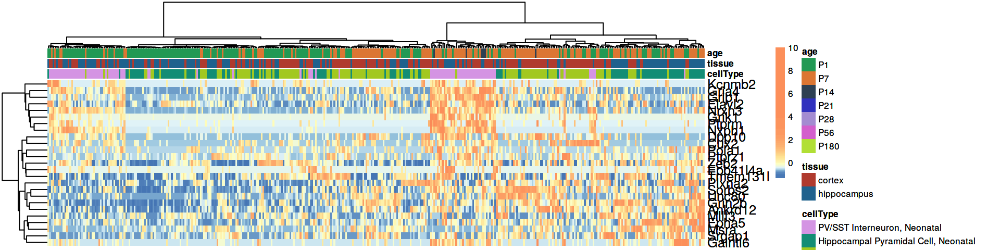

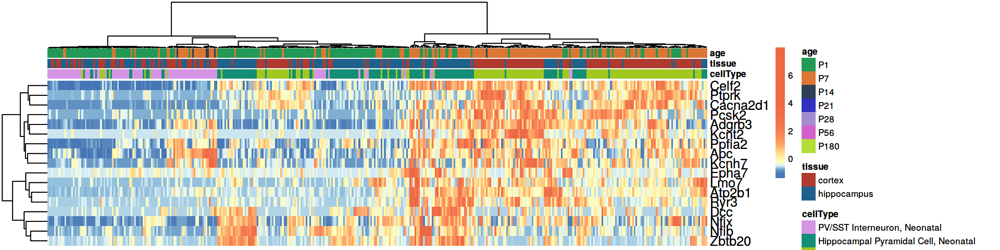

In [39]:
## RNA_SeuratObj

quantile_breaks <- function(xs, n = 10) {
  breaks <- quantile(xs[xs != 0], probs = seq(0, 1, length.out = (n - 1)))
  c(0, breaks[!duplicated(breaks)])
}


cellInd = RNA_SeuratObj@active.ident %in% c("PV/SST Interneuron, Neonatal", "Hippocampal Pyramidal Cell, Neonatal", "Cortical L2-5 Pyramidal Cell, Neonatal")
neuronCellTypeLabel = data.frame(cellType = factor(RNA_SeuratObj@active.ident[cellInd], levels = c("PV/SST Interneuron, Neonatal", "Hippocampal Pyramidal Cell, Neonatal", "Cortical L2-5 Pyramidal Cell, Neonatal")),
                                tissue = factor(RNA_SeuratObj@meta.data$tissue[cellInd], levels = c("cortex", "hippocampus")),
                                age = factor(RNA_SeuratObj@meta.data$age[cellInd], levels = paste0("P", c(1, 7, 14, 21, 28, 56, 180))))
neuronCellTypeColor = c("#D494E3", "#138D75", "#A2C820")
names(neuronCellTypeColor) = c("PV/SST Interneuron, Neonatal", "Hippocampal Pyramidal Cell, Neonatal", "Cortical L2-5 Pyramidal Cell, Neonatal")

## tissue
#neuronTissueLabel = data.frame(cellType = factor(RNA_SeuratObj@meta.data$tissue[cellInd], levels = c("cortex", "hippocampus")))
neuronTissueColor = c("#B03A2E", "#1F618D")
names(neuronTissueColor) = c("cortex", "hippocampus")

## age
#neuronAgeLabel = data.frame(cellType = factor(RNA_SeuratObj@meta.data$age[cellInd], levels = paste0("P", c(1, 7, 14, 21, 28, 56, 180))))
neuronAgeColor = c("#229954", "#DC7633","#2E4053", "#3131BE", "#A48CD1", "#D35FCC", "#B1DF35")
names(neuronAgeColor) = paste0("P", c(1, 7, 14, 21, 28, 56, 180))


sigGADgene = readRDS(file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_all_Neonatal_Related.rds"))
# sigGADgene = pDataDir %>% filter(type == "New Clusters", direction!=0) %$% gene
geneGADdirLabel = data.frame(direction = pDataDir %>% filter(gene %in% sigGADgene, type == "New Clusters") %$% direction %>% factor(., levels = c(1, -1)))
rownames(geneGADdirLabel) = pDataDir %>% filter(gene %in% sigGADgene, type == "New Clusters") %$% gene
geneGADdirColor = c("#A93226", "#1F618D") #factor(pDataDir %>% filter(gene %in% sigGADgene, type == "New Clusters") %$% direction, levels = c(1, -1), labels = c("#922B21", "#2874A6"))
names(geneGADdirColor) = c(1, -1)

cellInd = RNA_SeuratObj@active.ident %in% c("PV/SST Interneuron, Neonatal", "Hippocampal Pyramidal Cell, Neonatal", "Cortical L2-5 Pyramidal Cell, Neonatal")
geneInd = rownames(RNA_SeuratObj@assays$RNA@counts) %in% (pDataDir %>% filter(type == "New Clusters", direction==1) %$% gene)
subRNA = RNA_SeuratObj@assays$RNA@counts[geneInd, cellInd]
geneInd = rownames(RNA_SeuratObj@assays$RNA@counts) %in% (pDataDir %>% filter(type == "New Clusters", direction==-1) %$% gene)
subRNA = RNA_SeuratObj@assays$RNA@counts[geneInd, cellInd] %>% rbind(subRNA, .)

subRNA = subRNA[rownames(subRNA) %in% sigGADgene, ]

# mat_breaks <- quantile_breaks(subRNA %>% as.matrix  %>% ScaleData, n = 100)
# pheatmap(subRNA,  breaks = mat_breaks, annotation_col = neuronCellTypeLabel, annotation_row = geneGADdirLabel, 
#          annotation_colors = list(cellType = neuronCellTypeColor, direction = geneGADdirColor), cluster_cols = T, cluster_rows = F,  clustering_method = "ward.D", show_colnames = F, scale = "row")

# mat_breaks <- quantile_breaks(subRNA %>% as.matrix  %>% ScaleData, n = 100)
# pheatmap(subRNA,  breaks = mat_breaks, annotation_col = neuronCellTypeLabel, annotation_row = geneGADdirLabel, 
#          annotation_colors = list(cellType = neuronCellTypeColor, direction = geneGADdirColor), cluster_cols = T, cluster_rows = T, clustering_method = "ward.D", show_colnames = F, scale = "row")

##
cellInd = RNA_SeuratObj@active.ident %in% c("PV/SST Interneuron, Neonatal", "Hippocampal Pyramidal Cell, Neonatal", "Cortical L2-5 Pyramidal Cell, Neonatal")
geneInd = rownames(RNA_SeuratObj@assays$RNA@counts) %in% (pDataDir %>% filter(type == "New Clusters", direction==1) %$% gene)
subRNA = RNA_SeuratObj@assays$RNA@counts[geneInd, cellInd]

subRNA = subRNA[rownames(subRNA) %in% sigGADgene, ]
leftGene = rownames(subRNA)
saveRDS(leftGene, file = "/p/keles/schic/volumeB/Tan2021/RDS/leftGene.rds")

mat_breaks <- quantile_breaks(subRNA %>% as.matrix  %>% ScaleData, n = 100)
neonatalIhp = pheatmap(subRNA,  breaks = mat_breaks, annotation_col = neuronCellTypeLabel, #annotation_row = geneGADdirLabel, 
         annotation_colors = list(cellType = neuronCellTypeColor, tissue = neuronTissueColor, age = neuronAgeColor, direction = geneGADdirColor), cluster_cols = T, cluster_rows = T, clustering_method = "ward.D", 
                       show_colnames = F, scale = "row", fontsize_row = 15)

neonatalIhp
##
cellInd = RNA_SeuratObj@active.ident %in% c("PV/SST Interneuron, Neonatal", "Hippocampal Pyramidal Cell, Neonatal", "Cortical L2-5 Pyramidal Cell, Neonatal")
geneInd = rownames(RNA_SeuratObj@assays$RNA@counts) %in% (pDataDir %>% filter(type == "New Clusters", direction==-1) %$% gene)
subRNA = RNA_SeuratObj@assays$RNA@counts[geneInd, cellInd]

subRNA = subRNA[rownames(subRNA) %in% sigGADgene, ]

rightGene = rownames(subRNA)
saveRDS(rightGene, file = "/p/keles/schic/volumeB/Tan2021/RDS/rightGene.rds")

mat_breaks <- quantile_breaks(subRNA %>% as.matrix  %>% ScaleData, n = 100)
neonatalIIhp = pheatmap(subRNA,  breaks = mat_breaks, annotation_col = neuronCellTypeLabel, #annotation_row = geneGADdirLabel, 
         annotation_colors = list(cellType = neuronCellTypeColor, tissue = neuronTissueColor, age = neuronAgeColor,  direction = geneGADdirColor), cluster_cols = T, cluster_rows = T, clustering_method = "ward.D", 
                        show_colnames = F, scale = "row", fontsize_row = 15)

neonatalIIhp

saveRDS(neonatalIhp, file = "/p/keles/schic/volumeB/Tan2021/RDS/neonatalIhp.rds")

saveRDS(neonatalIIhp, file = "/p/keles/schic/volumeB/Tan2021/RDS/neonatalIIhp.rds")


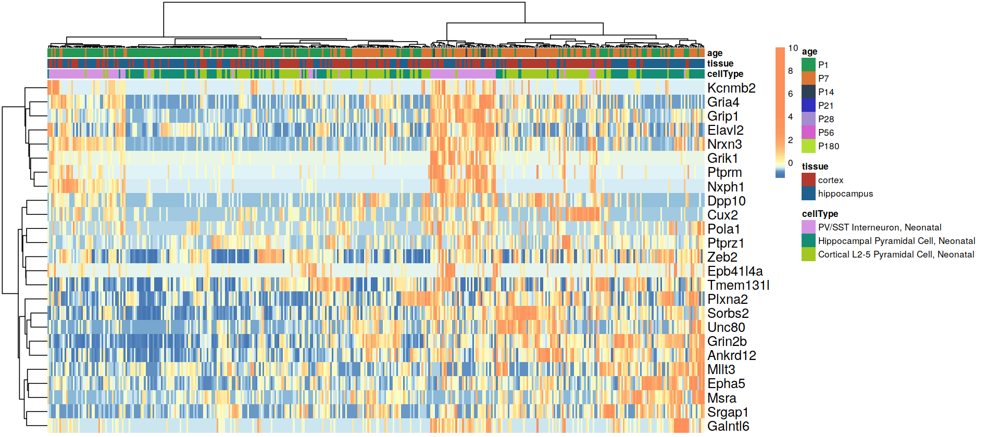

In [37]:
options(repr.plot.width=16, repr.plot.height=7)
neonatalIhp


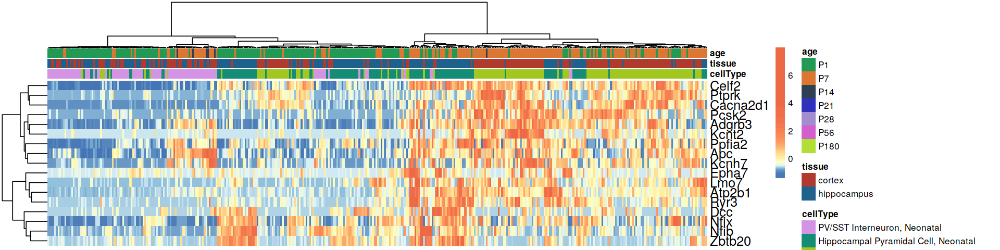

In [38]:
options(repr.plot.width=16, repr.plot.height=4)
neonatalIIhp


In [13]:
sigGADgene = readRDS(file = paste0("/p/keles/schic/volumeB/Tan2021/RDS/sigGADgene_all_Neonatal_Related.rds"))
length(sigGADgene)

[1] 49

Loading required package: GenomicFeatures

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted, lapply, Map, mapply, match, mget,
    order, paste, pmax, pmax.int, pmin, pmin.int, Position, rank,
    rbind, Reduce, rownames, sapply, setdiff, sort, table, tapply,
    union, unique, unsplit, which.max, which.min


Loading req

,category,over_represented_pvalue,under_represented_pvalue,numDEInCat,numInCat,term,ontology
,<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>
5312,GO:0034703,0.0001084348,0.9999909,6,83,cation channel complex,CC
5314,GO:0034705,0.0001326989,0.9999947,4,27,potassium channel complex,CC
1131,GO:0004970,0.0002986912,0.9999927,3,14,ionotropic glutamate receptor activity,MF
5311,GO:0034702,0.0003911895,0.9999577,6,103,ion channel complex,CC
11017,GO:1902495,0.0004124801,0.9999549,6,104,transmembrane transporter complex,CC
11850,GO:1990351,0.0004370329,0.9999517,6,105,transporter complex,CC
8017,GO:0051957,0.0006972153,0.9999952,2,4,positive regulation of amino acid transport,BP
2091,GO:0008066,0.0008283876,0.9999699,3,19,glutamate receptor activity,MF
4942,GO:0032983,0.0008773990,0.9999922,2,5,kainate selective glutamate receptor complex,CC


'select()' returned 1:1 mapping between keys and columns

Can't find mm10/ensGene length data in genLenDataBase...

Found the annotation package, TxDb.Mmusculus.UCSC.mm10.ensGene

Trying to get the gene lengths from it.

Warning message in pcls(G):
“initial point very close to some inequality constraints”


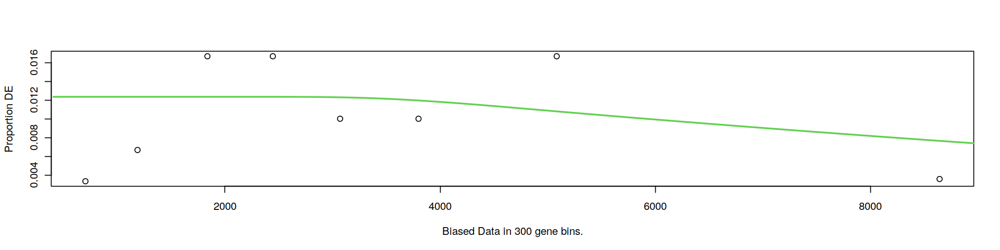

Fetching GO annotations...

For 13 genes, we could not find any categories. These genes will be excluded.

To force their use, please run with use_genes_without_cat=TRUE (see documentation).

This was the default behavior for version 1.15.1 and earlier.

Calculating the p-values...

'select()' returned 1:1 mapping between keys and columns



,category,over_represented_pvalue,under_represented_pvalue,numDEInCat,numInCat,term,ontology
,<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>
7097,GO:0046873,0.000949720,0.9999094,5,101,metal ion transmembrane transporter activity,MF
7874,GO:0051481,0.001026173,0.9999890,2,7,negative regulation of cytosolic calcium ion concentration,BP
7518,GO:0050680,0.001343248,0.9999423,3,30,negative regulation of epithelial cell proliferation,BP
3900,GO:0022890,0.001859218,0.9997920,5,119,inorganic cation transmembrane transporter activity,MF
7371,GO:0048667,0.001981148,0.9997263,6,195,cell morphogenesis involved in neuron differentiation,BP
2198,GO:0008324,0.002014998,0.9997702,5,122,cation transmembrane transporter activity,MF
6658,GO:0045295,0.002672743,0.9999500,2,9,gamma-catenin binding,MF
10465,GO:0110111,0.002877998,0.9999428,2,10,negative regulation of animal organ morphogenesis,BP
10084,GO:0098662,0.003021565,0.9996199,5,138,inorganic cation transmembrane transport,BP


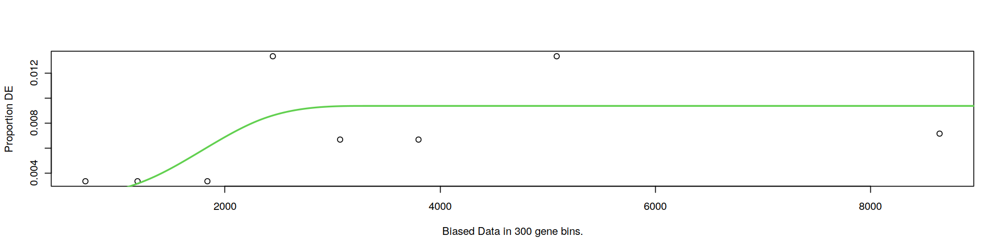

In [41]:
# GO of left and right cluster GAD genes
library(TxDb.Mmusculus.UCSC.mm10.ensGene)
library(org.Mm.eg.db)
library(goseq)

left = readRDS( file = "/p/keles/schic/volumeB/Tan2021/RDS/leftGene.rds")# c("Grip1", "Gria4", "Kcnip1", "Elavl2", "Nrxn3", "Grik1", "Ptprm", "Nxph1", "Mllt3",
#         "Epha5", "Msra", "Srgap1", "Galntl6", "Plxna2", "Zbtb20", "Dcc", "Pola1", "Zeb2", "Celf2",
#         "Frmd4a", "Sorbs2", "Adgrb3", "Kcnh7", "Ankrd12", "Rtn1", "Grin2b", "Kcnmb2", "Epb41l4a",
#         "Thsd7a", "Dpp10", "Tenm2", "Tmem131l", "Cux2") #
right = readRDS( file = "/p/keles/schic/volumeB/Tan2021/RDS/rightGene.rds") #c("Ptprk", "Cacna2d1", "Kcnt2", "Cacna1b", "Ryr2", "Pcsk2", "Epha7", "Lmo7", "Atp2b1",
#           "Ryr3", "Apc", "Ppfia2", "Unc80", "Ptprz1", "Nfix", "Nfib") #readRDS( file = "/p/keles/schic/volumeB/Tan2021/RDS/rightGene.rds") #

paths = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control_promoter/", full.names = TRUE)
names = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control_promoter/")
temp = fread(paths[1])
GAD_reg = matrix(0, nrow = nrow(temp), ncol = length(paths))
for (k in 1:length(names)){
    cell = fread(paths[k])
    GAD_reg[, k] = cell$V2
}
GAD_reg = GAD_reg[!duplicated(temp$V1), ]
temp = temp[!duplicated(temp$V1), ]
rownames(GAD_reg) = temp$V1
colnames(GAD_reg) = names
all_cell_norm = t(t(GAD_reg) / colSums(GAD_reg)) * 1e04
all = (all_cell_norm - rowMeans(all_cell_norm))/sqrt(rowVars(all_cell_norm))
all = rownames(all)

library("org.Mm.eg.db")
symbols <- mapIds(org.Mm.eg.db, keys = all, keytype = "SYMBOL", column="ENSEMBL")
symbols = symbols[!duplicated(symbols)]
symbols = symbols[!is.na(symbols)]
all_genes = rep(0, length(symbols))
names(all_genes) = symbols

left_ens <- mapIds(org.Mm.eg.db, keys = left, keytype = "SYMBOL", column="ENSEMBL")

left_go = all_genes
left_go[names(left_go) %in% left_ens] = 1

pwf=nullp(DEgenes = left_go, genome = "mm10", id = "ensGene")
left_go_result = goseq(pwf,"mm10","ensGene")#[1:10, ]
left_go_result %>% head(20) #%>% filter(ontology == "BP") %>% top_n(20, wt = -over_represented_pvalue)

right_ens <- mapIds(org.Mm.eg.db, keys = right, keytype = "SYMBOL", column="ENSEMBL")
right_go = all_genes
right_go[names(right_go) %in% right_ens] = 1

pwf=nullp(right_go, "mm10", "ensGene")
right_go_result = goseq(pwf,"mm10","ensGene")#[1:10, ]
right_go_result %>% head(20)  #%>% filter(ontology == "BP") %>% top_n(20, wt = -over_represented_pvalue)

#save(left_go_result, right_go_result, file = "/p/keles/schic/volumeB/Tan2021/Neonatal_subclusters_GO.RData")

# analysis is done in Neonatal_Subcluster.ipynb
save(left_go_result, right_go_result, file = "/p/keles/schic/volumeB/Tan2021/RData/Neonatal_subclusters_GO_full.RData")
load(file = "/p/keles/schic/volumeB/Tan2021/RData/Neonatal_subclusters_GO_full.RData")

In [42]:
head(left_go_result %>% mutate(newTerm = paste0(term, "(", ontology, ")")) )

,category,over_represented_pvalue,under_represented_pvalue,numDEInCat,numInCat,term,ontology,newTerm
,<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>,<chr>
5312,GO:0034703,0.0001084348,0.9999909,6,83,cation channel complex,CC,cation channel complex(CC)
5314,GO:0034705,0.0001326989,0.9999947,4,27,potassium channel complex,CC,potassium channel complex(CC)
1131,GO:0004970,0.0002986912,0.9999927,3,14,ionotropic glutamate receptor activity,MF,ionotropic glutamate receptor activity(MF)
5311,GO:0034702,0.0003911895,0.9999577,6,103,ion channel complex,CC,ion channel complex(CC)
11017,GO:1902495,0.0004124801,0.9999549,6,104,transmembrane transporter complex,CC,transmembrane transporter complex(CC)
11850,GO:1990351,0.0004370329,0.9999517,6,105,transporter complex,CC,transporter complex(CC)


also installing the dependency ‘shades’



ggfittext installed

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


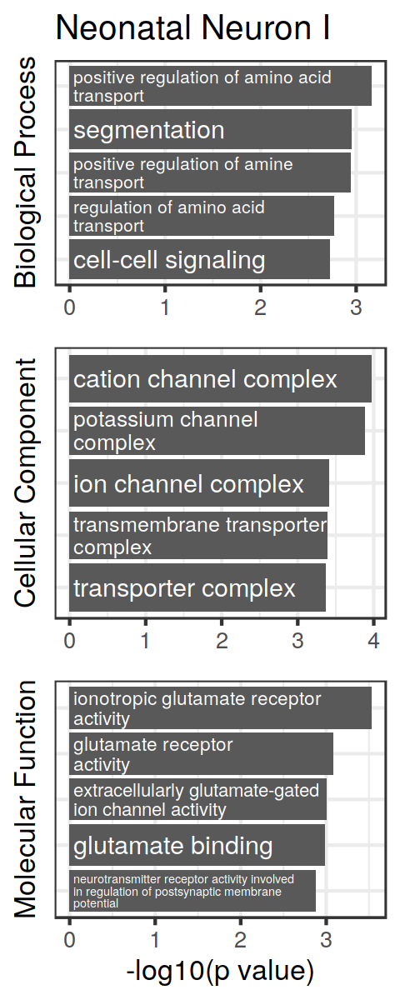

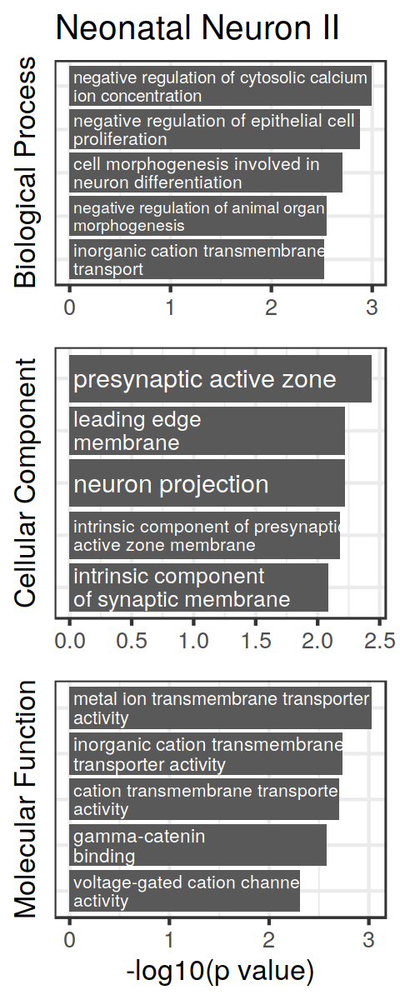

In [45]:
pacman::p_load(ggfittext)

bp1 = left_go_result %>% filter(ontology == "BP") %>% head(5) %>% ggplot(aes(x = reorder(term, -over_represented_pvalue), y = -log10(over_represented_pvalue), label = reorder(term, -over_represented_pvalue))) +
    geom_col(position = "dodge") +
geom_bar_text(position = "dodge", place = "left", reflow = TRUE, grow = FALSE, size = 18) +
coord_flip() +
ggtitle("Neonatal Neuron I") +
theme_bw(base_size = 20) +
theme(axis.text.y = element_blank(),  axis.title.x = element_blank(), axis.ticks.y = element_blank()) +
guides(size = FALSE) +
xlab("Biological Process") +
ylab("")

cc1 = left_go_result %>% filter(ontology == "CC") %>% head(5) %>% ggplot(aes(x = reorder(term, -over_represented_pvalue), y = -log10(over_represented_pvalue), label = reorder(term, -over_represented_pvalue))) +
    geom_col(position = "dodge") +
geom_bar_text(position = "dodge", place = "left", reflow = TRUE, grow = FALSE, size = 18) +
coord_flip() +
ylab("") +
theme_bw(base_size = 20) +
theme(axis.text.y = element_blank(),  axis.title.x = element_blank(), axis.ticks.y = element_blank()) +
guides(size = FALSE) +
xlab("Cellular Component")

mf1 = left_go_result %>% filter(ontology == "MF") %>% head(5) %>% ggplot(aes(x = reorder(term, -over_represented_pvalue), y = -log10(over_represented_pvalue), label = reorder(term, -over_represented_pvalue))) +
    geom_col(position = "dodge") +
geom_bar_text(position = "dodge", place = "left", reflow = TRUE, grow = FALSE, size = 18) +
coord_flip() +
ylab("-log10(p value)") +
theme_bw(base_size = 20) +
theme(axis.text.y = element_blank(),  axis.ticks.y = element_blank()) +
guides(size = FALSE) +
xlab("Molecular Function") +
ylab("-log10(p value)")

neonatalIgo = ggarrange(bp1, cc1, mf1, nrow = 3, ncol = 1) 

##
bp2 = right_go_result %>% filter(ontology == "BP") %>% head(5) %>% ggplot(aes(x = reorder(term, -over_represented_pvalue), y = -log10(over_represented_pvalue), label = reorder(term, -over_represented_pvalue))) +
    geom_col(position = "dodge") +
geom_bar_text(position = "dodge", place = "left", reflow = TRUE, grow = FALSE, size = 18) +
coord_flip() +
ggtitle("Neonatal Neuron II") +
theme_bw(base_size = 20) +
theme(axis.text.y = element_blank(),  axis.title.x = element_blank(), axis.ticks.y = element_blank()) +
guides(size = FALSE) +
xlab("Biological Process")

cc2 = right_go_result %>% filter(ontology == "CC") %>% head(5) %>% ggplot(aes(x = reorder(term, -over_represented_pvalue), y = -log10(over_represented_pvalue), label = reorder(term, -over_represented_pvalue))) +
    geom_col(position = "dodge") +
geom_bar_text(position = "dodge", place = "left", reflow = TRUE, grow = FALSE, size = 18) +
coord_flip() +
theme_bw(base_size = 20) +
theme(axis.text.y = element_blank(), axis.title.x = element_blank(), axis.ticks.y = element_blank()) +
guides(size = FALSE) +
xlab("Cellular Component")

mf2 = right_go_result %>% filter(ontology == "MF") %>% head(5) %>% ggplot(aes(x = reorder(term, -over_represented_pvalue), y = -log10(over_represented_pvalue), label = reorder(term, -over_represented_pvalue))) +
    geom_col(position = "dodge") +
geom_bar_text(position = "dodge", place = "left", reflow = TRUE, grow = FALSE, size = 18) +
coord_flip() +
theme_bw(base_size = 20) +
theme(axis.text.y = element_blank(), axis.ticks.y = element_blank()) +
guides(size = FALSE) +
xlab("Molecular Function") +
ylab("-log10(p value)")

neonatalIIgo = ggarrange(bp2, cc2, mf2, nrow = 3, ncol = 1) 

saveRDS(neonatalIgo, file = "/p/keles/schic/volumeB/Tan2021/RDS/neonatalIgo.rds")
saveRDS(neonatalIIgo, file = "/p/keles/schic/volumeB/Tan2021/RDS/neonatalIIgo.rds")

options(repr.plot.width=4, repr.plot.height=10)


neonatalIgo
neonatalIIgo

## mean_gad_score_boxplot$cell_type %>% unique

In [46]:
cellTypeList = c("Neonatal Neuron 1", "Neonatal Neuron 2", 
                 "Medium Spiny Neuron", "Interneuron",
                 "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                 "Cortical L2-5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                 "Neonatal Astrocyte", "Adult Astrocyte",
                 "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                 "Microglia Etc.") #, "Unknown"
cellTypeNameList = gsub(" ", "_", cellTypeList)
cellTypeNameList

[1] "Neonatal_Neuron_1"            "Neonatal_Neuron_2"           
 [3] "Medium_Spiny_Neuron"          "Interneuron"                 
 [5] "Hippocampal_Granule_Cell"     "Hippocampal_Pyramidal_Cell"  
 [7] "Cortical_L2-5_Pyramidal_Cell" "Cortical_L6_Pyramidal_Cell"  
 [9] "Neonatal_Astrocyte"           "Adult_Astrocyte"             
[11] "Oligodendrocyte_Progenitor"   "Mature_Oligodendrocyte"      
[13] "Microglia_Etc."

Coordinate system already present. Adding new coordinate system, which will replace the existing one.

Warning message:
“Removed 26 rows containing non-finite values (stat_boxplot).”


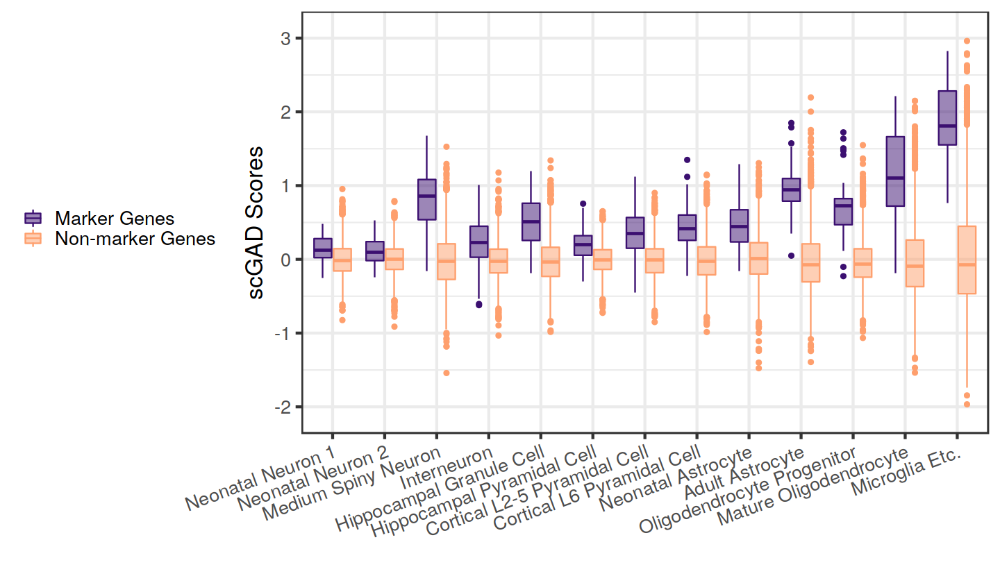

In [53]:
options(repr.plot.width=12, repr.plot.height=7)
gadMarkerNonmarker = mean_gad_score_boxplot %>%
ggplot(aes(x=factor(cell_type, levels = cellTypeNameList, labels = cellTypeList), y=as.numeric(gad), color=factor(markers, levels = c(1, 0), labels = c("Marker Genes", "Non-marker Genes")), fill=factor(markers, levels = c(1, 0), labels = c("Marker Genes", "Non-marker Genes")))) + 
    geom_boxplot() + 
    theme_bw(base_size = 20) + 
    ggpubr::rotate_x_text(angle = 20) +
    ylab("scGAD Scores") + xlab("") + 
    coord_cartesian(ylim = c(0, 5)) +
    scale_fill_viridis(option = "magma", discrete =TRUE, begin = 0.2, end = 0.8, alpha = 0.5) +
    scale_color_viridis(option = "magma", discrete =TRUE, begin = 0.2, end = 0.8) +
    ggpubr::rremove("legend.title") +
    theme(legend.position = "left") +
coord_cartesian(ylim = c(-2.1, 3.1))
#coord_flip(ylim = c(0,4)) +


saveRDS(gadMarkerNonmarker, file = "/p/keles/schic/volumeB/Tan2021/RDS/gadMarkerNonmarker.rds")
gadMarkerNonmarker

In [55]:
# Get gad scores for all cells and summary these into a matrix "all".
paths = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control_promoter/", full.names = TRUE)
names = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control_promoter/")
temp = fread(paths[1])
GAD_reg = matrix(0, nrow = nrow(temp), ncol = length(paths))
for (k in 1:length(names)){
    cell = fread(paths[k])
    GAD_reg[, k] = cell$V2
}
GAD_reg = GAD_reg[!duplicated(temp$V1), ]
temp = temp[!duplicated(temp$V1), ]
rownames(GAD_reg) = temp$V1
colnames(GAD_reg) = names
all_cell_norm = t(t(GAD_reg) / colSums(GAD_reg)) * 1e04
all = (all_cell_norm - rowMeans(all_cell_norm))/sqrt(rowVars(all_cell_norm))

s = CreateSeuratObject(all)
all.genes <- rownames(s)

cell_types = summary$`cell-type cluster`
names(cell_types) = summary$cell
Idents(s) = cell_types
s@assays$RNA@scale.data = all
pbmc.markers = all_marker_genes
head(all_marker_genes)
top10 = pbmc.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_log2FC)
top10 = top10[!duplicated(top10$gene), ]
selected = s@assays$RNA@scale.data
selected = selected[rownames(selected) %in% top10$gene, ]
selected = selected[match(top10$gene, rownames(selected)), ]
selected = aggregate(selected, data.frame(top10$cluster), sum)
all_features = as.character(selected$top10.cluster)


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Gli2,5.688103e-24,1.513480,0.907,0.432,1.411787e-20,Neonatal Astrocyte,Gli2
Lpp,1.894119e-21,2.033270,0.893,0.440,4.701203e-18,Neonatal Astrocyte,Lpp
Sox6,9.964665e-21,3.088212,0.920,0.404,2.473230e-17,Neonatal Astrocyte,Sox6
Creb5,4.875110e-20,1.587464,0.853,0.444,1.210002e-16,Neonatal Astrocyte,Creb5
Bcl2,6.401930e-20,1.457874,0.853,0.423,1.588959e-16,Neonatal Astrocyte,Bcl2
Shroom3,1.191160e-19,4.144654,0.893,0.431,2.956459e-16,Neonatal Astrocyte,Shroom3


In [56]:
cellTypeList= c("Neonatal Neuron 1", "Neonatal Neuron 2", 
                 "Medium Spiny Neuron", "Interneuron",
                 "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                 "Cortical L2–5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                 "Neonatal Astrocyte", "Adult Astrocyte",
                 "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                 "Microglia Etc.", "Unknown") #
cellTypeColor = c("#28B463", "#2FFBE5", 
                              "#7D3C98", "#BB8FCE",
                              "#1B4F72", "#2488BA",
                              "#AED6F1", "#1C33F6", 
                              "#EC7063", "#B03A2E", 
                              "#E2EE27", "#F39C12", 
                              "#000000", "grey")

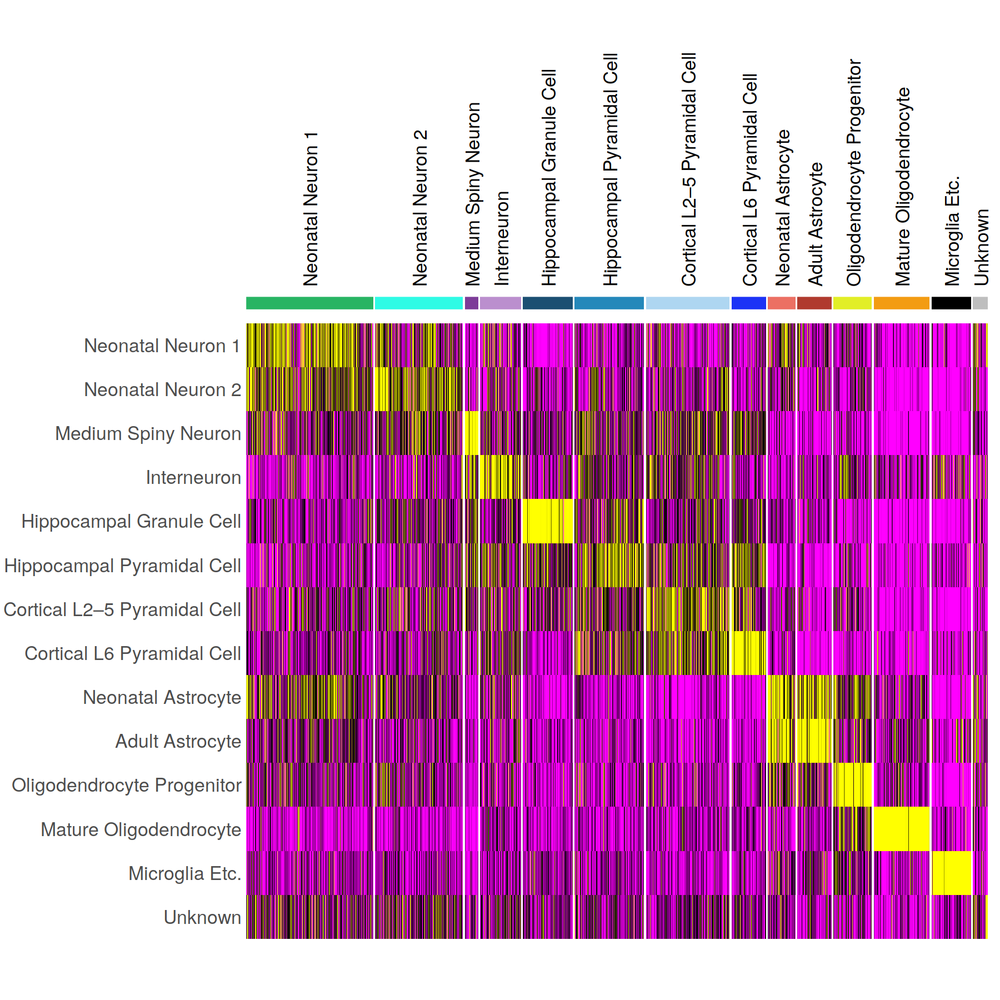

In [57]:
options(repr.plot.width=15, repr.plot.height=15)
Idents(seurat_heatmap_obj) = factor(Idents(seurat_heatmap_obj), levels = cellTypeList)
p = DoHeatmap(seurat_heatmap_obj, features = all_features, slot = "counts", label = TRUE, group.colors = cellTypeColor, angle = 90, size = 7) + NoLegend() + theme(axis.text.y = element_text(size = 20))
p$data$Feature = factor(p$data$Feature, levels = rev(cellTypeList))
oriNeonatal1 = p 
oriNeonatal1


Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


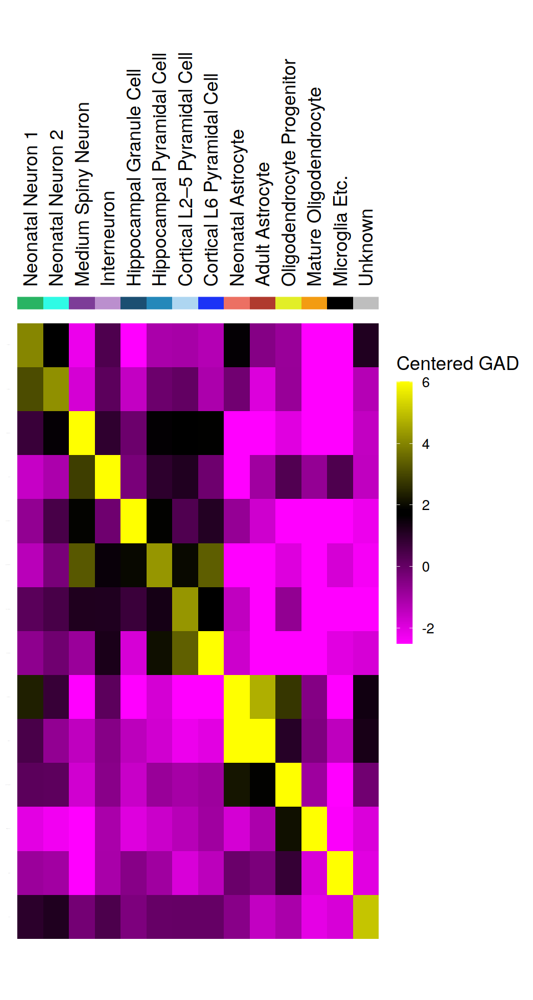

In [58]:
options(repr.plot.width=8, repr.plot.height=15)
Idents(seurat_mean_heatmap_obj) = factor(Idents(seurat_mean_heatmap_obj), levels = cellTypeList)
p = DoHeatmap(seurat_mean_heatmap_obj, features = all_features, slot = "counts", label = TRUE, group.colors = cellTypeColor, draw.lines = FALSE, size = 7, angle = 90) + 
    theme(axis.text.y = element_text(size = 0), legend.key.height = unit(2, "cm"), legend.text = element_text(size = 15), legend.title = element_text(size = 20)) + guides(colour = FALSE) + labs(fill = "Centered GAD")

p$data$Feature = factor(p$data$Feature, levels = rev(cellTypeList))
oriNeonatal2 = p #+ ggpubr::theme_pubclean()
oriNeonatal2

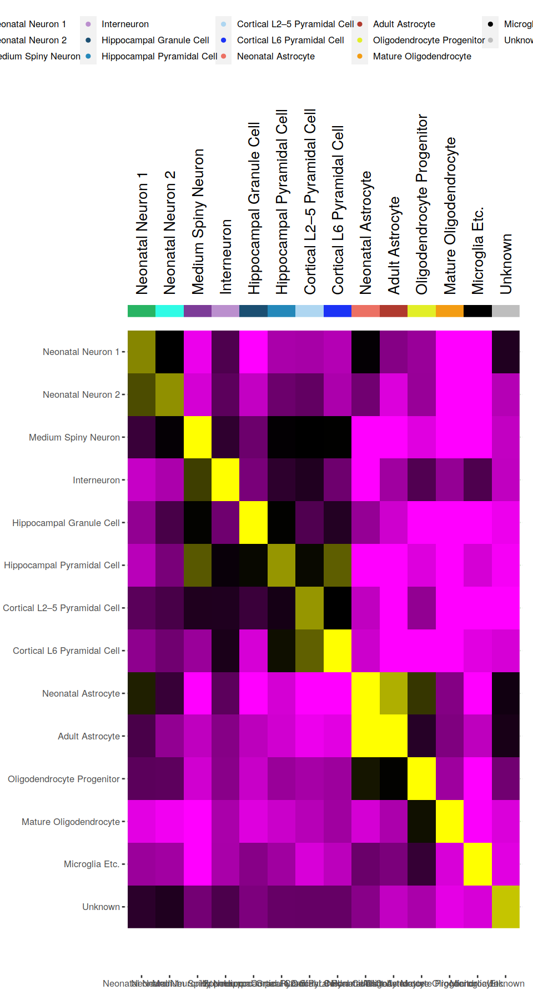

In [59]:
Idents(seurat_mean_heatmap_obj) = factor(Idents(seurat_mean_heatmap_obj), levels = cellTypeList)
p = DoHeatmap(seurat_mean_heatmap_obj, features = all_features, slot = "counts", label = TRUE, group.colors = cellTypeColor, draw.lines = FALSE, angle = 90) + NoLegend()
p$data$Feature = factor(p$data$Feature, levels = rev(cellTypeList))
p + ggpubr::theme_pubclean()

In [60]:
## save(all_genes, top10_genes, sig_genes, file = "/p/keles/schic/volumeB/Tan2021/detected_markergenes_control_all_top10_sig.RData")
load(file = "/p/keles/schic/volumeB/Tan2021/rdata_01272022/detected_markergenes_control_all_top10_sig.RData")
load("/p/keles/schic/volumeB/Tan2021/rdata_01272022/heatmap_objs.RData")

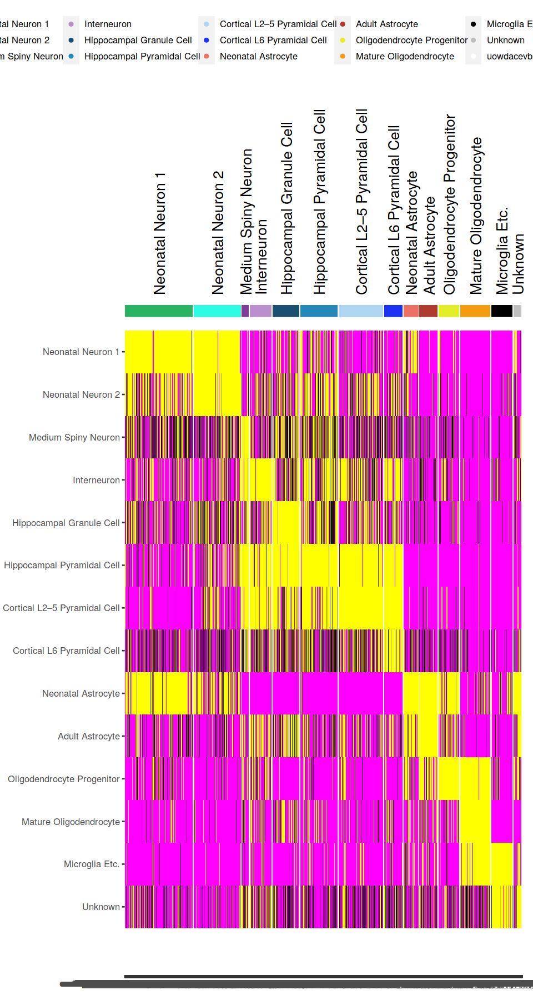

In [61]:
Idents(seurat_rowmean_sig_heatmap_obj) = factor(Idents(seurat_rowmean_sig_heatmap_obj), levels = cellTypeList)
p = DoHeatmap(seurat_rowmean_sig_heatmap_obj, features = all_features, slot = "counts", label = TRUE, group.colors = cellTypeColor, angle = 90) + NoLegend()
p$data$Feature = factor(p$data$Feature, levels = rev(cellTypeList))
p + ggpubr::theme_pubclean()

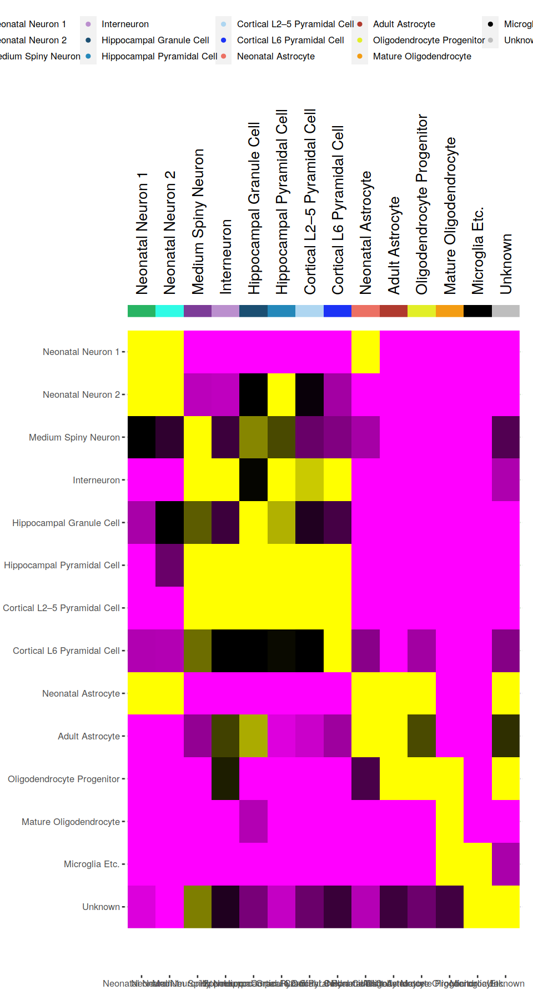

In [62]:
Idents(seurat_rowcolmean_sig_heatmap_obj) = factor(Idents(seurat_rowcolmean_sig_heatmap_obj), levels = cellTypeList)
p = DoHeatmap(seurat_rowcolmean_sig_heatmap_obj, features = all_features, slot = "counts", label = TRUE, group.colors = cellTypeColor, draw.lines = FALSE, angle = 90) + NoLegend()
p$data$Feature = factor(p$data$Feature, levels = rev(cellTypeList))
p + ggpubr::theme_pubclean()

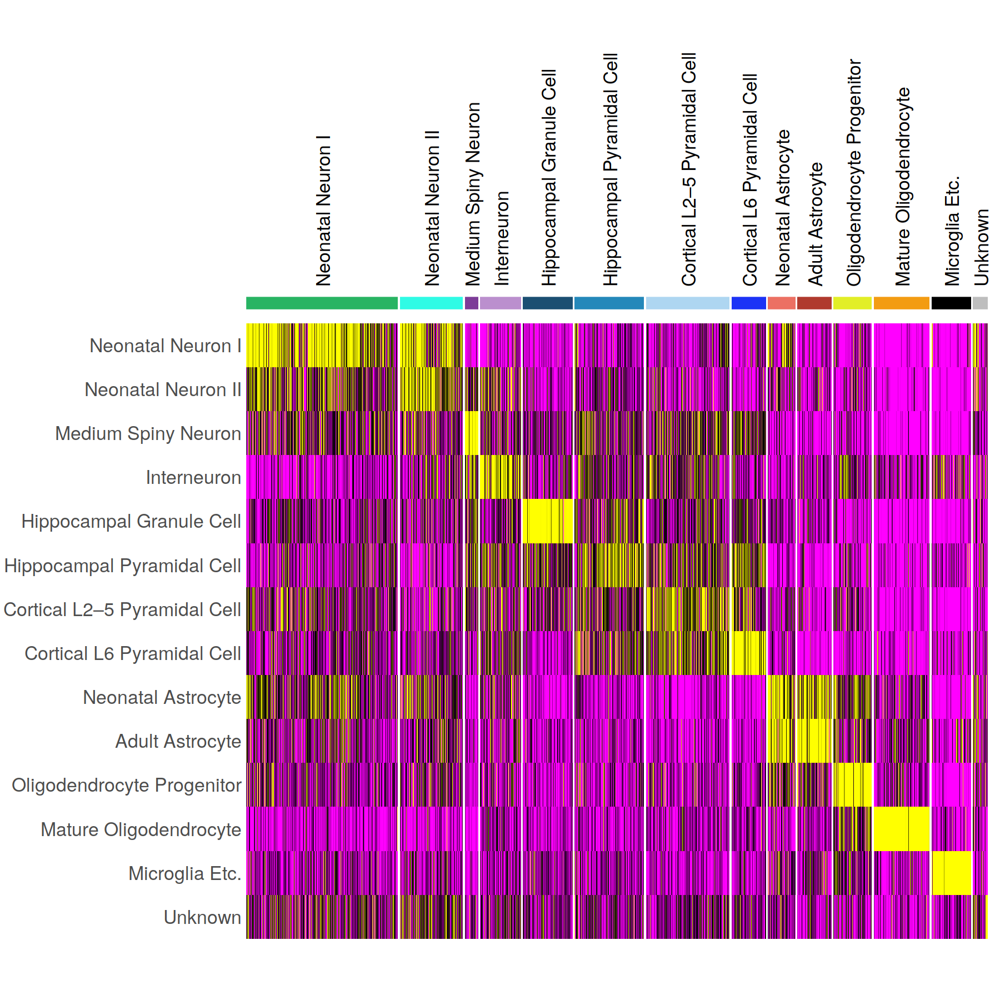

In [63]:
## new neonatal clusters
load(file = "/p/keles/schic/volumeB/Tan2021/rdata_01272022/neonatal_heatmap_objs.RData")

cellTypeList= c("Sub Neonatal 1", "Sub Neonatal 2", 
                 "Medium Spiny Neuron", "Interneuron",
                 "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                 "Cortical L2–5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                 "Neonatal Astrocyte", "Adult Astrocyte",
                 "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                 "Microglia Etc.", "Unknown") #
cellTypeRename = c("Neonatal Neuron I", "Neonatal Neuron II", 
                 "Medium Spiny Neuron", "Interneuron",
                 "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                 "Cortical L2–5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                 "Neonatal Astrocyte", "Adult Astrocyte",
                 "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                 "Microglia Etc.", "Unknown") #

cellTypeColor = c("#28B463", "#2FFBE5", 
                              "#7D3C98", "#BB8FCE",
                              "#1B4F72", "#2488BA",
                              "#AED6F1", "#1C33F6", 
                              "#EC7063", "#B03A2E", 
                              "#E2EE27", "#F39C12", 
                              "#000000", "grey")

options(repr.plot.width=15, repr.plot.height=15)
Idents(seurat_rowmean_top10_heatmap_obj) = factor(Idents(seurat_rowmean_top10_heatmap_obj), levels = cellTypeList, labels = cellTypeRename)
p = DoHeatmap(seurat_rowmean_top10_heatmap_obj, features = cellTypeList, slot = "counts", label = TRUE, group.colors = cellTypeColor, angle = 90, size = 7) + NoLegend() + theme(axis.text.y = element_text(size = 20))
p$data$Feature = factor(p$data$Feature, levels = rev(cellTypeList), labels = rev(cellTypeRename))
newNeonatalGADhm1 = p
saveRDS(newNeonatalGADhm1, file = "/p/keles/schic/volumeB/Tan2021/RDS/newNeonatalGADhm1.rds")
newNeonatalGADhm1

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”


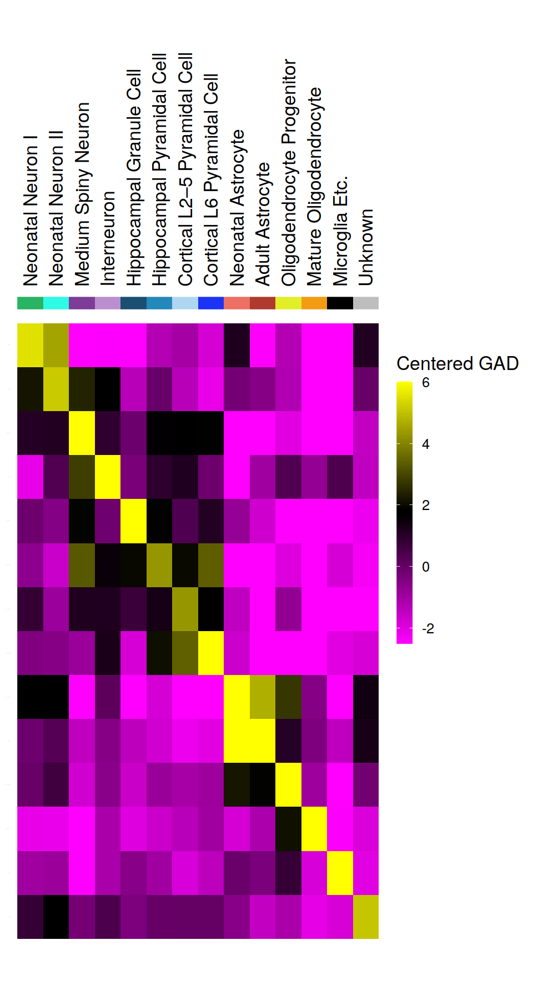

In [64]:
options(repr.plot.width=8, repr.plot.height=15)

load(file = "/p/keles/schic/volumeB/Tan2021/rdata_01272022/neonatal_heatmap_objs.RData")

Idents(seurat_rowcolmean_top10_heatmap_obj) = factor(Idents(seurat_rowcolmean_top10_heatmap_obj), levels = cellTypeList, labels = cellTypeRename)
p = DoHeatmap(seurat_rowcolmean_top10_heatmap_obj, features = cellTypeList, slot = "counts", label = TRUE, group.colors = cellTypeColor, draw.lines = FALSE, size = 7, angle = 90) + 
    theme(axis.text.y = element_text(size = 0), legend.key.height = unit(2, "cm"), legend.text = element_text(size = 15), legend.title = element_text(size = 20)) + guides(colour = FALSE) + labs(fill = "Centered GAD")
p$data$Feature = factor(p$data$Feature, levels = rev(cellTypeList), labels = rev(cellTypeRename))
newNeonatalGADhm2 = p
saveRDS(newNeonatalGADhm2, file = "/p/keles/schic/volumeB/Tan2021/RDS/newNeonatalGADhm2.rds")

newNeonatalGADhm2

In [65]:
pacman::p_load(ggfittext)

In [66]:
options(repr.plot.width=30, repr.plot.height=20)

In [67]:
targetGene_go_result = readRDS(file = "/p/keles/schic/volumeB/Tan2021/RDS/newCluster1_GADgene_GO.rds")
GO_results_sig_genes[["Neonatal_Neuron_I"]] = targetGene_go_result %>% head(10)

targetGene_go_result = readRDS(file = "/p/keles/schic/volumeB/Tan2021/RDS/newCluster2_GADgene_GO.rds")
GO_results_sig_genes[["Neonatal_Neuron_II"]] = targetGene_go_result %>% head(10)


In [68]:
GO_results_sig_genes %>% names
cellTypeNameList = c("Neonatal Neuron I", "Neonatal Neuron II", 
                 "Medium Spiny Neuron", "Interneuron",
                 "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                 "Cortical L2-5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                 "Neonatal Astrocyte", "Adult Astrocyte",
                 "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                 "Microglia Etc.", "Unknown") #%>% gsub(" ", "_", .)
cellTypeNameList

[1] "Neonatal_Astrocyte"           "Neonatal_Neuron_1"           
 [3] "Neonatal_Neuron_2"            "Unknown"                     
 [5] "Oligodendrocyte_Progenitor"   "Microglia_Etc."              
 [7] "Hippocampal_Pyramidal_Cell"   "Cortical_L2-5_Pyramidal_Cell"
 [9] "Mature_Oligodendrocyte"       "Adult_Astrocyte"             
[11] "Interneuron"                  "Cortical_L6_Pyramidal_Cell"  
[13] "Medium_Spiny_Neuron"          "Hippocampal_Granule_Cell"    
[15] "Neonatal_Neuron_I"            "Neonatal_Neuron_II"

[1] "Neonatal Neuron I"            "Neonatal Neuron II"          
 [3] "Medium Spiny Neuron"          "Interneuron"                 
 [5] "Hippocampal Granule Cell"     "Hippocampal Pyramidal Cell"  
 [7] "Cortical L2-5 Pyramidal Cell" "Cortical L6 Pyramidal Cell"  
 [9] "Neonatal Astrocyte"           "Adult Astrocyte"             
[11] "Oligodendrocyte Progenitor"   "Mature Oligodendrocyte"      
[13] "Microglia Etc."               "Unknown"

In [69]:

GO_results_sig_genes[["Cortical_L2-5_Pyramidal_Cell"]]

,category,over_represented_pvalue,under_represented_pvalue,numDEInCat,numInCat,term,ontology
,<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>
6641,GO:0045202,1.548483e-08,1.0000000,78,414,synapse,CC
6116,GO:0043005,4.409656e-08,1.0000000,76,408,neuron projection,CC
9874,GO:0097060,1.258477e-07,1.0000000,41,167,synaptic membrane,CC
1208,GO:0005216,1.795322e-07,1.0000000,32,115,ion channel activity,MF
2971,GO:0015267,2.771204e-07,0.9999999,32,117,channel activity,MF
3879,GO:0022803,2.771204e-07,0.9999999,32,117,passive transmembrane transporter activity,MF
10125,GO:0098793,3.318377e-07,0.9999999,40,167,presynapse,CC
5743,GO:0036477,3.845071e-07,1.0000000,55,273,somatodendritic compartment,CC
3887,GO:0022836,4.029922e-07,0.9999999,27,90,gated channel activity,MF


In [77]:
goPlot = vector("list", length(GO_results_sig_genes))
for(i in 1:length(cellTypeNameList)){
    cT = cellTypeNameList[i] %>% gsub(" ", "_", .)
    goPlot[[i]] =GO_results_sig_genes[[cT]] %>% ggplot(aes(x = reorder(term, -over_represented_pvalue), y = -log10(over_represented_pvalue), label = reorder(term, -over_represented_pvalue))) +
    geom_col(position = "dodge") +
geom_bar_text(position = "dodge", place = "left", reflow = TRUE, grow = FALSE) +
coord_flip() +
xlab("") +
ylab("-log10(p value)") +
theme_bw(base_size = 20) +
theme(axis.text.y = element_blank(), axis.ticks.y = element_blank()) +
guides(size = FALSE) +
ggtitle(cellTypeNameList[i])


}

Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = FALSE)` is deprecated. Please use `guides(<scale> = "none")` instead.”
Warning message:
“`guides(<scale> = F

In [71]:
pdf("/p/keles/schic/volumeA/Figures/GAD_markergene_GO.pdf", width = 30, height = 20)
ggarrange(goPlot[[1]], goPlot[[2]], goPlot[[3]], goPlot[[4]], goPlot[[5]], goPlot[[6]], goPlot[[7]], goPlot[[8]], goPlot[[9]], goPlot[[10]], goPlot[[11]], goPlot[[12]], goPlot[[13]], goPlot[[14]])
dev.off()

png 
  2

In [80]:
GO_results_sig_genes

,category,over_represented_pvalue,under_represented_pvalue,numDEInCat,numInCat,term,ontology
,<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>
9830,GO:0090596,5.586685e-07,0.9999999,20,75,sensory organ morphogenesis,BP
2468,GO:0009887,1.426863e-06,0.9999995,40,240,animal organ morphogenesis,BP
2003,GO:0007423,2.147043e-06,0.9999994,28,141,sensory organ development,BP
885,GO:0003700,2.480188e-06,0.9999993,27,134,DNA-binding transcription factor activity,MF
7341,GO:0048598,4.425812e-06,0.9999987,25,122,embryonic morphogenesis,BP
6365,GO:0043583,5.033514e-06,0.9999990,16,58,ear development,BP
7441,GO:0048839,5.495078e-06,0.9999990,15,52,inner ear development,BP
7302,GO:0048513,6.743883e-06,0.9999968,75,613,animal organ development,BP
6623,GO:0045165,1.018143e-05,0.9999983,13,42,cell fate commitment,BP


In [81]:
# goPlot = vector("list", length(GO_results_all_genes))
# cellTypeNameList2 = c(cellTypeNameList, "Unknown")
# for(i in 1:length(cellTypeNameList2)){
#     cT = cellTypeNameList2[i]
#     goPlot[[i]] =GO_results_all_genes[[cT]] %>% ggplot(aes(x = reorder(term, -over_represented_pvalue), y = -log10(over_represented_pvalue), label = reorder(term, -over_represented_pvalue))) +
#     geom_col(position = "dodge") +
# geom_bar_text(position = "dodge", place = "left", reflow = TRUE, grow = FALSE) +
# coord_flip() +
# xlab("") +
# ylab("-log10(p value)") +
# theme_bw(base_size = 20) +
# theme(axis.text.y = element_blank(), axis.ticks.y = element_blank()) +
# guides(size = FALSE) +
# ggtitle(cT)
# }
# ggarrange(goPlot[[1]], goPlot[[2]], goPlot[[3]], goPlot[[4]], goPlot[[5]], goPlot[[6]], goPlot[[7]], goPlot[[8]], goPlot[[9]], goPlot[[10]], goPlot[[11]], goPlot[[12]], goPlot[[13]], goPlot[[14]])

Oligodendrocyte Progenitor is related to chondroitin sulfate. (https://en.wikipedia.org/wiki/Oligodendrocyte_progenitor_cell)

Microglia is related to immune system.

Hippocampal pyramidal: (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2269937/#:~:text=Potassium%20channels%20located%20in%20the,postsynaptic%20potentials%20and%20dendritic%20excitability.)

Cortical_L2-5_Pyramidal_Cell: The first GO term is "central nervous system neuron differentiation"

Mature_Oligodendrocyte: Golgi in the GO terms is a sensory neuron. It is also related to potassium mentioned in the GO. (https://elifesciences.org/articles/34829)

Adult_Astrocyte: one of the functino of Astrocytes is "regulation of cerebral blood flow" and it is mentioned in the GO (celebellar). Also, all the GO terms in this are related to neuron cells.

Interneuron: potassium channel shows up, but didn't spot other factors.

Medium_Spiny_Neuron:contains small rounded vesicles. (https://www.sciencedirect.com/topics/neuroscience/medium-spiny-neuron)

Hippocampal_Granule_Cell: "Calcium dynamics are essential for several functions of granule cells such as changing membrane potential, synaptic plasticity, apoptosis, and regulation of gene transcription." (https://en.wikipedia.org/wiki/Granule_cell#:~:text=Granule%20cells%20are%20found%20within,bulb%2C%20and%20the%20cerebral%20cortex.&text=These%20granule%20cells%20receive%20excitatory,fibers%20originating%20from%20pontine%20nuclei.)

In [82]:
pacman::p_load(GeneOverlap)
pacman::p_load(VennDiagram)

In [83]:
# Overlap between tan2021 and our marker genes.
load(file = "/p/keles/schic/volumeB/Tan2021/rdata_01272022/detected_markergenes_control.RData")
load("/p/keles/schic/volumeB/Tan2021/Tan2021_results.RData")
load(file = "/p/keles/schic/volumeB/Tan2021/RNA_SeuratObj.RData")

In [84]:
options(repr.plot.width=12, repr.plot.height=12)

In [85]:
cellTypeList = c("Neonatal Neuron 1", "Neonatal Neuron 2", 
                 "Medium Spiny Neuron", "Interneuron",
                 "Hippocampal Granule Cell", "Hippocampal Pyramidal Cell", 
                 "Cortical L2–5 Pyramidal Cell", "Cortical L6 Pyramidal Cell", 
                 "Neonatal Astrocyte", "Adult Astrocyte",
                 "Oligodendrocyte Progenitor", "Mature Oligodendrocyte", 
                 "Microglia Etc.") #, "Unknown"

cellTypeNameList = gsub(" ", "_", cellTypeList)
cellTypeNameList[7] = names(gene_lists)[2]

In [86]:
names(gene_lists)[2] == cellTypeNameList[7]

[1] TRUE

In [87]:
names(gene_lists) %>% unique

[1] "Adult_Astrocyte"              "Cortical_L2-5_Pyramidal_Cell"
 [3] "Cortical_L6_Pyramidal_Cell"   "Hippocampal_Granule_Cell"    
 [5] "Hippocampal_Pyramidal_Cell"   "Interneuron"                 
 [7] "Mature_Oligodendrocyte"       "Medium_Spiny_Neuron"         
 [9] "Microglia_Etc."               "Neonatal_Astrocyte"          
[11] "Neonatal_Neuron_1"            "Neonatal_Neuron_2"           
[13] "Neuron"                       "Oligodendrocyte_Progenitor"

In [18]:
cellTypeNameList %>% length

[1] 13

In [74]:
tan = gene_lists[[cellTypeNameList[i]]]
markers = rownames(pbmc.markers)[pbmc.markers$cluster == cellTypeList[i]]
tan %>% length
markers %>% length

[1] 52

[1] 33

[1] "Mature_Oligodendrocyte"

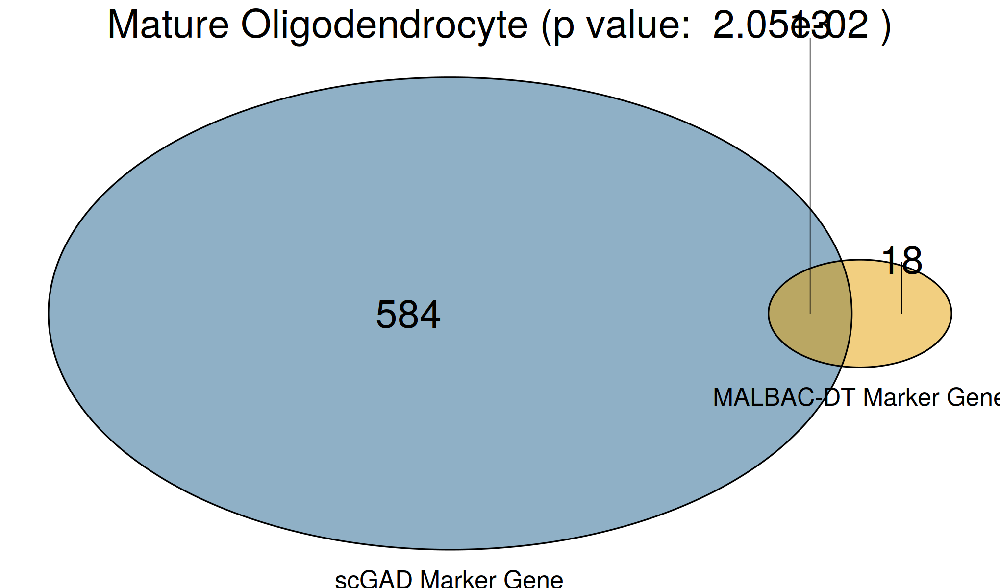

In [88]:
options(repr.plot.width=17, repr.plot.height=10)
i = 12
cellTypeNameList[i]
tan = gene_lists[[cellTypeNameList[i]]]
markers = rownames(pbmc.markers)[pbmc.markers$cluster == cellTypeList[i]]
input = list(tan, markers)

go.obj = newGeneOverlap(tan, markers, genome.size = 2483)
go.obj = testGeneOverlap(go.obj)
pval = formatC(go.obj@pval, format = "e", digits = 2)
    grid.newpage()

vennObj = venn.diagram(x = input, filename = NULL, imagetype = "svg", cex = 4, cat.cex = 2.5, cat.pos = c(0.1, 0.1), cat.default.pos = "outer", fill = c("#E69F00", "#1F618D"), 
                       category.names = c("MALBAC-DT Marker Gene", "scGAD Marker Gene"), scaled = TRUE, rotation.degree = 0, 
                       sub = paste(cellTypeList[i], "(p value: ", pval, ")"), sub.cex =4, sub.pos = c(0.5, 1), force.unique = TRUE, height = 4000, width = 6500)

grid.draw(vennObj)


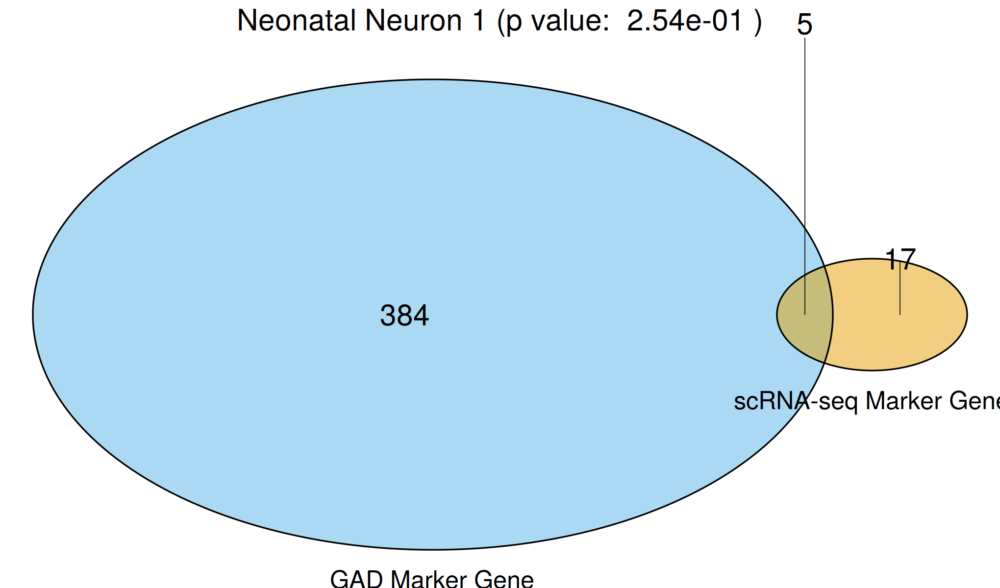

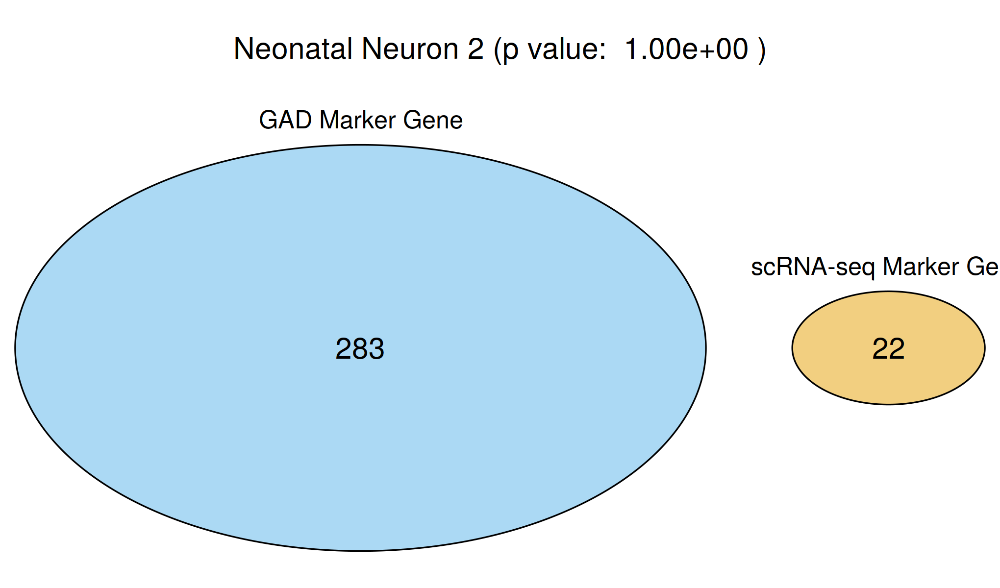

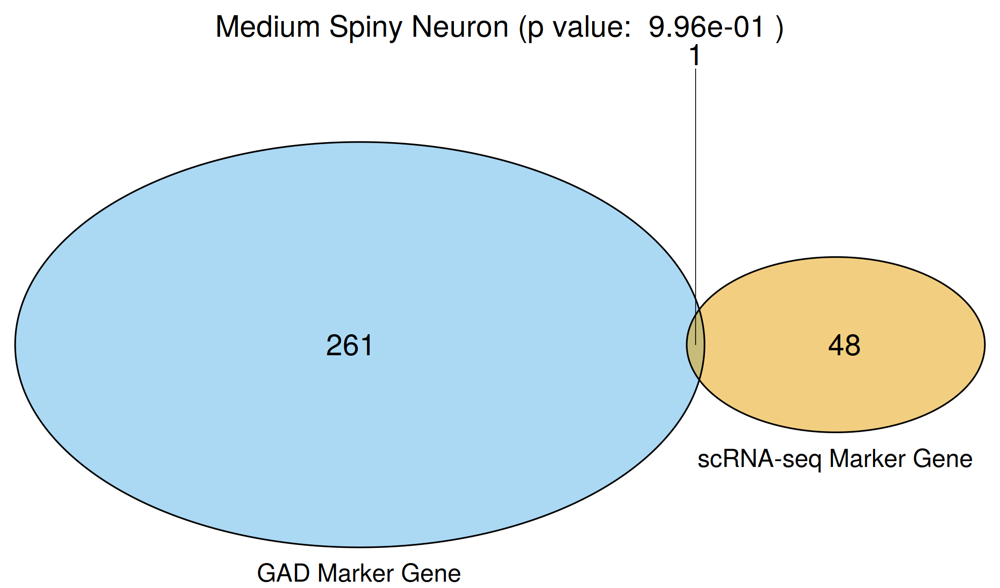

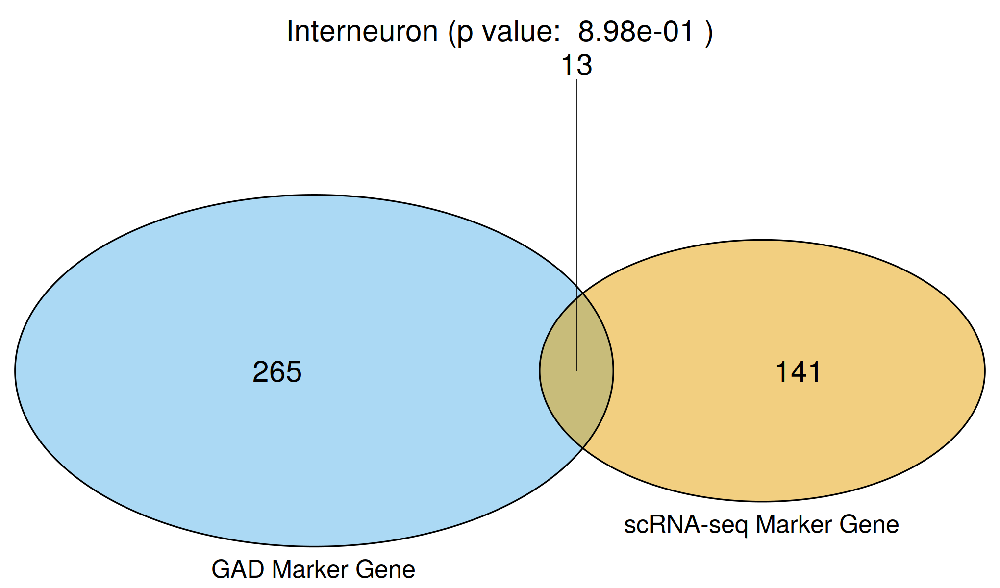

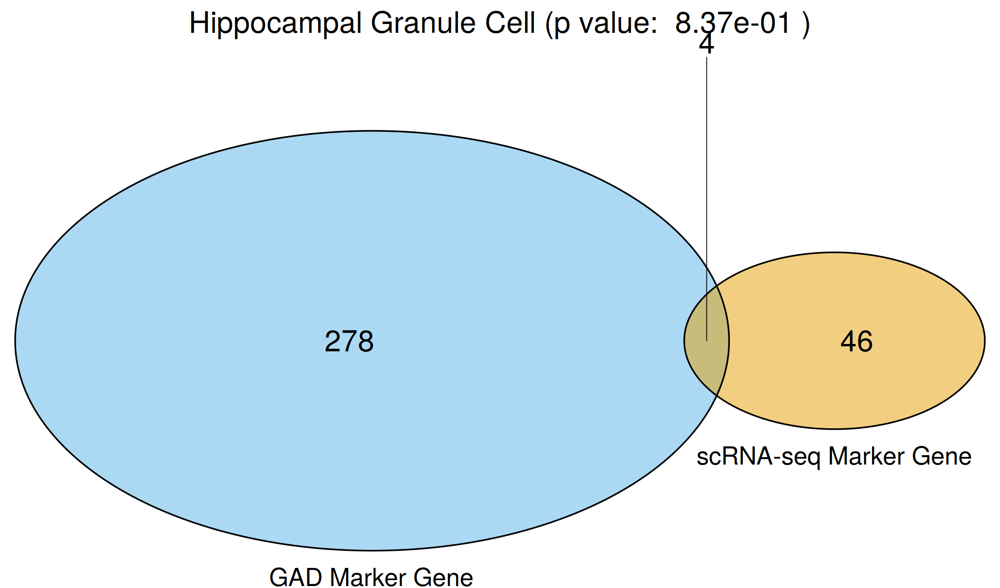

...

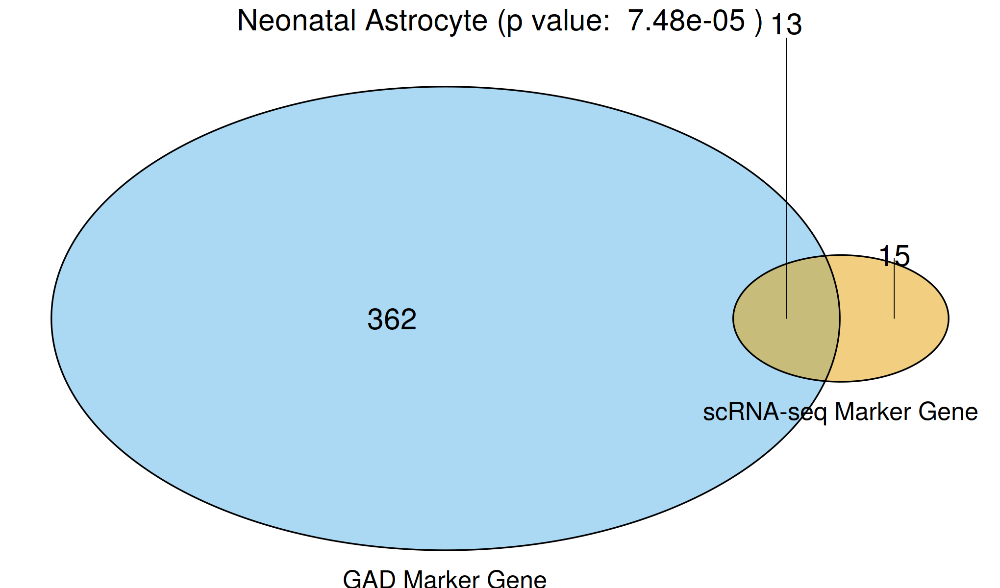

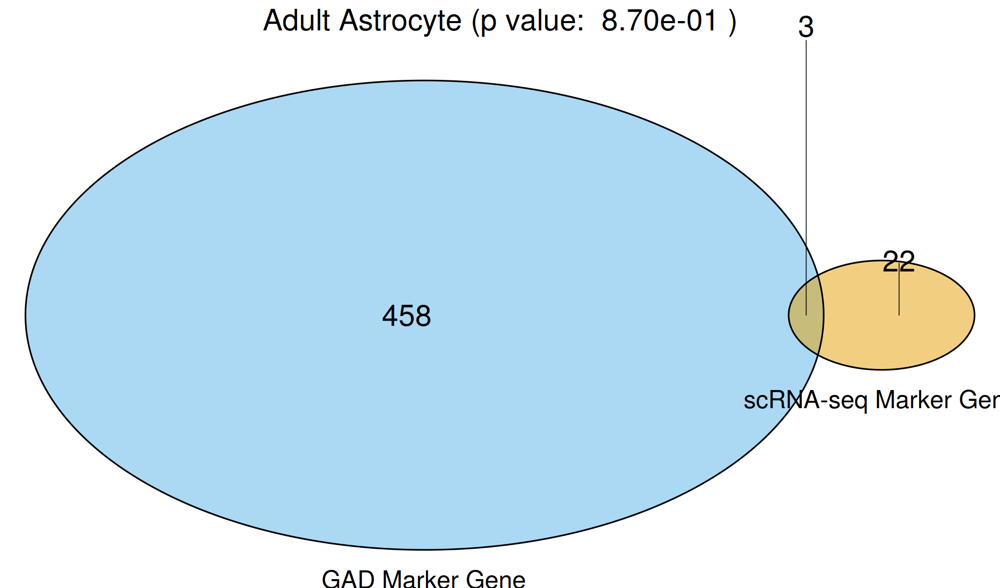

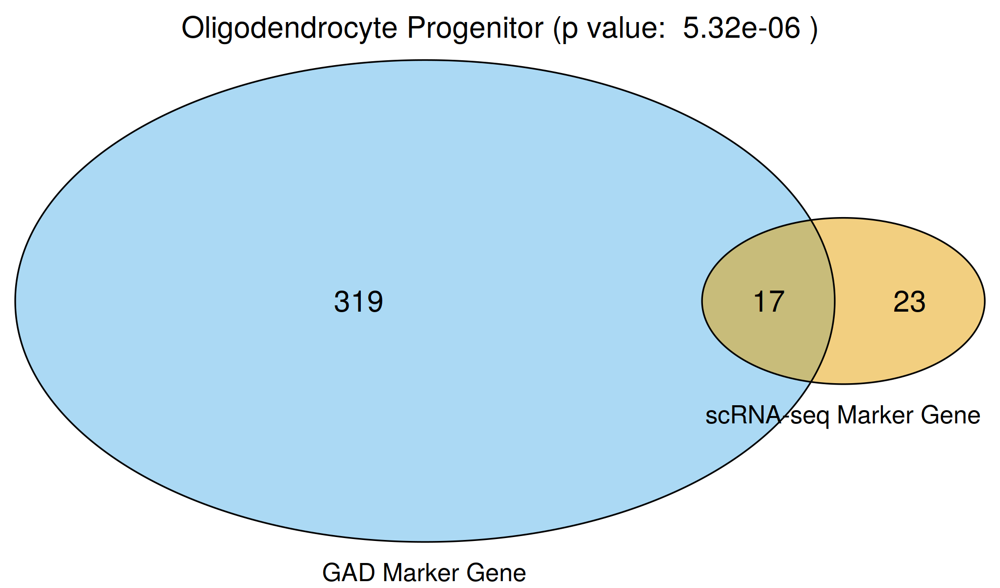

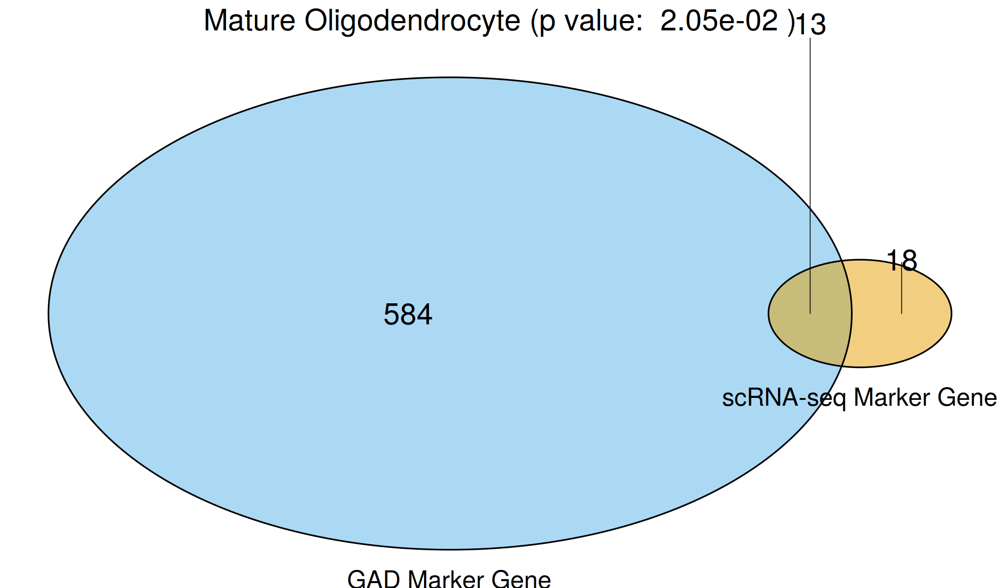

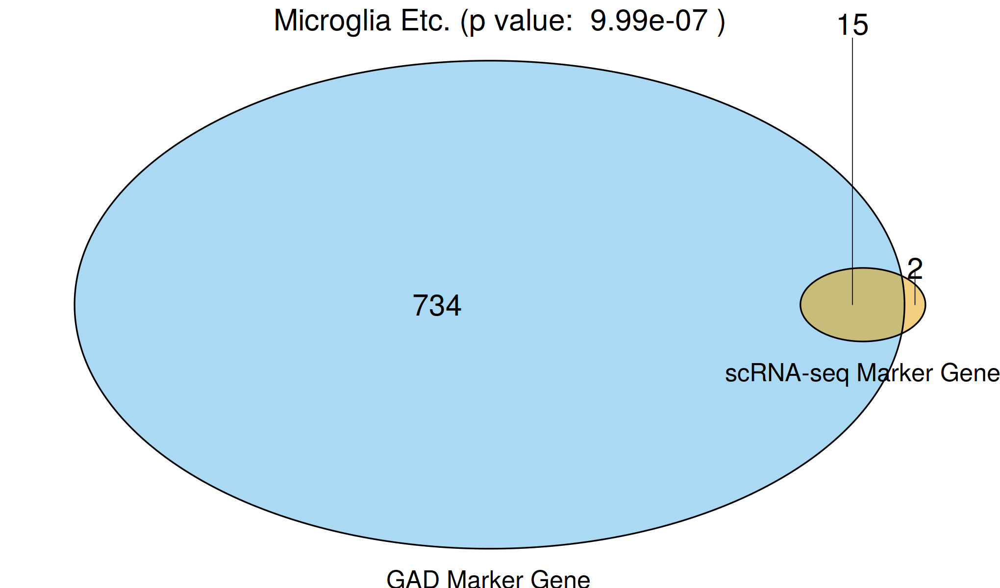

In [89]:
for(i in 1:length(cellTypeList)){

    tan = gene_lists[[cellTypeNameList[i]]]
markers = rownames(pbmc.markers)[pbmc.markers$cluster == cellTypeList[i]]
input = list(tan, markers)

go.obj = newGeneOverlap(tan, markers, genome.size = 2483)
go.obj = testGeneOverlap(go.obj)
pval = formatC(go.obj@pval, format = "e", digits = 2)
    grid.newpage()

vennObj = venn.diagram(x = input, filename = NULL, cex = 3, cat.cex = 2.5, cat.pos = c(0.1, 0.1), cat.default.pos = "outer", fill = c("#E69F00", "#56B4E9"), 
                       category.names = c("scRNA-seq Marker Gene", "GAD Marker Gene"), scaled = TRUE, rotation.degree = 0, 
                       sub = paste(cellTypeList[i], "(p value: ", pval, ")"), sub.cex =3, sub.pos = c(0.5, 1), force.unique = TRUE)

grid.draw(vennObj)

}

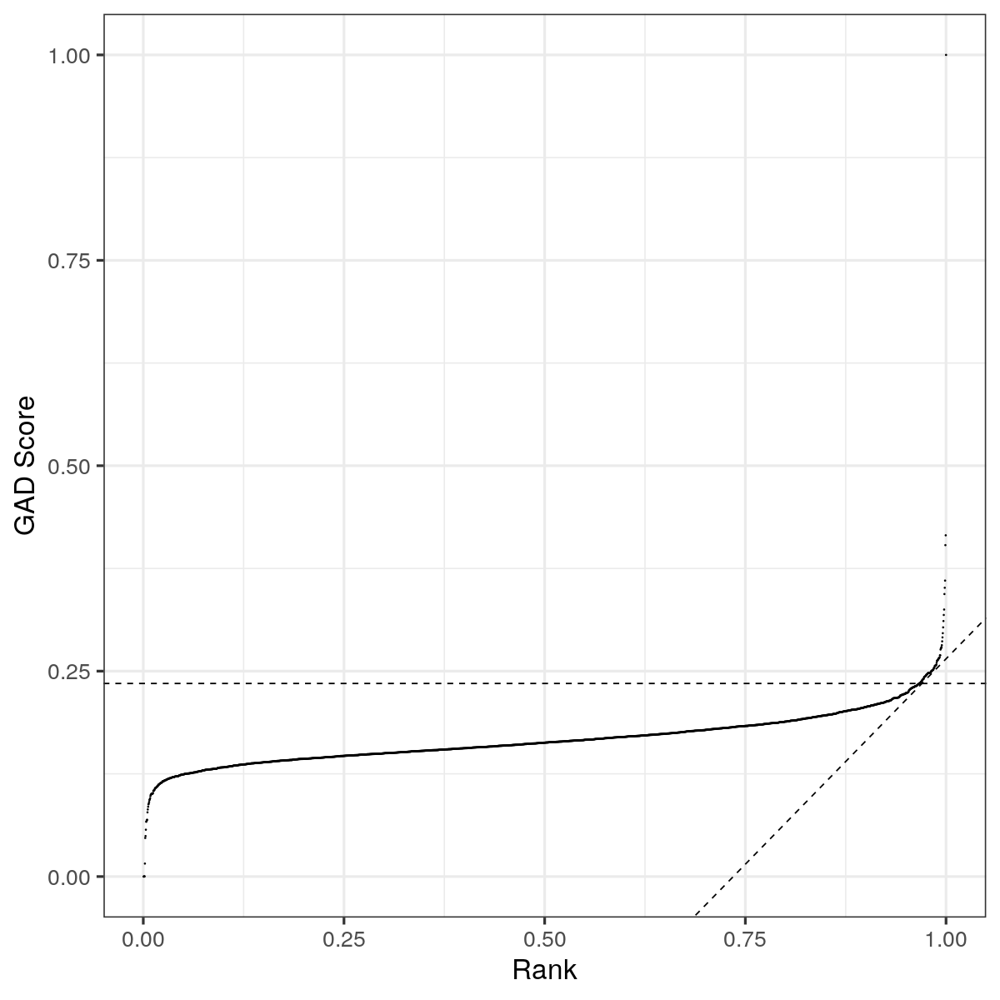

In [5]:
options(repr.plot.width=10, repr.plot.height=10)
## GAD Enriched gene per cell type
gadAllData = data.frame(rank = 1:ncol(GADgeneAll), GAD = colMeans(GADgeneAll) %>% sort)

gadAllData %>% ggplot(aes(x = rank/max(rank), y = GAD/max(GAD))) +
geom_point(size = 0.1) +
geom_abline(slope = 1, intercept = -0.735, linetype = "dashed") +
geom_hline(yintercept = 0.235,linetype = "dashed") +
theme_bw(base_size = 20) +
xlab("Rank") +
ylab("GAD Score")

In [7]:
gadThres = 0.235*max(gadAllData$GAD)
0.235*max(gadAllData$GAD)

[1] 1.638259

In [ ]:
GADenrichGene = c()
for(cT in unique(cell_info$`cell-type cluster`)){
    print(cT)
    cellInd = which(cell_info$`cell-type cluster` == cT)
    for(i in 1:ncol(GADgeneAll)){
        GADenrichGene = data.frame(pVal = wilcox.test(GADgeneAll[cellInd, i], mu = gadThres, alternative = "greater")$p.value, gene = colnames(GADgeneAll)[i], cellType = cT) %>% rbind(GADenrichGene)

    }
}

In [15]:
GADenrichGene %>% filter(pVal <= 0.05) %>% group_by(cellType) %>% summarize(N = n())
GADenrichGeneSig = GADenrichGene %>% filter(pVal <= 0.05)
head(GADenrichGeneSig %>% filter(cellType == "Microglia Etc.") %>% arrange(pVal))

,cellType,N
,<chr>,<int>
1,Adult Astrocyte,54
2,Cortical L2–5 Pyramidal Cell,43
3,Cortical L6 Pyramidal Cell,41
4,Hippocampal Granule Cell,62
5,Hippocampal Pyramidal Cell,27
6,Interneuron,41
7,Mature Oligodendrocyte,123
8,Medium Spiny Neuron,51
9,Microglia Etc.,93


,pVal,gene,cellType
,<dbl>,<chr>,<chr>
1,3.690650e-19,Tg,Microglia Etc.
2,6.143016e-18,Chd9,Microglia Etc.
3,9.138398e-16,Entpd1,Microglia Etc.
4,2.008021e-15,Mertk,Microglia Etc.
5,2.563110e-15,Ldlrad4,Microglia Etc.
6,5.051569e-15,Sipa1l1,Microglia Etc.


In [14]:
GADenrichGene %>% filter(cellType == "Microglia Etc.", gene == "Pard3b")

pVal,gene,cellType
<dbl>,<chr>,<chr>
0.6174733,Pard3b,Microglia Etc.


In [9]:
## save(all_genes, top10_genes, sig_genes, file = "/p/keles/schic/volumeB/Tan2021/detected_markergenes_control_all_top10_sig.RData")
load(file = "/p/keles/schic/volumeB/Tan2021/detected_markergenes_control_all_top10_sig.RData")
load("/p/keles/schic/volumeB/Tan2021/heatmap_objs.RData")

ls()

[1] "all"                                 "all_genes"                          
 [3] "all_marker_genes"                    "alls"                               
 [5] "cell"                                "cell_info"                          
 [7] "cellInd"                             "cT"                                 
 [9] "eb"                                  "gadAllData"                         
[11] "GADenrichGene"                       "GADgeneAll"                         
[13] "gadThres"                            "gene_lists"                         
[15] "GO_results_all_genes"                "GO_results_sig_genes"               
[17] "i"                                   "k"                                  
[19] "mean_gad_score_boxplot"              "names"                              
[21] "paths"                               "pbmc.markers"                       
[23] "pheatmap_mat"                        "read_excels"                        
[25] "resTSNE"                             "resUMAP"                            
[27] "RNA_SeuratObj"                       "RNA_SeuratObj_sub"                  
[29] "sc_gad_score_boxplot"                "seurat_heatmap_obj"                 
[31] "seurat_mean_heatmap_obj"             "seurat_rowcolmean_heatmap_obj"      
[33] "seurat_rowcolmean_sig_heatmap_obj"   "seurat_rowcolmean_top10_heatmap_obj"
[35] "seurat_rowmean_heatmap_obj"          "seurat_rowmean_sig_heatmap_obj"     
[37] "seurat_rowmean_top10_heatmap_obj"    "sig_genes"                          
[39] "summary"                             "temp"                               
[41] "top10_genes"                         "tsne_embedding"                     
[43] "umap_embedding"

In [16]:
sig_genes %>% group_by(cluster) %>% summarize(N = n()) 

sig_genes  %>% filter(cluster == "Microglia Etc.") %>% mutate(rank = order(p_val, decreasing = F)) %>% head
sig_genes  %>% filter(cluster == "Microglia Etc.") %>% mutate(rank = order(p_val, decreasing = F)) %>% filter(gene %in% c("Pard3b", "Agmo", "Ttc28", "Dock8", "Maml3", "Man1c1", "Entpd1"))
sig_genes %>% filter(cluster == "Mature Oligodendrocyte")  %>% mutate(rank = order(p_val, decreasing = F)) %>% filter(gene %in% c("Ano4", "Pde4b", "Usp6nl"))

,cluster,N
,<fct>,<int>
1,Neonatal Astrocyte,25
2,Neonatal Neuron 1,5
3,Neonatal Neuron 2,5
4,Unknown,4
5,Oligodendrocyte Progenitor,64
6,Microglia Etc.,227
7,Hippocampal Pyramidal Cell,6
8,Cortical L2–5 Pyramidal Cell,32
9,Mature Oligodendrocyte,212


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,rank
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<int>
Fhit,8.240916e-54,0.3907612,1,1.000,2.046219e-50,Microglia Etc.,Fhit,1
Hivep3,8.575343e-53,0.8016381,1,1.000,2.129258e-49,Microglia Etc.,Hivep3,2
Ttc28,1.843538e-51,1.1244579,1,1.000,4.577506e-48,Microglia Etc.,Ttc28,3
Nav3,5.898251e-50,0.4370418,1,1.000,1.464536e-46,Microglia Etc.,Nav3,4
Arhgap24,5.321935e-49,0.8326334,1,1.000,1.321436e-45,Microglia Etc.,Arhgap24,5
Tg,7.082324e-48,1.1593532,1,0.999,1.758541e-44,Microglia Etc.,Tg,6


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,rank
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<int>
Ttc28,1.843538e-51,1.1244579,1,1.000,4.577506e-48,Microglia Etc.,Ttc28,3
Entpd1,1.284505e-44,1.3440528,1,0.996,3.189425e-41,Microglia Etc.,Entpd1,9
Pard3b,6.591297e-42,0.5297571,1,1.000,1.636619e-38,Microglia Etc.,Pard3b,12
Dock8,8.860674e-39,0.9643918,1,0.998,2.200105e-35,Microglia Etc.,Dock8,16
Agmo,9.020684e-34,0.3763641,1,1.000,2.239836e-30,Microglia Etc.,Agmo,26
Maml3,6.618418e-29,0.3185340,1,1.000,1.643353e-25,Microglia Etc.,Maml3,38
Man1c1,1.143389e-16,0.5849646,1,0.997,2.839035e-13,Microglia Etc.,Man1c1,94


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,rank
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<int>
Ano4,1.263174e-74,0.9852082,1,1.000,3.136460e-71,Mature Oligodendrocyte,Ano4,1
Pde4b1,2.827670e-68,0.7079863,1,1.000,7.021104e-65,Mature Oligodendrocyte,Pde4b,2
Usp6nl,4.833539e-36,0.9678014,1,0.987,1.200168e-32,Mature Oligodendrocyte,Usp6nl,32


In [10]:
## Both specific and enriched GAD genes
GADboth = inner_join(GADenrichGeneSig, sig_genes, by = c("cellType" = "cluster", "gene")) 
GADboth %>% group_by(cellType) %>% summarize(N = n())
head(GADboth)

,cellType,N
,<chr>,<int>
1,Adult Astrocyte,34
2,Cortical L2–5 Pyramidal Cell,8
3,Cortical L6 Pyramidal Cell,11
4,Hippocampal Granule Cell,20
5,Hippocampal Pyramidal Cell,2
6,Interneuron,6
7,Mature Oligodendrocyte,95
8,Medium Spiny Neuron,11
9,Microglia Etc.,78


,pVal,gene,cellType,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,5.713088e-04,Slit1,Hippocampal Granule Cell,7.029598e-15,0.4119172,1.000,0.991,1.745449e-11
2,8.801789e-06,Sorbs1,Hippocampal Granule Cell,5.361115e-15,0.3411987,1.000,0.998,1.331165e-11
3,3.977469e-05,Htr4,Hippocampal Granule Cell,4.619816e-11,0.2981335,1.000,0.987,1.147100e-07
4,9.562015e-16,Ablim3,Hippocampal Granule Cell,4.384628e-18,0.4819078,0.993,0.993,1.088703e-14
5,6.842296e-15,Rbfox2,Hippocampal Granule Cell,6.719255e-10,0.2529598,1.000,0.999,1.668391e-06
6,1.446881e-22,Adcy2,Hippocampal Granule Cell,3.808456e-20,0.3961652,1.000,1.000,9.456395e-17


In [11]:
## GAD specific and enriched but not in scRNA marker gene list
load("/p/keles/schic/volumeB/Tan2021/Tan2021_results.RData")
GADonly = c()
for(cT in unique(GADboth$cellType)){
    
    GADonly = GADboth %>% filter(cellType == cT, !gene %in% gene_lists[[cT]]) %>% rbind(GADonly)
}
GADonly %>% group_by(cellType) %>% summarize(N = n())
head(GADonly)

,cellType,N
,<chr>,<int>
1,Adult Astrocyte,34
2,Cortical L2–5 Pyramidal Cell,8
3,Cortical L6 Pyramidal Cell,11
4,Hippocampal Granule Cell,20
5,Hippocampal Pyramidal Cell,2
6,Interneuron,4
7,Mature Oligodendrocyte,95
8,Medium Spiny Neuron,11
9,Microglia Etc.,78


,pVal,gene,cellType,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,4.724132e-03,Fam129a,Neonatal Astrocyte,3.403474e-06,0.2694711,1,0.996,8.450827e-03
2,1.266555e-02,Bcl2,Neonatal Astrocyte,1.254011e-09,0.3869707,1,0.997,3.113709e-06
3,1.216811e-42,Zfp697,Neonatal Neuron 1,2.886551e-45,0.3671831,1,1.000,7.167307e-42
4,2.086148e-10,Usp29,Neonatal Neuron 2,3.255804e-12,0.2890774,1,0.997,8.084163e-09
5,1.493697e-15,Dnah10,Neonatal Neuron 2,1.805569e-08,0.2624623,1,0.981,4.483228e-05
6,4.423899e-30,Zfp697,Neonatal Neuron 2,6.023694e-28,0.3253352,1,1.000,1.495683e-24


In [12]:
save(GADonly, GADboth, sig_genes, GADenrichGeneSig, file = "/p/keles/schic/volumeB/Tan2021/RData/GADonly_GADboth_sig_genes_GADenrichGeneSig.RData")

In [17]:
load("/p/keles/schic/volumeB/Tan2021/RNA_SeuratMarkers.RData")
major_cellTypes %>%  filter(cluster == "Microglia Etc.") %>% mutate(rank = order(p_val), padj = p.adjust(p_val, method = "BH")) %>% filter(tolower(gene) %in% c("pard3b", "agmo", "ttc28", "dock8", "maml3", "man1c1", "entpd1"))
major_cellTypes  %>% filter(cluster == "Mature Oligodendrocyte") %>% mutate(rank = order(p_val), padj = p.adjust(p_val, method = "BH")) %>% filter(gene %in% c("Ano4", "Pde4b", "Usp6nl"))

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,rank,padj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<int>,<dbl>
Dock8,1.308413e-219,1.1494802,0.396,0.012,3.932565e-215,Microglia Etc.,Dock8,74,7.348329e-218
Entpd1,2.733432e-196,1.3525119,0.451,0.029,8.215603e-192,Microglia Etc.,Entpd1,85,1.336487e-194
Maml3.8,2.108263e-47,1.1560763,0.538,0.237,6.336594e-43,Microglia Etc.,Maml3,611,1.434033e-46
Agmo,2.206654e-40,0.3336360,0.129,0.014,6.632318e-36,Microglia Etc.,Agmo,781,1.174245e-39
Man1c1.2,1.512384e-16,0.5585266,0.242,0.106,4.545620e-12,Microglia Etc.,Man1c1,2392,2.627703e-16


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,rank,padj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<int>,<dbl>
Ano4.4,5.108560e-80,1.5928028,0.697,0.277,1.535429e-75,Mature Oligodendrocyte,Ano4,176,1.273076e-78
Pde4b.5,2.291119e-60,1.2004387,0.583,0.229,6.886188e-56,Mature Oligodendrocyte,Pde4b,257,3.910058e-59
Usp6nl.1,7.343783e-07,0.4030043,0.245,0.152,2.207247e-02,Mature Oligodendrocyte,Usp6nl,4102,7.852226e-07


In [28]:
#Preparing for hic result
load("/p/keles/schic/volumeB/Tan2021/detected_markergenes_control.RData")

paths = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control/", full.names = TRUE)
names = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control/")
temp = fread(paths[1])
temp$V1[duplicated(temp$V1)] = 'Pcdha11_d'
all = matrix(0, nrow = nrow(temp), ncol = length(paths))
for (k in 1:length(names)){
    cell = fread(paths[k])
    all[, k] = cell$V2
}
rownames(all) = temp$V1
colnames(all) = names
all[is.na(all)] = 0
all[is.infinite(all)] = 0
all = t(all)
all[all < 1.5] = NA

In [29]:
load(file = "/p/keles/schic/volumeB/Tan2021/RData/GADonly_GADboth_sig_genes_GADenrichGeneSig.RData")

In [89]:
targetCT = "Microglia Etc."
rnaD = c()
gadD = c()
RNA_logCount = log(RNA_SeuratObj@assays$RNA@counts + 1)
RNA_logCount[RNA_logCount <= 0] = NA
targetGeneList = c("Entpd1", "Dock8", "Fli1", "Pard3b", "Fat3", "Hivep3", "Ttc28", "Arhgap24", "Spata13", "Sgms1", "Slc4a10", "Pid1", "Nhs", "Dapk1", "Itga9", "Agmo", "Maml3", "Rhobtb1", "Tec", "Elf1", "Man1c1") #c("Syt1", "Tiam1", "Epha6", "Ccdc85a", "Slc2a13", "Cemip", "Myo5b", "Trpc6", "Rasgrf2") #GADonly %>% filter(cellType == targetCT) %>% top_n(20, wt = pVal) %$% gene
options(repr.plot.width=8, repr.plot.height=9*length(targetGeneList))

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
    rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
            cbind(rnaUMAPD, .) %>% dplyr::select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            dplyr::select(X1, X2, cellType, score = gene, type, targetGene)
    
    rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}


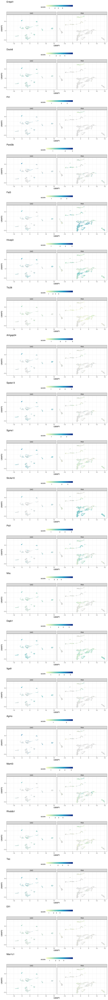

In [35]:
options(repr.plot.width=16, repr.plot.height=7*length(targetGeneList))

genePlot = vector("list", length(targetGeneList))
for(i in 1:length(targetGeneList)){
    tG = targetGeneList[i] #c("Pard3b", "Spata13", "Entpd1", "Dock8", "Agmo")[i]
   genePlot[[i]] = rbind(rnaD, gadD) %>% dplyr::filter(targetGene == tG, is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene == tG, !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.5) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5))+
    facet_wrap(~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    ggtitle(tG) +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
}
ggarrange(genePlot[[1]], genePlot[[2]], genePlot[[3]], genePlot[[4]], genePlot[[5]], genePlot[[6]], genePlot[[7]], genePlot[[8]], genePlot[[9]], genePlot[[10]], genePlot[[11]], genePlot[[12]], genePlot[[13]], genePlot[[14]], genePlot[[15]], genePlot[[16]], genePlot[[17]], genePlot[[18]], genePlot[[19]],genePlot[[20]], genePlot[[21]], ncol = 1, nrow =length(targetGeneList)) #

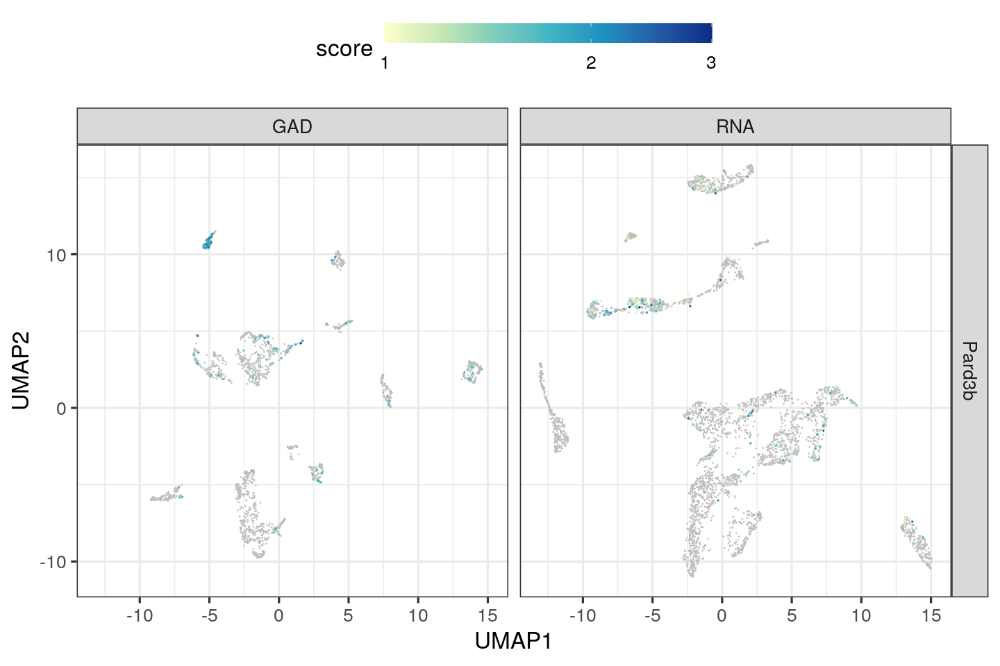

In [439]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneM1 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Pard3b"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Pard3b"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.3) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 3) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))

gadUMAPgeneM1

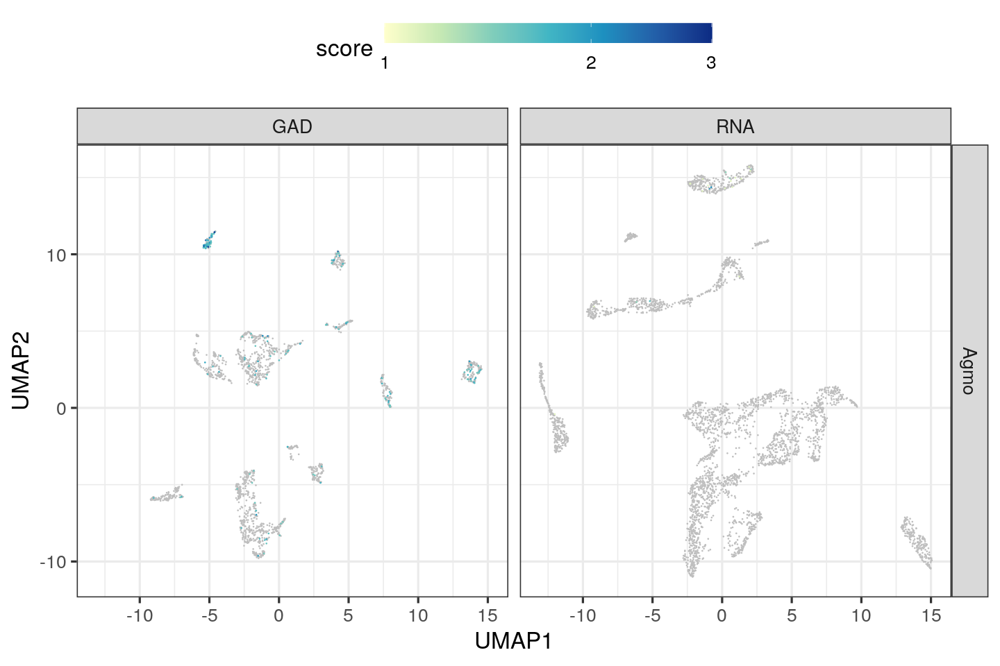

In [91]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneM2 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Agmo"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Agmo"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.1) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 3) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
gadUMAPgeneM2

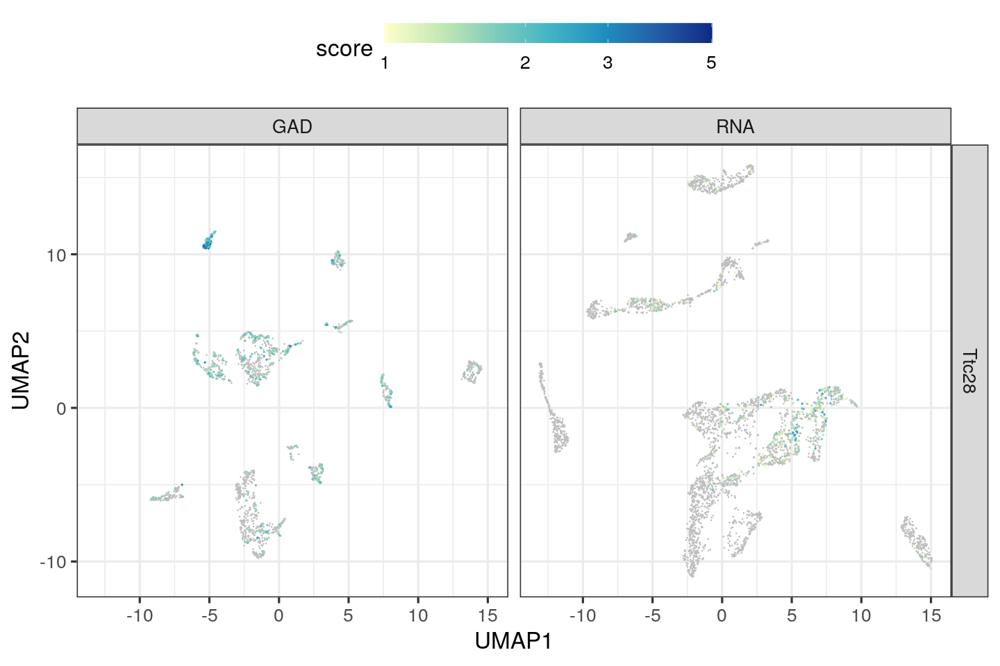

In [37]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneM3 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Ttc28"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Ttc28"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.3) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 5) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
gadUMAPgeneM3

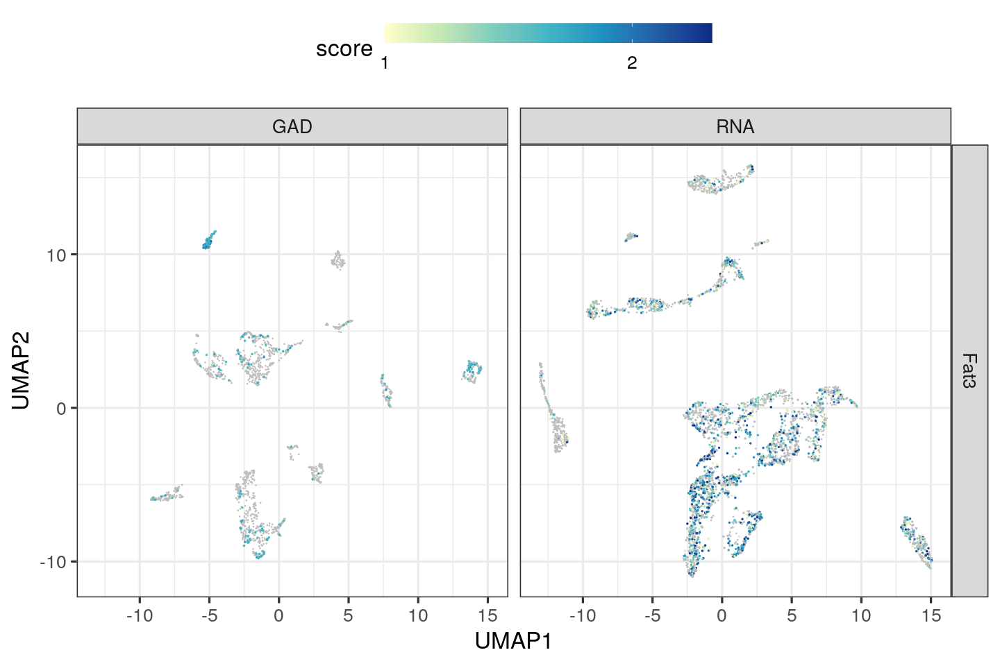

In [442]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneM4 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Fat3"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Fat3"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.3) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 2.5) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
gadUMAPgeneM4

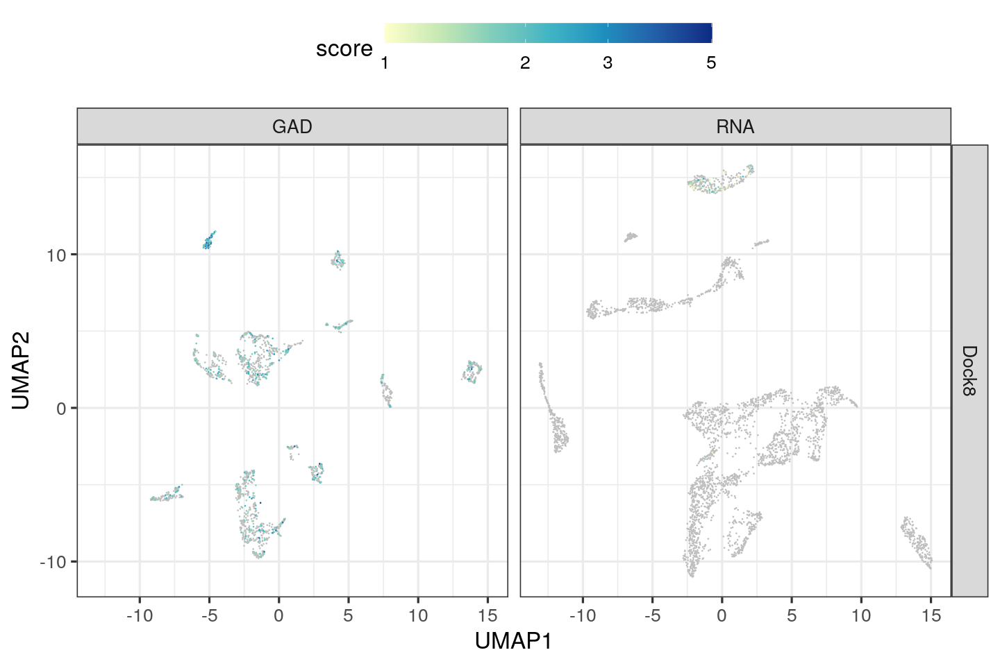

In [96]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneM5 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Dock8"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Dock8"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.1) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 5) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
gadUMAPgeneM5

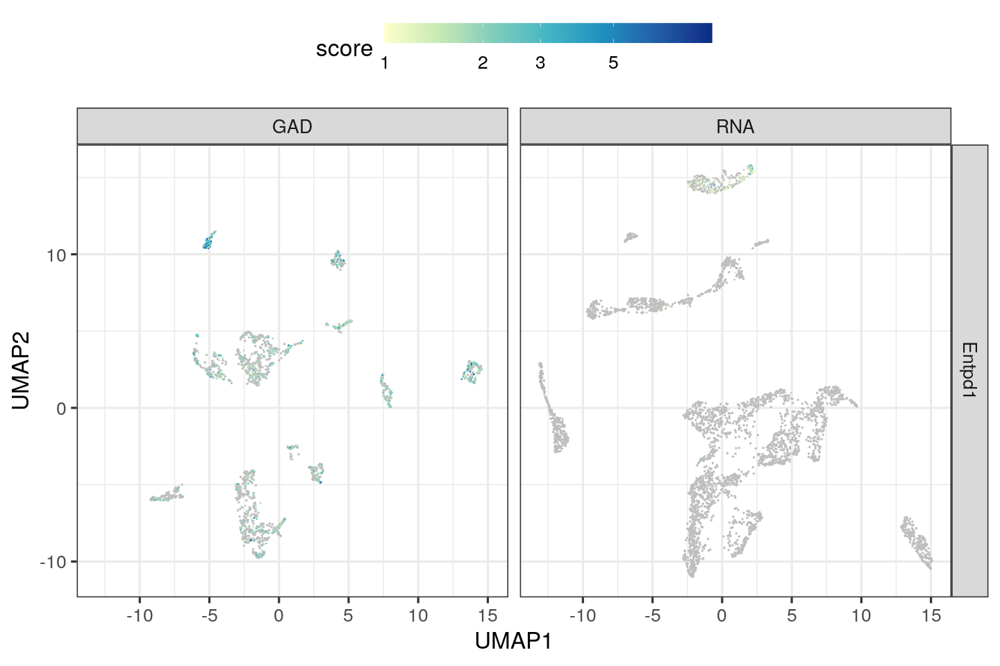

In [94]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneM6 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Entpd1"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.3) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Entpd1"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.1) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 10) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
gadUMAPgeneM6

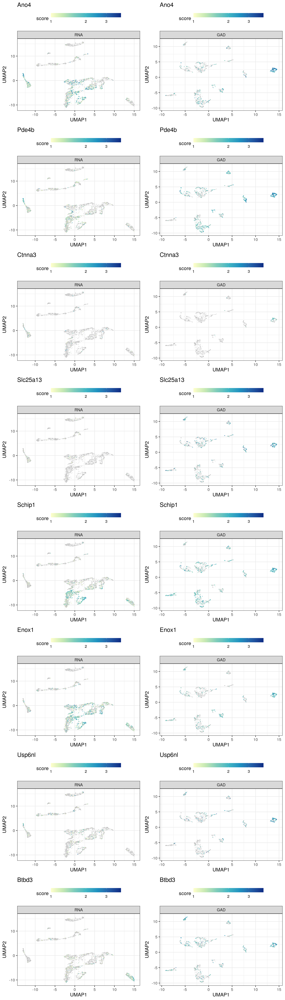

In [84]:
targetCT = "Mature Oligodendrocyte"
rnaD = c()
gadD = c()
RNA_logCount = log(RNA_SeuratObj@assays$RNA@counts + 1)
RNA_logCount[RNA_logCount <= 0] = NA
targetGeneList = c("Ano4", "Pde4b", "Ctnna3", "Slc25a13", "Schip1", "Enox1", "Usp6nl", "Btbd3") #c("Pard3b", "Fat3", "Hivep3", "Ttc28", "Arhgap24", "Spata13", "Sgms1", "Slc4a10", "Pid1", "Nhs", "Dapk1", "Itga9", "Agmo", "Maml3", "Rhobtb1", "Tec", "Elf1", "Man1c1") #c("Syt1", "Tiam1", "Epha6", "Ccdc85a", "Slc2a13", "Cemip", "Myo5b", "Trpc6", "Rasgrf2") #GADonly %>% filter(cellType == targetCT) %>% top_n(20, wt = pVal) %$% gene
options(repr.plot.width=8, repr.plot.height=9*length(targetGeneList))

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
    rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
            cbind(rnaUMAPD, .) %>% dplyr::select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            dplyr::select(X1, X2, cellType, score = gene, type, targetGene)
    
    rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
options(repr.plot.width=16, repr.plot.height=7*length(targetGeneList))

genePlot = vector("list", length(targetGeneList))
for(i in 1:length(targetGeneList)){
    tG = targetGeneList[i] #c("Pard3b", "Spata13", "Entpd1", "Dock8", "Agmo")[i]
   genePlot[[i]] = ggarrange(rnaD %>% dplyr::filter(targetGene == tG, is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rnaD %>% dplyr::filter(targetGene == tG, !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.5) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 4) )+
    facet_wrap(~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    ggtitle(tG) +
    theme(legend.position = "top", legend.key.width = unit(2, "cm")), 
    gadD %>% dplyr::filter(targetGene == tG, is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = gadD %>% dplyr::filter(targetGene == tG, !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.5) +
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5, 8, 20, 50), limits = c(1, 4)) +
    facet_wrap(~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    ggtitle(tG) +
    theme(legend.position = "top", legend.key.width = unit(2, "cm")), nrow = 1, ncol = 2)
}
ggarrange(genePlot[[1]], genePlot[[2]], genePlot[[3]], genePlot[[4]], genePlot[[5]], genePlot[[6]], genePlot[[7]], genePlot[[8]], ncol = 1, nrow =length(targetGeneList)) #, genePlot[[19]],genePlot[[20]]

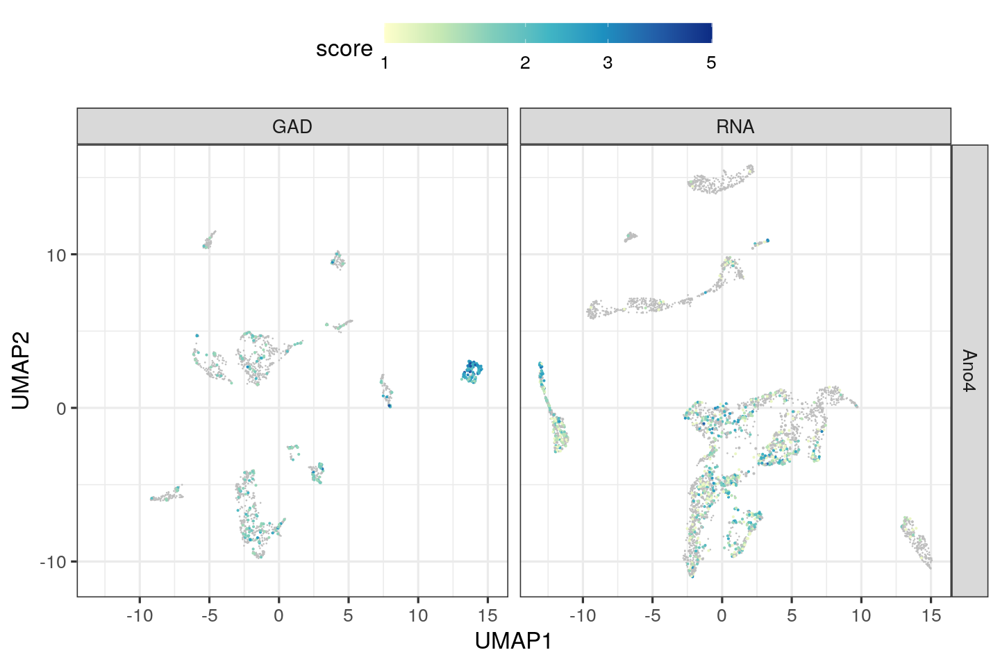

In [85]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneO1 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Ano4"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Ano4"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.5) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 5) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
gadUMAPgeneO1

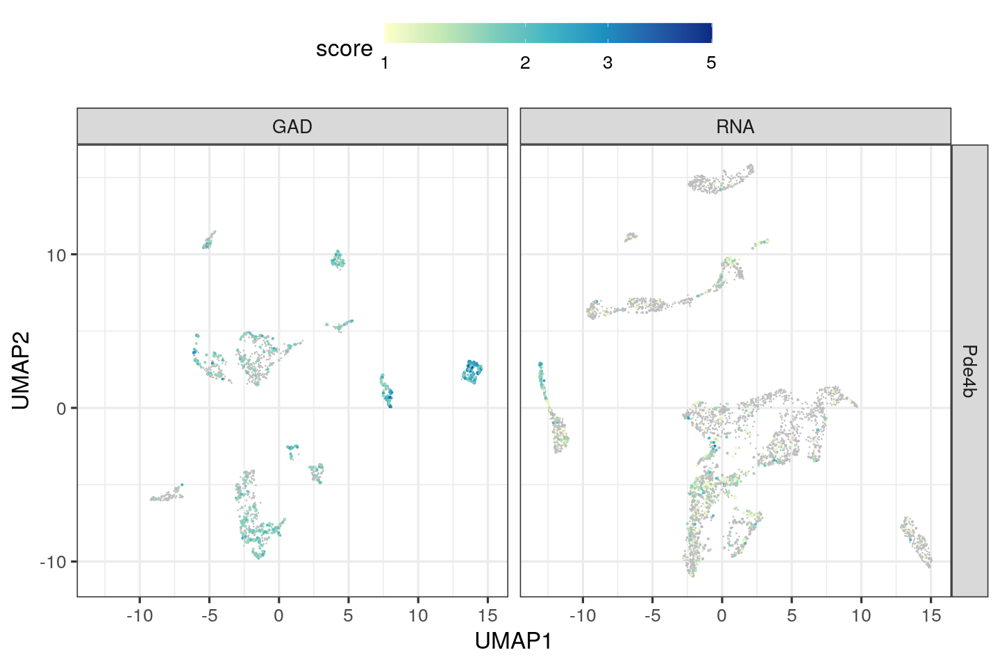

In [86]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneO2 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Pde4b"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Pde4b"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.5) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 5) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
gadUMAPgeneO2

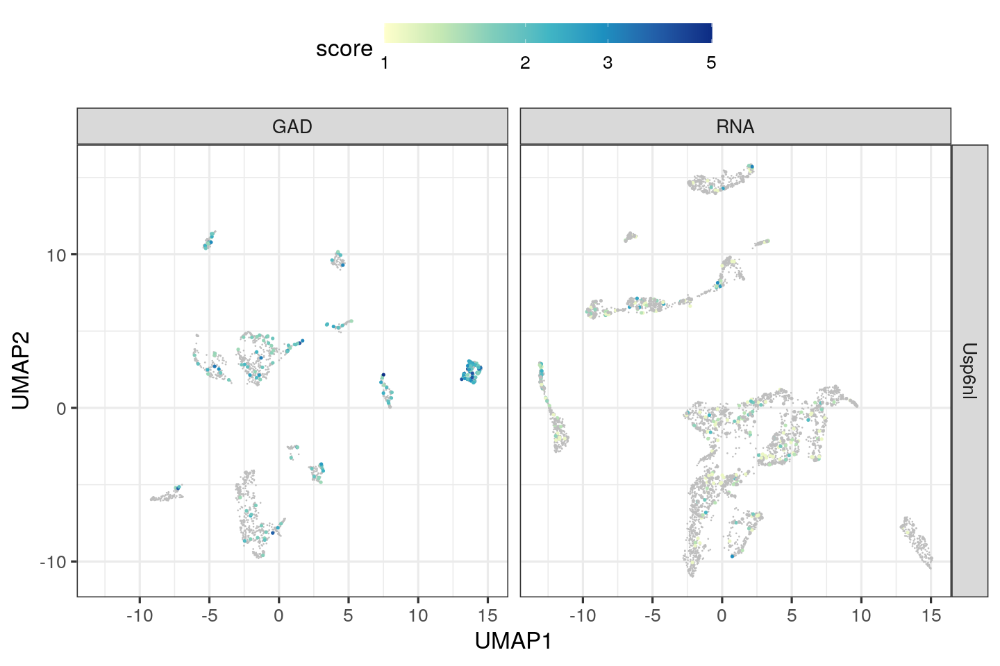

In [87]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneO3 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Usp6nl"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Usp6nl"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.8) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 5) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
gadUMAPgeneO3

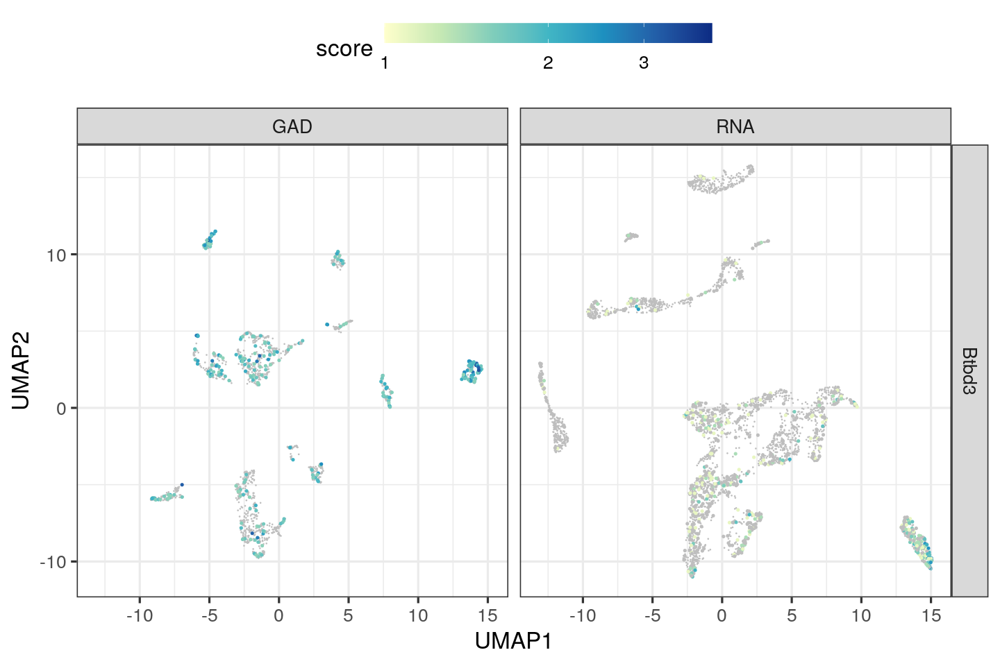

In [448]:
options(repr.plot.width=12, repr.plot.height=8)

gadUMAPgeneO4 = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Btbd3"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Btbd3"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.8) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 4) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))
gadUMAPgeneO4

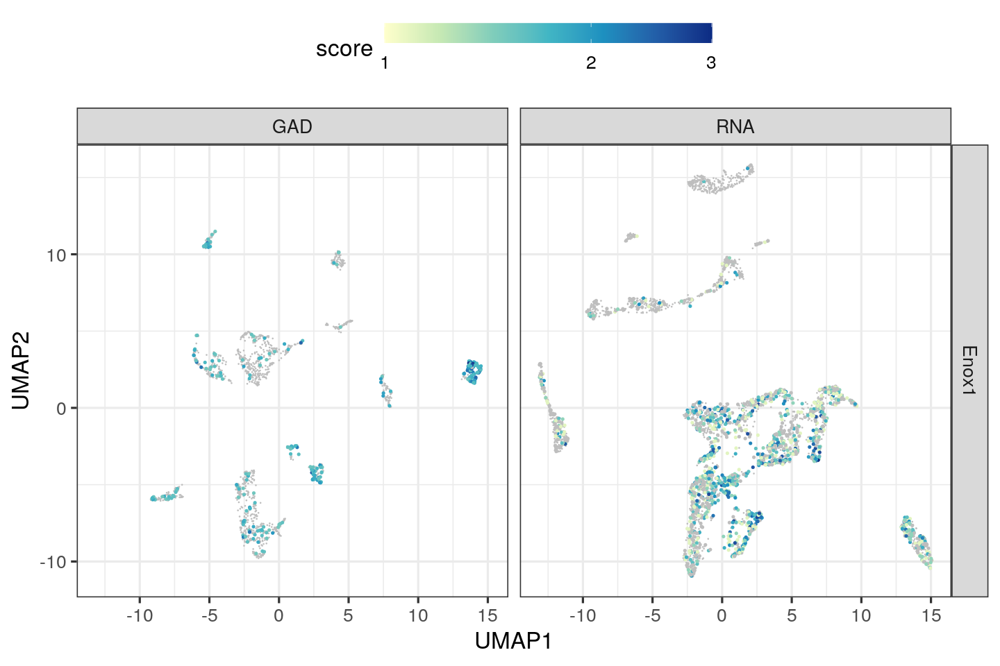

In [433]:
options(repr.plot.width=12, repr.plot.height=8)

rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Enox1"), is.na(score)) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    geom_point(data = rbind(rnaD, gadD) %>% dplyr::filter(targetGene %in% c("Enox1"), !is.na(score)), aes(x = X1, y = X2, color = score), size = 0.8) +                         
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log", breaks = c(0, 1, 2, 3, 5), limits = c(1, 3) )+
    facet_grid(targetGene~type) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    theme(legend.position = "top", legend.key.width = unit(2, "cm"))

png 
  2

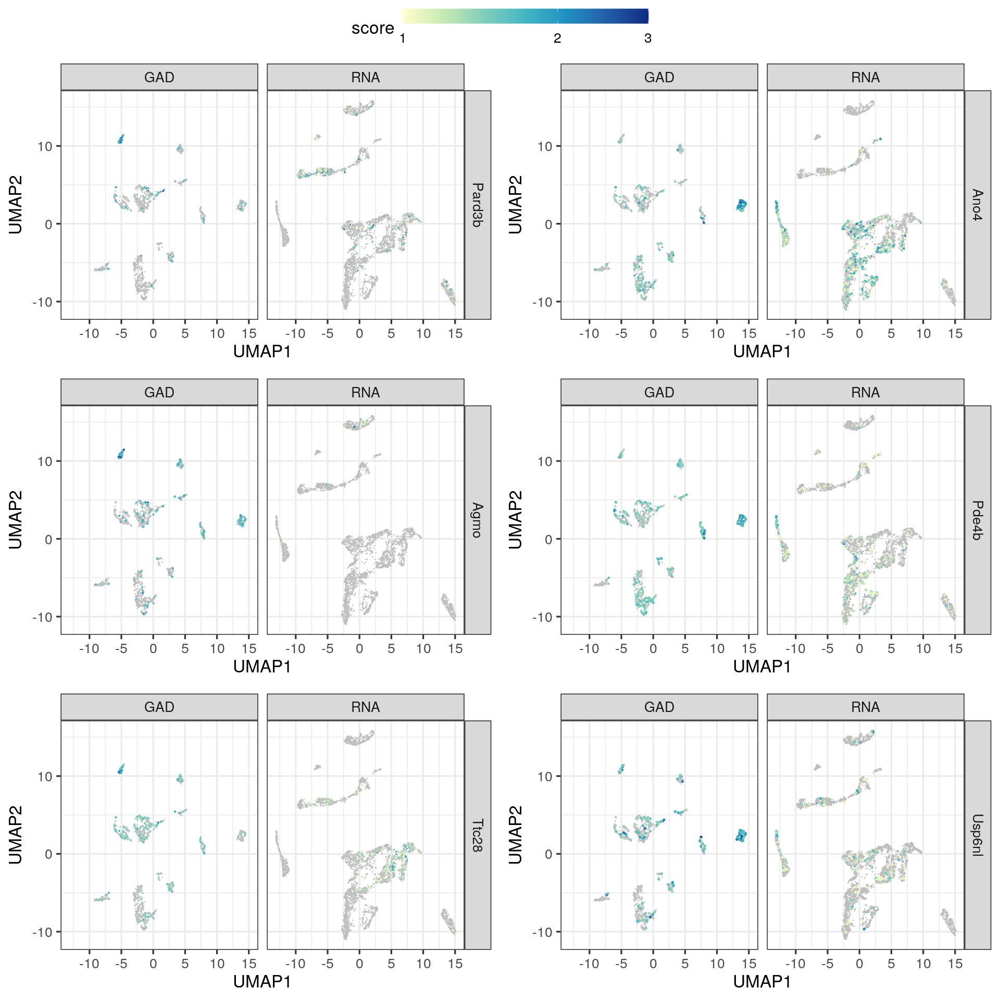

In [453]:
# save(gadUMAPgeneM1, gadUMAPgeneM2, gadUMAPgeneM3, gadUMAPgeneM4, gadUMAPgeneO1, gadUMAPgeneO2, gadUMAPgeneO3, gadUMAPgeneO4, file = "")
options(repr.plot.width=16, repr.plot.height=16)

pdf("/p/keles/schic/volumeA/Figures/gadUMAPgene.pdf", width = 16, height = 15)
ggarrange(gadUMAPgeneM1, gadUMAPgeneO1, gadUMAPgeneM2, gadUMAPgeneO2, gadUMAPgeneM3, gadUMAPgeneO3, ncol = 2, nrow = 3, common.legend = T)
dev.off()
ggarrange(gadUMAPgeneM1, gadUMAPgeneO1, gadUMAPgeneM2, gadUMAPgeneO2, gadUMAPgeneM3, gadUMAPgeneO3, ncol = 2, nrow = 3, common.legend = T)



png 
  2

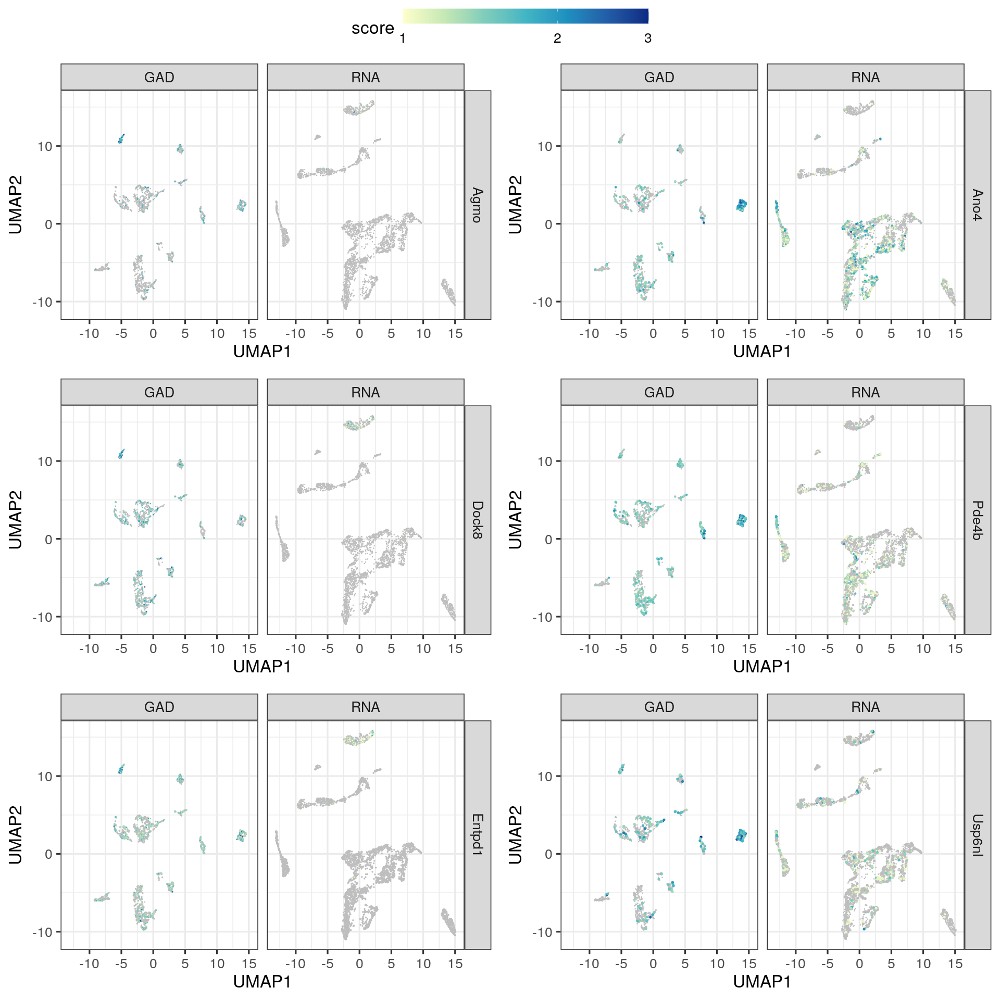

In [97]:
# save(gadUMAPgeneM1, gadUMAPgeneM2, gadUMAPgeneM3, gadUMAPgeneM4, gadUMAPgeneO1, gadUMAPgeneO2, gadUMAPgeneO3, gadUMAPgeneO4, file = "")
options(repr.plot.width=16, repr.plot.height=16)

pdf("/p/keles/schic/volumeA/Figures/gadUMAPgene_version2.pdf", width = 16, height = 15)
ggarrange(gadUMAPgeneM2, gadUMAPgeneO1, gadUMAPgeneM5, gadUMAPgeneO2, gadUMAPgeneM6, gadUMAPgeneO3, ncol = 2, nrow = 3, common.legend = T)
dev.off()
ggarrange(gadUMAPgeneM2, gadUMAPgeneO1, gadUMAPgeneM5, gadUMAPgeneO2, gadUMAPgeneM6, gadUMAPgeneO3, ncol = 2, nrow = 3, common.legend = T)



In [ ]:
Microglia:
Pard3b Fat3 Hivep3 Ttc28 Arhgap24 Spata13 Sgms1 Slc4a10 Pid1 Nhs Dapk1 Itga9 Agmo Maml3 Rhobtb1 Tec Elf1 Man1c1
Oligodendrocyte Progenitor:
Dpp10 Prkcb
Mature Oligodendrocyte:
Ano4 Pde4b Ctnna3 Slc25a13 Schip1 Enox1 Usp6nl Btbd3
Hippocampal Granule Cells:
Syt1 Tiam1 Epha6 Ccdc85a Slc2a13 Cemip Myo5b Trpc6 Rasgrf2
Adult Astrocytes:
Prdm16 Farp1 Rora Csgalnact1 Rorb B3galt1

In [2]:
load("/p/keles/schic/volumeB/Tan2021/potential_gene_list.RData")

In [15]:
head(potential_gene_list_GAD_only)

$Microglia_Etc.
 [1] "Fhit"     "Hivep3"   "Ttc28"    "Nav3"     "Arhgap24" "Pard3b"  
 [7] "Spata13"  "Fat3"     "Sgcz"     "Hdac9"    "Jak1"     "Sgms1"   
[13] "Slc4a10"  "Pid1"     "Ankrd11"  "Intu"     "Nhs"      "Uvrag"   
[19] "Magi1"    "Rap1gds1" "Rarb"     "Wdpcp"    "Pakap"    "Ptk2b"   
[25] "Chchd3"   "Foxp1"    "Dapk1"    "Chn2"     "Spata5"   "Slx4ip"  
[31] "Tbc1d22a" "Dlc1"     "Cadm1"    "Baz2b"    "Rabgap1"  "Shb"     
[37] "Ninj2"    "Mctp2"    "Mthfd1l"  "Adgrl2"   "Taf3"     "Ttll11"  
[43] "Mgat5"    "Gm7247"   "Zfand3"   "Cux1"     "Med12l"   "Rapgef1" 
[49] "Sdccag8"  "Igf1r"    "Kansl1"   "Fbxw7"    "Lrig2"    "Ttn"     
[55] "Mvb12b"   "Myo1d"    "Tcerg1l"  "Cntln"    "Dera"     "Atg4a"   
[61] "Myo18a"   "Col12a1"  "Vps13c"  

$Oligodendrocyte_Progenitor
[1] "Prkcb" "Nek11" "Them7" "Afg1l"

$Neonatal_Astrocyte
[1] "Myo3b"

$Adult_Astrocyte
 [1] "Zbtb20"  "Ablim1"  "B3galt1" "Limch1"  "Alk"     "Stox2"   "L3mbtl4"
 [8] "Pla2r1"  "Ntn1"    "Gm20498"

$Mature_Oligodendrocyte
 [1] "Pcdh15"   "Tcf12"    "Schip1"   "Auts2"    "Enox1"    "App"     
 [7] "Gm11639"  "Usp6nl"   "Prkca"    "Ephb1"    "Cdh10"    "Rabgap1l"
[13] "Fut8"     "Ank3"     "Magi1"    "Rapgef5"  "Ank"      "Osbpl1a" 
[19] "Tmem163"  "Slc22a23" "Gnao1"    "Stard13"  "Gfra1"    "Hipk2"   
[25] "Foxn3"    "Brinp3"   "Shroom3"  "Grik3"    "Pak7"     "Rasal2"  
[31] "Cpeb3"    "Mbnl2"    "Srgap1"   "Itih5"    "Btbd3"    "Agtpbp1" 
[37] "Lrriq3"   "Arap2"    "Eif4g3"   "Tshr"    

$Hippocampal_Granule_Cell
[1] "Syt1"

In [6]:
#Preparing for hic result
load("/p/keles/schic/volumeB/Tan2021/detected_markergenes_control.RData")

paths = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control/", full.names = TRUE)
names = list.files("/p/keles/schic/volumeB/Tan2021/gad_scores_control/")
temp = fread(paths[1])
temp$V1[duplicated(temp$V1)] = 'Pcdha11_d'
all = matrix(0, nrow = nrow(temp), ncol = length(paths))
for (k in 1:length(names)){
    cell = fread(paths[k])
    all[, k] = cell$V2
}
rownames(all) = temp$V1
colnames(all) = names
all[is.na(all)] = 0
all[is.infinite(all)] = 0
all = t(all)
#all[all < 1.2] = NA

rnaD = c()
gadD = c()
RNA_logCount = log(RNA_SeuratObj@assays$RNA@counts + 1)
RNA_logCount[RNA_logCount <= 0] = NA
targetGeneList = c("Pard3b", "Entpd1", "Dock8", "Fat3", "Hivep3", "Ttc28", "Arhgap24", "Spata13", "Sgms1", "Slc4a10", "Pid1", "Nhs", "Dapk1", "Itga9", "Agmo", "Maml3", "Rhobtb1", "Tec", "Elf1", "Man1c1")
for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
    rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
            cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType = celltype, score = gene, type, targetGene)
    
    rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}

In [65]:
head(rnaD)

,X1,X2,cellType,score,type,targetGene
,<dbl>,<dbl>,<chr>,<dbl>,<chr>,<chr>
PR10_HCA_P14HM-1_01,1.5274046,-7.780704,Hippocampal_Pyramid_Cells,NA,RNA,Pard3b
PR10_HCA_P14HM-1_02,1.2319564,2.569815,Hippocampal_Granule_Cells,NA,RNA,Pard3b
PR10_HCA_P14HM-1_03,4.2908398,-5.606019,Cortical_L2-5_Pyramidal_Cell,NA,RNA,Pard3b
PR10_HCA_P14HM-1_04,0.4101792,1.817659,Hippocampal_Granule_Cells,NA,RNA,Pard3b
PR10_HCA_P14HM-1_07,4.4139985,-6.179329,Cortical_L2-5_Pyramidal_Cell,NA,RNA,Pard3b
PR10_HCA_P14HM-1_08,4.1701001,-5.674010,Cortical_L2-5_Pyramidal_Cell,NA,RNA,Pard3b


In [99]:
options(repr.plot.width=8, repr.plot.height=180)

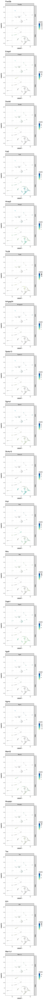

In [101]:
targetGeneList = c("Pard3b", "Entpd1", "Dock8", "Fat3", "Hivep3", "Ttc28", "Arhgap24", "Spata13", "Sgms1", "Slc4a10", "Pid1", "Nhs", "Dapk1", "Itga9", "Agmo", "Maml3", "Rhobtb1", "Tec", "Elf1", "Man1c1")
for(i in 1:length(targetGeneList)){
    tG = targetGeneList[i] #c("Pard3b", "Spata13", "Entpd1", "Dock8", "Agmo")[i]
   genePlot[[i]] = rbind(rnaD, gadD) %>% filter(targetGene == tG) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log1p") +
    facet_grid(type~targetGene) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    ggtitle(tG)
}
ggarrange(genePlot[[1]], genePlot[[2]], genePlot[[3]], genePlot[[4]], genePlot[[5]], genePlot[[6]], genePlot[[7]], genePlot[[8]], genePlot[[9]],
          genePlot[[10]], genePlot[[11]], genePlot[[12]], genePlot[[13]], genePlot[[14]], genePlot[[15]], genePlot[[16]], genePlot[[17]], genePlot[[18]], genePlot[[19]],genePlot[[20]], ncol = 1, nrow =20)

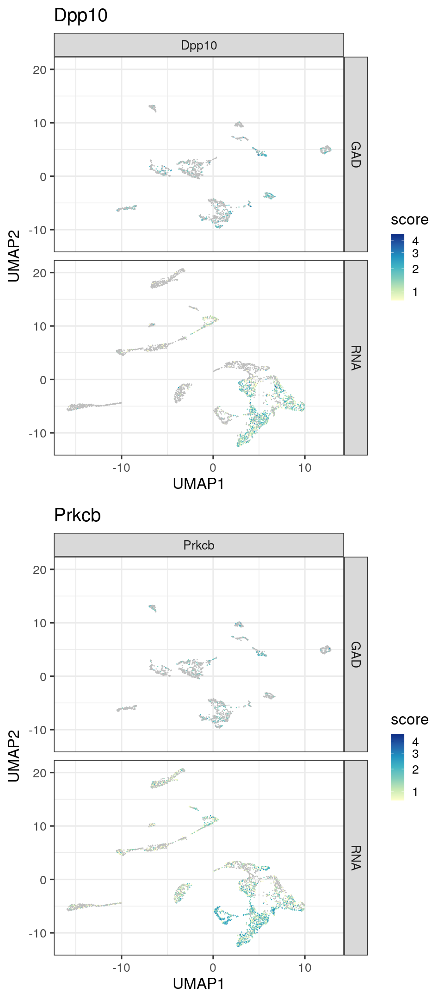

In [102]:
rnaD = c()
gadD = c()
RNA_logCount = log(RNA_SeuratObj@assays$RNA@counts + 1)
RNA_logCount[RNA_logCount <= 0] = NA
targetGeneList = c("Dpp10", "Prkcb")
options(repr.plot.width=8, repr.plot.height=9*length(targetGeneList))

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
    rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
            cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType = celltype, score = gene, type, targetGene)
    
    rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
for(i in 1:length(targetGeneList)){
    tG = targetGeneList[i] #c("Pard3b", "Spata13", "Entpd1", "Dock8", "Agmo")[i]
   genePlot[[i]] = rbind(rnaD, gadD) %>% filter(targetGene == tG) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log1p") +
    facet_grid(type~targetGene) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    ggtitle(tG)
}
ggarrange(genePlot[[1]], genePlot[[2]], ncol = 1, nrow =2)

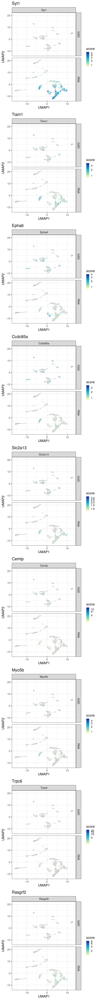

In [103]:
rnaD = c()
gadD = c()
RNA_logCount = log(RNA_SeuratObj@assays$RNA@counts + 1)
RNA_logCount[RNA_logCount <= 0] = NA
targetGeneList = c("Syt1", "Tiam1", "Epha6", "Ccdc85a", "Slc2a13", "Cemip", "Myo5b", "Trpc6", "Rasgrf2")
options(repr.plot.width=8, repr.plot.height=9*length(targetGeneList))

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
    rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
            cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType = celltype, score = gene, type, targetGene)
    
    rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
for(i in 1:length(targetGeneList)){
    tG = targetGeneList[i] #c("Pard3b", "Spata13", "Entpd1", "Dock8", "Agmo")[i]
   genePlot[[i]] = rbind(rnaD, gadD) %>% filter(targetGene == tG) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log1p") +
    facet_grid(type~targetGene) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    ggtitle(tG)
}
ggarrange(genePlot[[1]], genePlot[[2]], genePlot[[3]], genePlot[[4]], genePlot[[5]], genePlot[[6]], genePlot[[7]], genePlot[[8]], genePlot[[9]], ncol = 1, nrow =9)

In [10]:
rnaD = c()
gadD = c()
RNA_logCount = log(RNA_SeuratObj@assays$RNA@counts + 1)
RNA_logCount[RNA_logCount <= 0] = NA
targetGeneList = c("Ano4", "Pde4b", "Ctnna3", "Slc25a13", "Schip1", "Enox1", "Usp6nl", "Btbd3")
options(repr.plot.width=8, repr.plot.height=9*length(targetGeneList))

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
    rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
            cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType = celltype, score = gene, type, targetGene)
    
    rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
for(i in 1:length(targetGeneList)){
    tG = targetGeneList[i] #c("Pard3b", "Spata13", "Entpd1", "Dock8", "Agmo")[i]
   genePlot[[i]] = rbind(rnaD, gadD) %>% filter(targetGene == tG) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log1p") +
    facet_grid(type~targetGene) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    ggtitle(tG)
}
ggarrange(genePlot[[1]], genePlot[[2]], genePlot[[3]], genePlot[[4]], genePlot[[5]], genePlot[[6]], genePlot[[7]], genePlot[[8]], ncol = 1, nrow =length(targetGeneList))

ERROR: Error in eval(expr, envir, enclos): object 'RNA_SeuratObj' not found


In [26]:
load("/p/keles/schic/volumeB/Tan2021/Tan2021_results.RData")

cellTypeNameList
gene_lists[[cellTypeNameList[1]]]
gene_lists[[cellTypeNameList[2]]]

[1] "Neonatal_Neuron_1"            "Neonatal_Neuron_2"           
 [3] "Medium_Spiny_Neuron"          "Interneuron"                 
 [5] "Hippocampal_Granule_Cell"     "Hippocampal_Pyramidal_Cell"  
 [7] "Cortical_L2-5_Pyramidal_Cell" "Cortical_L6_Pyramidal_Cell"  
 [9] "Neonatal_Astrocyte"           "Adult_Astrocyte"             
[11] "Oligodendrocyte_Progenitor"   "Mature_Oligodendrocyte"      
[13] "Microglia_Etc."

[1] "Dpysl3"   "Chl1"     "Akap9"    "Ncam1"    "Mapt"     "Ankrd12" 
 [7] "Srgap1"   "Tmem131l" "Ptprz1"   "Neo1"     "Plppr1"   "Frmd4a"  
[13] "Dner"     "Runx1t1"  "Pbx1"     "Nckap5"   "Zfp462"   "Tiam2"   
[19] "Fbn2"     "Nfib"     "Ptprk"    "Nrp1"

[1] "Dpysl3"   "Chl1"     "Akap9"    "Ncam1"    "Mapt"     "Ankrd12" 
 [7] "Srgap1"   "Tmem131l" "Ptprz1"   "Neo1"     "Plppr1"   "Frmd4a"  
[13] "Dner"     "Runx1t1"  "Pbx1"     "Nckap5"   "Zfp462"   "Tiam2"   
[19] "Fbn2"     "Nfib"     "Ptprk"    "Nrp1"

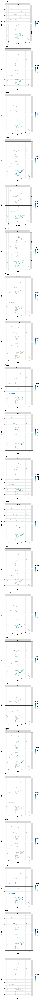

In [23]:
rnaD = c()
gadD = c()
RNA_logCount = log(RNA_SeuratObj@assays$RNA@counts + 1)
RNA_logCount[RNA_logCount <= 0] = NA
targetGeneList = gene_lists[[cellTypeNameList[1]]]
options(repr.plot.width=8, repr.plot.height=9*length(targetGeneList))
genePlot = vector("list", length(targetGeneList))
for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
    rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
            cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType = celltype, score = gene, type, targetGene)
    
    rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
for(i in 1:length(targetGeneList)){
    tG = targetGeneList[i] #c("Pard3b", "Spata13", "Entpd1", "Dock8", "Agmo")[i]
   genePlot[[i]] = rbind(rnaD, gadD) %>% filter(targetGene == tG) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log1p") +
    facet_grid(type~targetGene) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    ggtitle(tG)
}
ggarrange(genePlot[[1]], genePlot[[2]], genePlot[[3]], genePlot[[4]], genePlot[[5]], genePlot[[6]], genePlot[[7]], genePlot[[8]], genePlot[[9]],
          genePlot[[10]], genePlot[[11]], genePlot[[12]], genePlot[[13]], genePlot[[14]], genePlot[[15]], genePlot[[16]], genePlot[[17]], genePlot[[18]], genePlot[[19]],genePlot[[20]], 
          genePlot[[21]], genePlot[[22]], ncol = 1, nrow =length(targetGeneList))

In [ ]:
rnaD = c()
gadD = c()
RNA_logCount = log(RNA_SeuratObj@assays$RNA@counts + 1)
RNA_logCount[RNA_logCount <= 0] = NA
targetGeneList = gene_lists[[cellTypeNameList[2]]]
options(repr.plot.width=8, repr.plot.height=9*length(targetGeneList))
genePlot = vector("list", length(targetGeneList))

for(targetGene in targetGeneList){ 
    ind = which(rownames(RNA_SeuratObj@assays$RNA@counts) == targetGene)
    rna = data.frame(names = colnames(RNA_SeuratObj@assays$RNA@counts), gene = RNA_logCount[ind, ] %>% as.vector, type = "RNA", targetGene = targetGene) %>% 
            cbind(rnaUMAPD, .) %>% select(X1, X2, cellType, score = gene, type, targetGene)
    gad = data.frame(names = rownames(all), gene = all[, colnames(all) == targetGene], type = "GAD", targetGene = targetGene) %>% cbind(umapD, .) %>% 
            select(X1, X2, cellType = celltype, score = gene, type, targetGene)
    
    rnaD = rbind(rnaD, rna)
    gadD = rbind(gadD, gad)

    
}
for(i in 1:length(targetGeneList)){
    tG = targetGeneList[i] #c("Pard3b", "Spata13", "Entpd1", "Dock8", "Agmo")[i]
   genePlot[[i]] = rbind(rnaD, gadD) %>% filter(targetGene == tG) %>% ggplot(aes(x = X1, y = X2, color = score)) +
    geom_point(size = 0.1) +
    scale_color_distiller(palette = "YlGnBu", direction = 1, na.value = "grey", trans = "log1p") +
    facet_grid(type~targetGene) +
    theme_bw(base_size = 20) +
    xlab("UMAP1") +
    ylab("UMAP2") +
    ggtitle(tG)
}
ggarrange(genePlot[[1]], genePlot[[2]], genePlot[[3]], genePlot[[4]], genePlot[[5]], genePlot[[6]], genePlot[[7]], genePlot[[8]], genePlot[[9]],
          genePlot[[10]], genePlot[[11]], genePlot[[12]], genePlot[[13]], genePlot[[14]], genePlot[[15]], genePlot[[16]], genePlot[[17]], genePlot[[18]], genePlot[[19]],genePlot[[20]], 
          genePlot[[21]], genePlot[[22]], ncol = 1, nrow =length(targetGeneList))

In [ ]:
options(repr.plot.width=25, repr.plot.height=10)
cell_types = names(potential_gene_list_GAD_only)

for (i in 1:length(cell_types)){
    temp_genes = potential_gene_list_GAD_only[[i]]
    pdf(paste("/p/keles/schic/volumeB/Tan2021/potential_genes/GAD_only_", cell_types[i], ".pdf", sep = ""), width=20, height=10)
    for (j in 1:length(temp_genes)){
        rna = data.frame(names = colnames(RNA_SeuratObj), gene = RNA_SeuratObj[rownames(RNA_SeuratObj) == temp_genes[j], ], type = "RNA")
        gad = data.frame(names = rownames(all), gene = all[, colnames(all) == temp_genes[j]], type = "GAD")
        rna = cbind(embedding_rna, rna)
        gad = cbind(embedding_gad, gad)
        colnames(rna) = c("UMAP1", "UMAP2", "cell_name", "info", "type")
        colnames(gad) = c("UMAP1", "UMAP2", "cell_name", "info", "type")
        output = rbind(rna, gad)
        print(ggplot(output, aes(x = UMAP1, y = UMAP2)) + facet_grid(. ~ type) + geom_point(aes(color = info), size = 0.6) + scale_colour_gradient(low = "red", high = "blue", na.value = "gray") + 
        theme_bw(base_size = 16) + labs(color = temp_genes[j]))
    }
    dev.off()
}

for (i in 1:length(cell_types)){
    temp_genes = potential_gene_list_GAD_RNA[[i]]
    pdf(paste("/p/keles/schic/volumeB/Tan2021/potential_genes/GAD_RNA_", cell_types[i], ".pdf", sep = ""), width=20, height=10)
    for (j in 1:length(temp_genes)){
        rna = data.frame(names = colnames(RNA_SeuratObj), gene = RNA_SeuratObj[rownames(RNA_SeuratObj) == temp_genes[j], ], type = "RNA")
        gad = data.frame(names = rownames(all), gene = all[, colnames(all) == temp_genes[j]], type = "GAD")
        rna = cbind(embedding_rna, rna)
        gad = cbind(embedding_gad, gad)
        colnames(rna) = c("UMAP1", "UMAP2", "cell_name", "info", "type")
        colnames(gad) = c("UMAP1", "UMAP2", "cell_name", "info", "type")
        output = rbind(rna, gad)
        print(ggplot(output, aes(x = UMAP1, y = UMAP2)) + facet_grid(. ~ type) + geom_point(aes(color = info), size = 0.6) + scale_colour_gradient(low = "red", high = "blue", na.value = "gray") + 
        theme_bw(base_size = 16) + labs(color = temp_genes[j]))
    }
    dev.off()
}

In [34]:
#Showing go result for only significant genes.

GO_results

,category,over_represented_pvalue,under_represented_pvalue,numDEInCat,numInCat,term,ontology
,<chr>,<dbl>,<dbl>,<int>,<int>,<chr>,<chr>
4047,GO:0030278,4.523435e-05,0.9999977,5,44,regulation of ossification,BP
2794,GO:0010954,2.664688e-04,0.9999992,2,3,positive regulation of protein processing,BP
11220,GO:1903319,2.664688e-04,0.9999992,2,3,positive regulation of protein maturation,BP
4048,GO:0030279,2.694679e-04,0.9999937,3,14,negative regulation of ossification,BP
2030,GO:0007569,4.031850e-04,0.9999890,3,16,cell aging,BP
226,GO:0001503,5.113677e-04,0.9999554,5,73,ossification,BP
6742,GO:0045667,1.746220e-03,0.9999156,3,26,regulation of osteoblast differentiation,BP
2041,GO:0007601,1.760217e-03,0.9999147,3,26,visual perception,BP
243,GO:0001541,1.765461e-03,0.9999743,2,7,ovarian follicle development,BP


Oligodendrocyte Progenitor is related to chondroitin sulfate. (https://en.wikipedia.org/wiki/Oligodendrocyte_progenitor_cell)

Microglia is related to immune system.

Hippocampal pyramidal: (https://www.ncbi.nlm.nih.gov/pmc/articles/PMC2269937/#:~:text=Potassium%20channels%20located%20in%20the,postsynaptic%20potentials%20and%20dendritic%20excitability.)

Cortical_L2-5_Pyramidal_Cell: The first GO term is "central nervous system neuron differentiation"

Mature_Oligodendrocyte: Golgi in the GO terms is a sensory neuron. It is also related to potassium mentioned in the GO. (https://elifesciences.org/articles/34829)

Adult_Astrocyte: one of the functino of Astrocytes is "regulation of cerebral blood flow" and it is mentioned in the GO (celebellar). Also, all the GO terms in this are related to neuron cells.

Interneuron: potassium channel shows up, but didn't spot other factors.

Medium_Spiny_Neuron:contains small rounded vesicles. (https://www.sciencedirect.com/topics/neuroscience/medium-spiny-neuron)

Hippocampal_Granule_Cell: "Calcium dynamics are essential for several functions of granule cells such as changing membrane potential, synaptic plasticity, apoptosis, and regulation of gene transcription." (https://en.wikipedia.org/wiki/Granule_cell#:~:text=Granule%20cells%20are%20found%20within,bulb%2C%20and%20the%20cerebral%20cortex.&text=These%20granule%20cells%20receive%20excitatory,fibers%20originating%20from%20pontine%20nuclei.)